# Financial Signal Processing Coursework 2023

## Imports

In [1]:
!pip install fastdtw dtw

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 KB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for fastdtw: filename=fastdtw-0.3.4-cp39-cp39-linux_x86_64.whl size=534330 sha256=de22f3e0f5d1dedcb9bb3930c9b8d1b4b59616acf5baab81d5cfda6cc40e439d
  Stored in directory: /root/.cache/pip/wheels/1f/a1/63/bfd0fddb5bf0b59f564872e29272cee8a2de0cd745d88fede5
  Created wheel for dtw: filename=dtw-1.4.0-py3-none-any.whl size=5313 sha256=cbc7f0a5f7830b8f5118794531dfc69af2b9b41dfd4bc725fad6e435294e1224
  Stored in directory: /root/.cache/pip/wheels/b4/fe/94/72ad3df3a67605236d3fac0891a64eef2eeedad1a1e0639076
Successfully built fastdtw dtw


In [2]:
# Imports
import time
import numpy as np # s c i e n t i f i c l i b r a r y
import pandas as pd # data s t r u c t u r e l i b r a r y
import matplotlib.pyplot as plt # p l o t t i n g l i b r a r y
from scipy import stats
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.ar_model import AR
from statsmodels.tsa.api import VAR
import copy
from scipy.stats import pearsonr, iqr
from sklearn.decomposition import PCA
from statistics import median
from sklearn import linear_model
import seaborn as sns
from pandas.plotting import table
from sklearn.metrics import r2_score
import networkx as nx
from dtw import dtw,accelerated_dtw
from fastdtw import fastdtw
import math
from statsmodels.graphics import tsaplots
from statsmodels.graphics.tsaplots import plot_acf
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

plt.rcParams['figure.figsize'] = [16, 9]

# mount drive
from google.colab import drive
drive.mount('/content/drive')

np.random.seed(42)

Mounted at /content/drive


In [3]:
sns.set_style('darkgrid') # darkgrid, white grid, dark, white and ticks
plt.rc('axes', titlesize=22)     # fontsize of the axes title
plt.rc('axes', labelsize=20)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=18)    # fontsize of the tick labels
plt.rc('ytick', labelsize=18)    # fontsize of the tick labels
plt.rc('legend', fontsize=15)    # legend fontsize
plt.rc('font', size=18)          # controls default text sizes

## Global Variables

In [4]:
# Global Variables

PRICEDATA_PATH = "/content/drive/MyDrive/FSP_CWK_2023/priceData.csv"
SNP_500_2015_2019_PATH = "/content/drive/MyDrive/FSP_CWK_2023/snp_500_2015_2019.csv"
SNP_ALLSTOCKS_2015_2019_PATH = "/content/drive/MyDrive/FSP_CWK_2023/snp_allstocks_2015_2019.csv"
SNP_INFO_PATH = "/content/drive/MyDrive/FSP_CWK_2023/snp_info.csv"
FSP_CASE_31_BSD_PATH = "/content/drive/MyDrive/FSP_CWK_2023/fsp_case_31_BSD.csv"
APPLE_PATH = "/content/drive/MyDrive/FSP_CWK_2023/AAPL.csv"
JPM_PATH = "/content/drive/MyDrive/FSP_CWK_2023/JPM.csv"
DJI_PATH = "/content/drive/MyDrive/FSP_CWK_2023/DJI.csv"
IBM_PATH = "/content/drive/MyDrive/FSP_CWK_2023/IBM.csv"

FIGURES_PATH = "/content/drive/MyDrive/FSP_CWK_2023/figures/"

## Section 1: Regression Methods

### 1.1 Processing stock price data in Python

### 1.1.1

0        3.053057
1        3.055415
2        3.068053
3        3.059176
4        3.058237
           ...   
22624    7.796658
22625    7.796942
22626    7.805255
22627    7.798535
22628    7.797439
Name: SPX Index, Length: 21974, dtype: float64


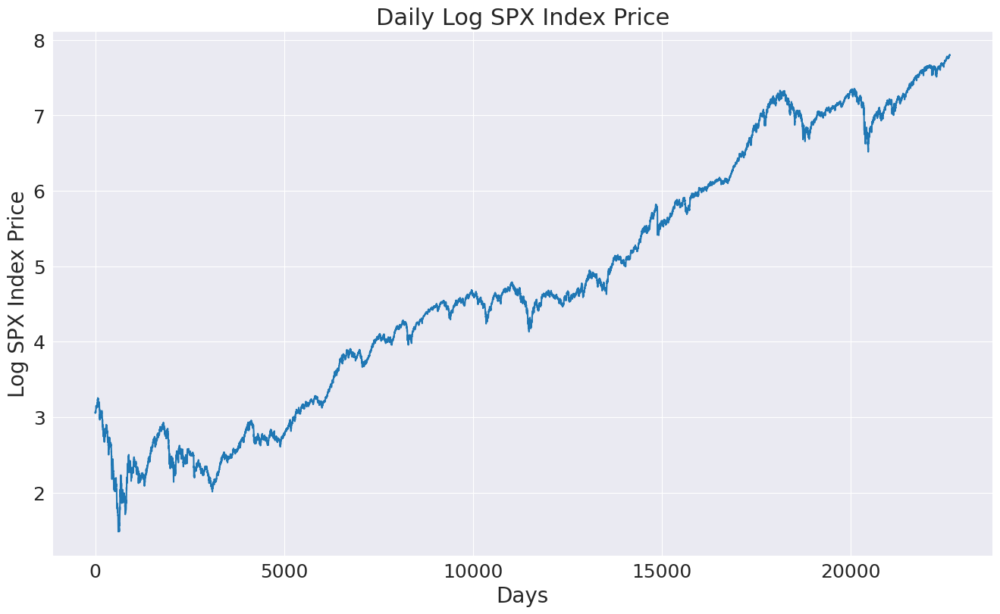

In [5]:
px = pd.read_csv(PRICEDATA_PATH)
px = px.dropna()
logpx = np.log(px['SPX Index'])
print(logpx)

logpx.plot()
plt.xlabel('Days')
plt.ylabel('Log SPX Index Price')
plt.title('Daily Log SPX Index Price')

plt.savefig(FIGURES_PATH+'log_spx_idx.svg')
plt.show()

### 1.1.2

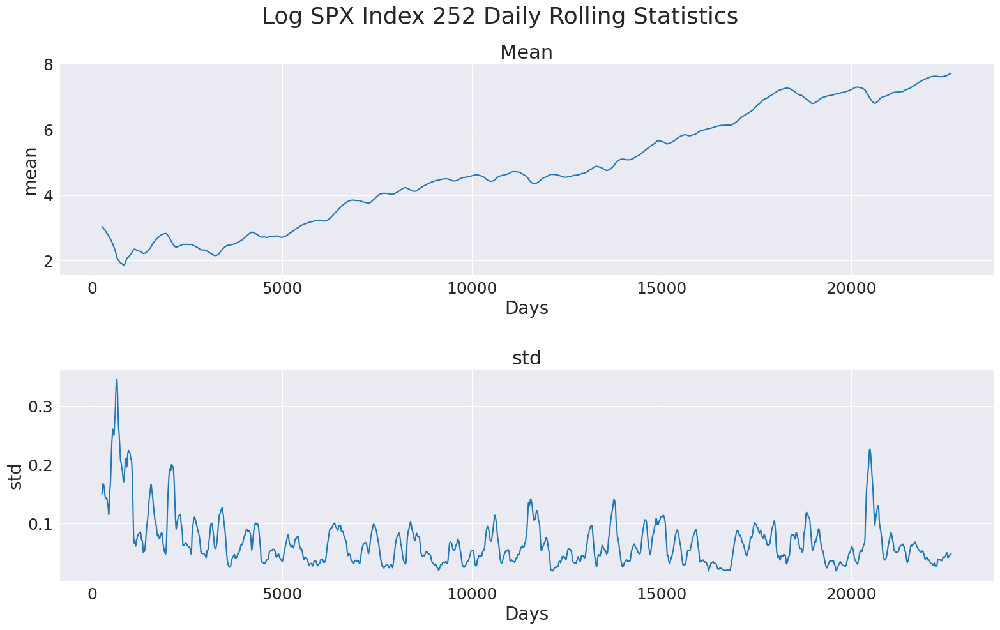

In [6]:
# sliding stats
fig = plt.figure()
st = fig.suptitle("Log SPX Index 252 Daily Rolling Statistics", fontsize="x-large")

ax1 = fig.add_subplot(211)
logpx.rolling(252).mean().dropna().plot()
ax1.set_title("Mean")
ax1.set_xlabel('Days')
ax1.set_ylabel('mean')

ax2 = fig.add_subplot(212)
logpx.rolling(252).std().dropna().plot()
ax2.set_title("std")
ax2.set_xlabel('Days')
ax2.set_ylabel('std')
fig.tight_layout()

# shift subplots down:
st.set_y(1)
fig.subplots_adjust(top=0.9, bottom=0)

fig.savefig(FIGURES_PATH+'log_spx_stats.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

The series is not stationary.

For stationarity, the mean and variance of the series should be independent of time, however there is a clear upward trend in mean and downward trend in std.

### 1.1.3

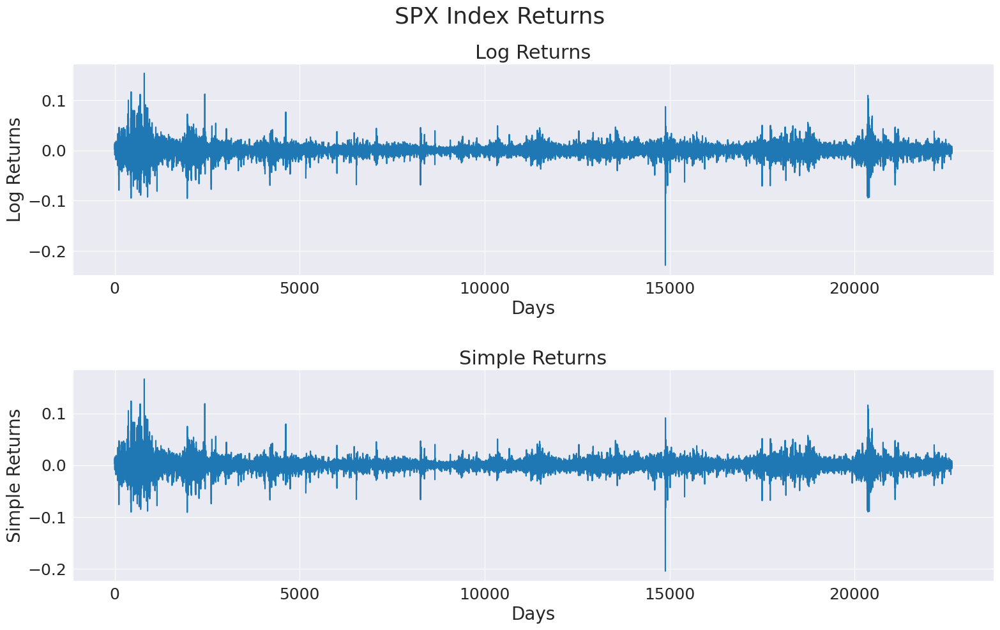

In [7]:
# returns

fig = plt.figure()
st = fig.suptitle("SPX Index Returns", fontsize="x-large")

ax1 = fig.add_subplot(211)
logret = logpx.diff().dropna()
logret.plot()
ax1.set_title("Log Returns")
ax1.set_xlabel('Days')
ax1.set_ylabel('Log Returns')

ax2 = fig.add_subplot(212)
simpret = px['SPX Index'].pct_change().dropna()
simpret.plot()
ax2.set_title("Simple Returns")
ax2.set_xlabel('Days')
ax2.set_ylabel('Simple Returns')
fig.tight_layout()

# shift subplots down:
st.set_y(1)
fig.subplots_adjust(top=0.9, bottom=0)

fig.savefig(FIGURES_PATH+'spx_index_returns.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

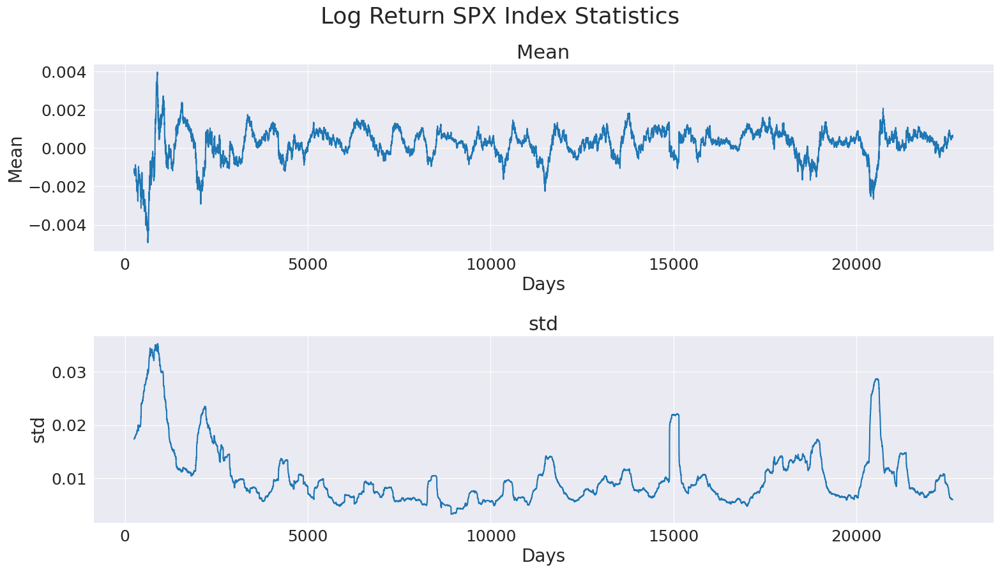

In [8]:
# Log return statistics
# returns

# sliding stats
fig = plt.figure()
st = fig.suptitle("Log Return SPX Index Statistics", fontsize="x-large")

ax1 = fig.add_subplot(211)
logret.rolling(252).mean().dropna().plot()
ax1.set_title("Mean")
ax1.set_xlabel('Days')
ax1.set_ylabel('Mean')

ax2 = fig.add_subplot(212)
logret.rolling(252).std().dropna().plot()
ax2.set_title("std")
ax2.set_xlabel('Days')
ax2.set_ylabel('std')
fig.tight_layout()

# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)

fig.savefig(FIGURES_PATH+'logret_spx_stats.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

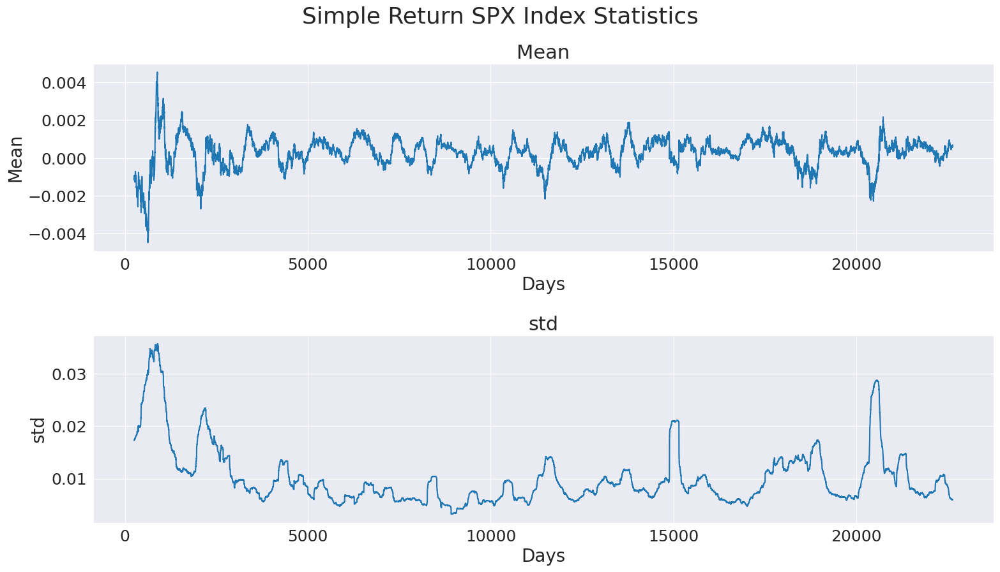

In [9]:
# Simple return statistics

# sliding stats
fig = plt.figure()
st = fig.suptitle("Simple Return SPX Index Statistics", fontsize="x-large")

ax1 = fig.add_subplot(211)
simpret.rolling(252).mean().dropna().plot()
ax1.set_title("Mean")
ax1.set_xlabel('Days')
ax1.set_ylabel('Mean')

ax2 = fig.add_subplot(212)
simpret.rolling(252).std().dropna().plot()
ax2.set_title("std")
ax2.set_xlabel('Days')
ax2.set_ylabel('std')
fig.tight_layout()

# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)
fig.show()

fig.savefig(FIGURES_PATH+'simpret_spx_stats.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

### 1.1.4

In [10]:
# return the Jarque−Bera test p−value for a time−series x
print(stats.jarque_bera(logret))
print(stats.jarque_bera(simpret))

SignificanceResult(statistic=309277.64126696065, pvalue=0.0)
SignificanceResult(statistic=257540.0649368358, pvalue=0.0)


### 1.1.5

Log returns: r[t] = log($\frac{p[t]}{p[t-1]}$) + log($\frac{p[t-1]}{p[t-2]}$) = log($\frac{1}{2}$) + log($\frac{2}{1}$) = 0

Simple returns: R[t] = $\frac{p[t]-p[t-1]}{p[t-1]} + \frac{p[t-1]-p[t-2]}{p[t-2]} = \frac{1-2}{2} + \frac{2-1}{1} = 0.5 $

Therefore, log returns have time additivity whereas simple returns do not.

### 1.1.6

Log returns should not be used when:
- Using long time scales. This is due to the log-normality assumption often being violated
- Addition along assets as log returns are no longer time additive, whereas simple returns are.

### 1.2: ARMA vs. ARIMA Models for Financial Applications


### 1.2.1

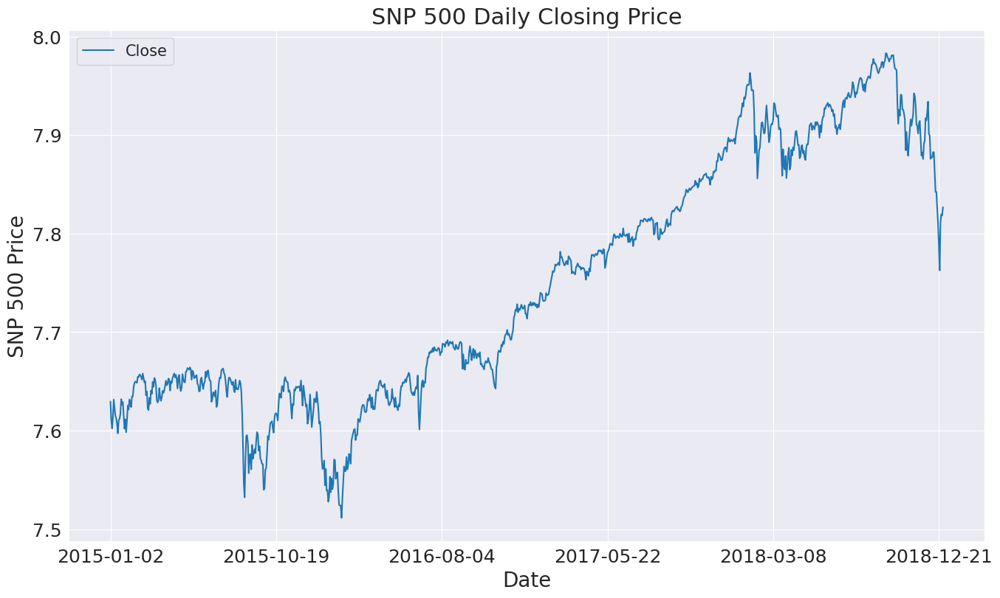

In [11]:
snp = pd.read_csv(SNP_500_2015_2019_PATH)
snp = snp.dropna(how='any')
snp.set_index(["Date"], inplace=True)

snp_close = snp["Close"].to_frame().apply(np.log)
snp_close.plot()
plt.xlabel('Date')
plt.ylabel('SNP 500 Price')
plt.title('SNP 500 Daily Closing Price')

plt.savefig(FIGURES_PATH+'snp_500_price.svg')
plt.show()

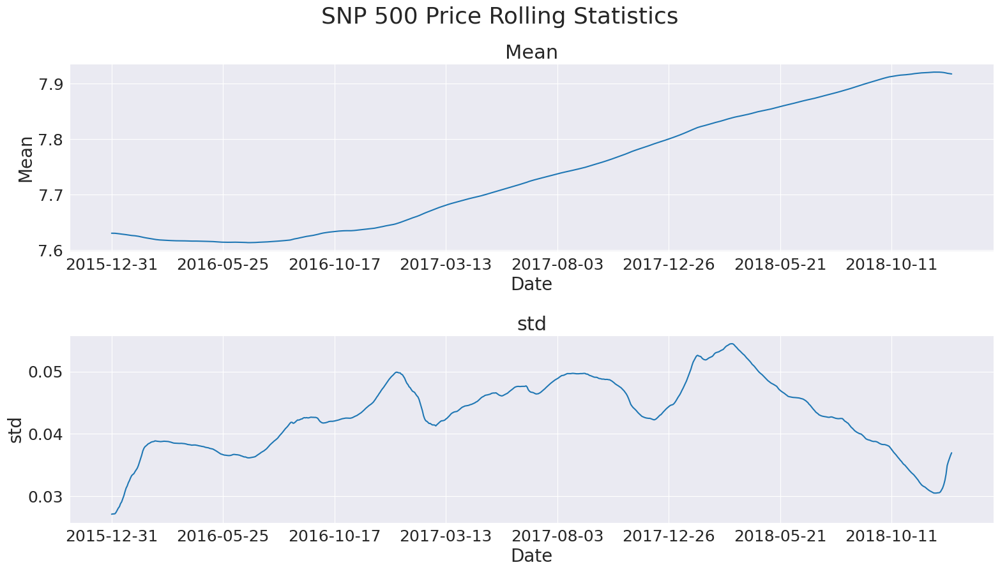

In [12]:
# Stats
fig = plt.figure()
st = fig.suptitle("SNP 500 Price Rolling Statistics", fontsize="x-large")

ax1 = fig.add_subplot(211)
snp_close['Close'].rolling(252).mean().dropna().plot()
ax1.set_title("Mean")
ax1.set_xlabel('Date')
ax1.set_ylabel('Mean')

ax2 = fig.add_subplot(212)
snp_close['Close'].rolling(252).std().dropna().plot()
ax2.set_title("std")
ax2.set_xlabel('Date')
ax2.set_ylabel('std')
fig.tight_layout()

# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)
fig.show()

fig.savefig(FIGURES_PATH+'snp_500_stats.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

The mean and std exhibit non-stationary properties, as they are not independent of time. Therefore, an ARIMA model is more appropriate as the differencing parameter will be able to remove the trend directly. Trend remove is necessary for an ARMA model to be properly analyzed.

### 1.2.2

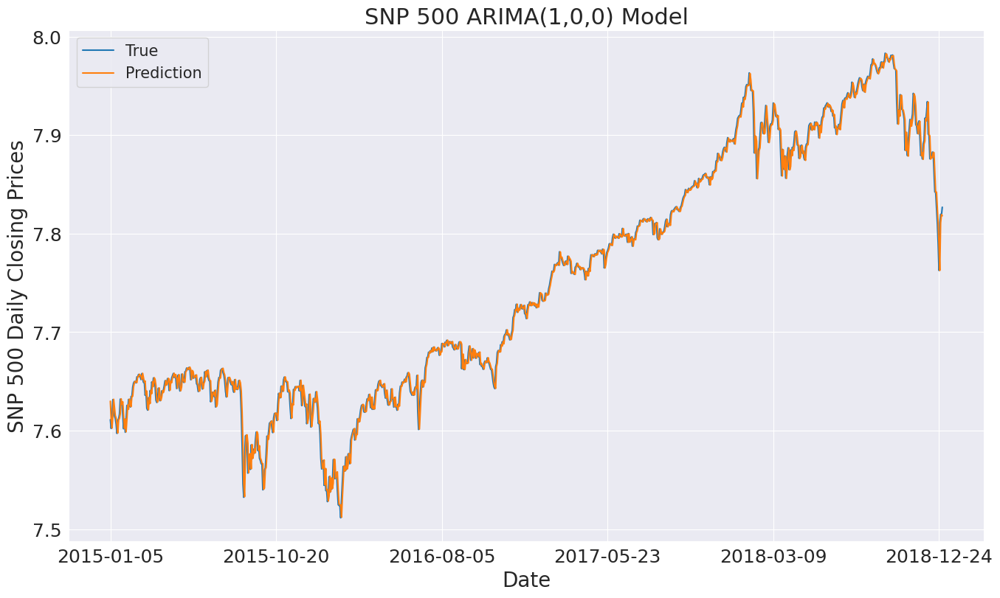

In [13]:
snp_arma = copy.deepcopy(snp_close)
snp_arma.columns = ["True"]
snp_arma["Res"] = ARIMA(snp_arma, order = (1,0,0)).fit().resid
snp_arma["Prediction"] = snp_arma["True"] - snp_arma["Res"]

snp_arma[1:].plot(y=["True", "Prediction"])
plt.xlabel('Date')
plt.ylabel('SNP 500 Daily Closing Prices')
plt.title('SNP 500 ARIMA(1,0,0) Model')
plt.savefig(FIGURES_PATH+'snp_500_arima_100.svg')
plt.show()

In [14]:
ARIMA_model = ARIMA(snp_arma["True"], order = (1,0,0)).fit()
ARIMA_model.params

const     7.748867
ar.L1     0.997354
sigma2    0.000074
dtype: float64

The parameters show that the ARMA(1,0) model has learnt the mean of the SNP500 index as the constant (~7.8). However, this is not useful as the data is non-stationary, so this mean is not a good fit. 

Secondly the 0.99 $ar_1$ value shows that the model places a high positive weight on the value of the time series at time lag = 1. This is because the data is non-stationary, and so the model has essentially learnt the overall upwards trend that can be seen in the data. Therefore, this is also not very useful in practice.

### 1.2.3

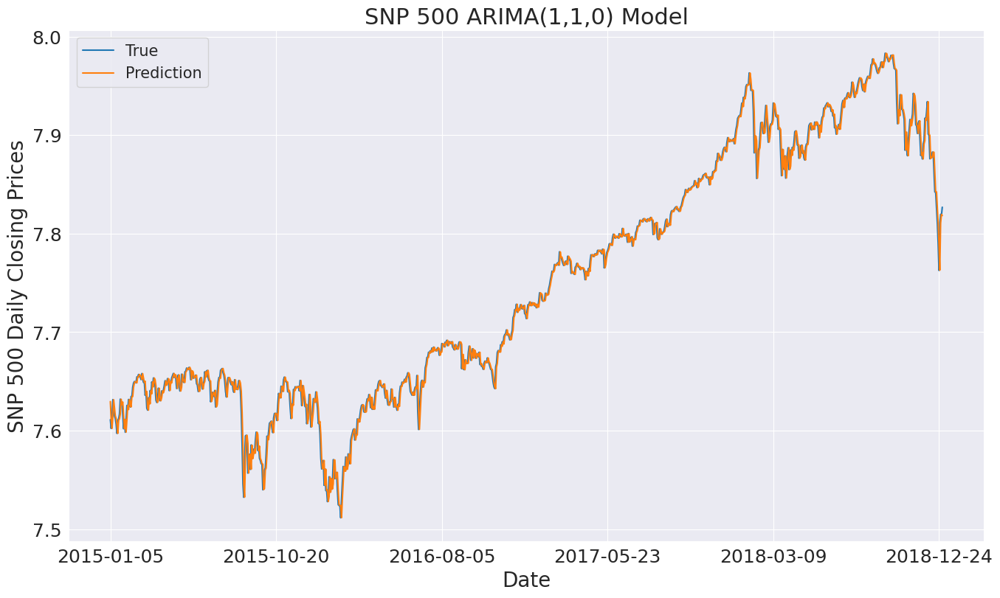

In [15]:
snp_arma = copy.deepcopy(snp_close)
snp_arma.columns = ["True"]
snp_arma["Res"] = ARIMA(snp_arma, order = (1,1,0)).fit().resid
snp_arma["Prediction"] = snp_arma["True"] - snp_arma["Res"]

snp_arma[1:].plot(y=["True", "Prediction"]) # ignore first entry of 0 from ARIMA model
plt.xlabel('Date')
plt.ylabel('SNP 500 Daily Closing Prices')
plt.title('SNP 500 ARIMA(1,1,0) Model')
plt.savefig(FIGURES_PATH+'snp_500_arima_110.svg')
plt.show()

In [16]:
ARIMA_model = ARIMA(snp_arma["True"], order = (1,1,0)).fit()
ARIMA_model.params

ar.L1    -0.008170
sigma2    0.000074
dtype: float64

This result is more meaningful as the differencing of 1 (intrgrated = 1 in ARIMA) has made the data stationary. Therefore, the analysis of the model coefficients now shows that there is < 0.01 weighting on the first time lag. This shows that there is little correlations between time steps. 

In addition, the data has effectively been zero-meaned as the constant parameter ~0.

### 1.2.4

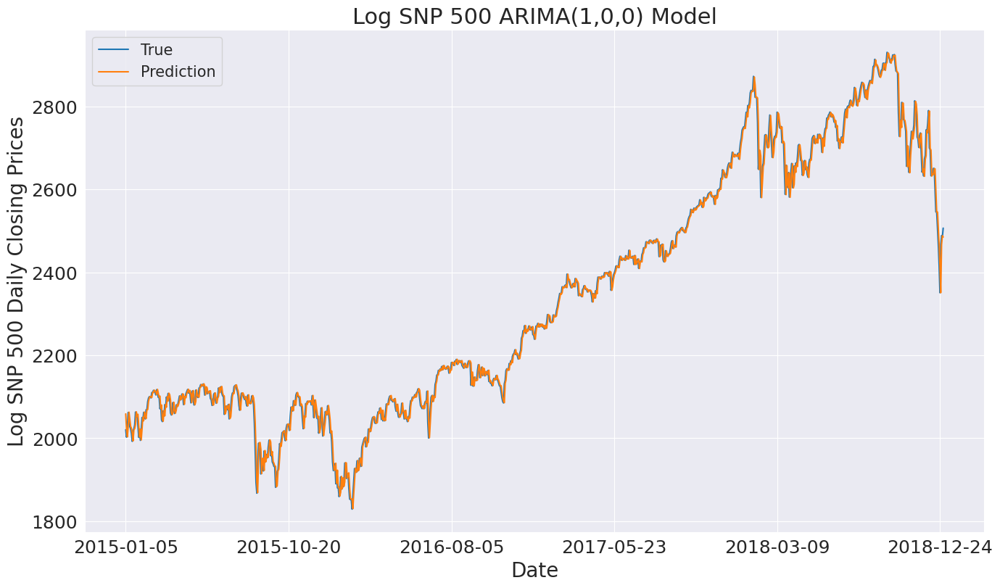

In [17]:
snp = pd.read_csv(SNP_500_2015_2019_PATH)
snp.set_index(["Date"], inplace=True)
snp_close = snp["Close"].to_frame()

snp_arma = copy.deepcopy(snp_close)
snp_arma.columns = ["True"]
snp_arma["Res"] = ARIMA(snp_arma, order = (1,0,0)).fit().resid
snp_arma["Prediction"] = snp_arma["True"] - snp_arma["Res"]
snp_arma[1:].plot(y=["True", "Prediction"]) # ignore first entry of ARIMA model
plt.xlabel('Date')
plt.ylabel('Log SNP 500 Daily Closing Prices')
plt.title('Log SNP 500 ARIMA(1,0,0) Model')
plt.savefig(FIGURES_PATH+'log_snp_500_arima_100.svg')
plt.show()

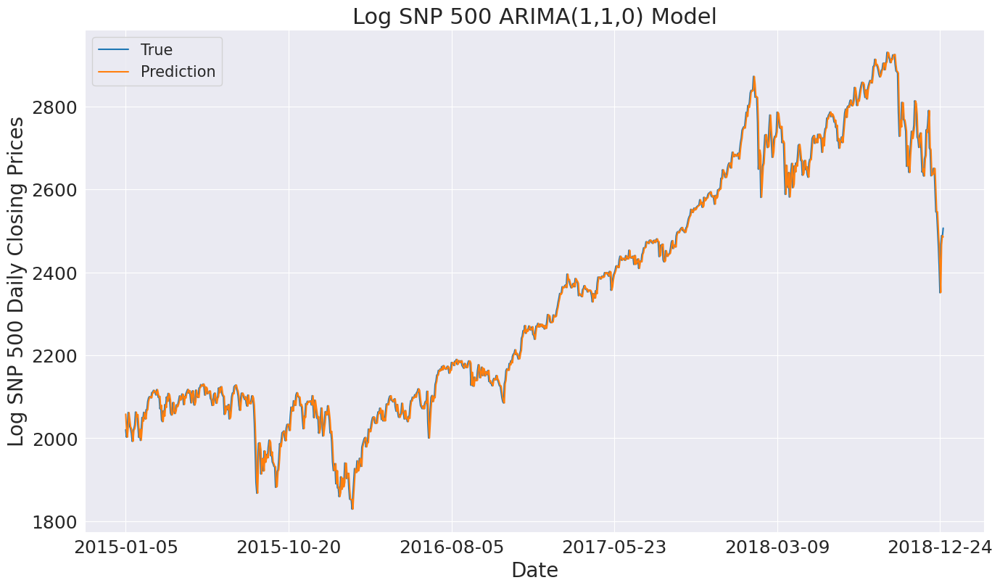

In [18]:
snp_arma = copy.deepcopy(snp_close)
snp_arma.columns = ["True"]
snp_arma["Res"] = ARIMA(snp_arma, order = (1,1,0)).fit().resid
snp_arma["Prediction"] = snp_arma["True"] - snp_arma["Res"]
snp_arma[1:].plot(y=["True", "Prediction"]) # ignore first entry of ARIMA model
plt.xlabel('Date')
plt.ylabel('Log SNP 500 Daily Closing Prices')
plt.title('Log SNP 500 ARIMA(1,1,0) Model')
plt.savefig(FIGURES_PATH+'log_snp_500_arima_110.svg')
plt.show()

In [19]:
ARIMA_model = ARIMA(snp_arma["True"], order = (1,0,0)).fit()
ARIMA_model.params

const     2337.235706
ar.L1        0.997441
sigma2     398.763173
dtype: float64

In [20]:
ARIMA_model = ARIMA(snp_arma["True"], order = (1,1,0)).fit()
ARIMA_model.params

ar.L1      -0.006298
sigma2    399.320097
dtype: float64

The plots for the log-prices and normal prices are the same. Therefore, it is not necessary to take the log of the prices for the ARIMA model.

### 1.3: Vector Autoregressive (VAR) Models


### 1.3.1

Let $\boldsymbol{Y} \in \mathbb{R}^{KxT}$ be a $KxT$ matrix where each column represents the vector of K variables at time $t$, therefore:

\[
Y = \begin{bmatrix} 
    y_{1,t} & \dots  & y_{1,T}\\
    \vdots & \ddots & \vdots\\
    y_{K,t} & \dots  & y_{K,T} 
    \end{bmatrix}
\]


Let $\boldsymbol{B} \in \mathbb{R}^{K x (KP+1)}$ be a $K x (KP+1)$ matrix where the first column contains the intercept $\boldsymbol{c}$ and the remaining columns contain the coefficients of the lagged values of $\boldsymbol{Y}$, therefore:

\[
B = \begin{bmatrix} 
    c_1 & A_1^1 & \dots & A_1^p\\
    \vdots & \vdots & \ddots & \vdots\\
    c_k & A_k^1 & \dots  & A_k^p 
    \end{bmatrix}
\]

Let $\boldsymbol{Z} \in \mathbb{R}^{(KP+1)xT}$ be a $(KP+1) x T$ matrix where the first row contains 1's (for the intercept term c) and the next K rows contain the lagged values of $\boldsymbol{y}$ up to $p$ lags. Therefore, 

\[
Z = \begin{bmatrix} 
    1 & 1 \dots & 1 \\
    y_{1,t-1} & \dots & y_{1,t-p} \\ 
    \vdots & \ddots & \vdots\\
    y_{k,t-1} & \dots  & y_{k,t-p} 
    \end{bmatrix}
\]

Let $\boldsymbol{U} \in \mathbb{R}^{KxT}$ be a $KxT$ matrix for the error terms $\boldsymbol{e_t}$, therefore:

\[
U = \begin{bmatrix} 
    e_{1,t} & \dots & e_{1,T} \\
    \vdots & \ddots & \vdots\\
    e_{K,t} & \dots  & e_{K,T} 
    \end{bmatrix}
\]

Then in concise matrix form:
$$ \boldsymbol{Y} = \boldsymbol{B}\boldsymbol{Z} + \boldsymbol{U} $$

### 1.3.2

This is a Least Squares solution with squared loss function:
$$ \boldsymbol{L(B)} = \frac{1}{2} \| \boldsymbol{Y} - \boldsymbol{BZ}\|^2_2 $$

Differentiating w.r.t $\boldsymbol{B}$:
$$ (\boldsymbol{Y-BZ})-\boldsymbol{Z^T} $$

Setting = 0 and solving for $\boldsymbol{B_{opt}}$:
$$ \boldsymbol{YZ^T} = \boldsymbol{BZZ^T} $$
$$ \boldsymbol{B_{opt}} = \boldsymbol{Z^TY}(\boldsymbol{Z^TZ})^{-1} $$

### 1.3.3

It is possible to rewrite the equations: 
\begin{equation}
    \boldsymbol{y_t} = \boldsymbol{Ay_{t-1}} + \boldsymbol{e_t}
\end{equation}
and
\begin{equation}
    \boldsymbol{y_{t-1}} = \boldsymbol{Ay_{t-2}} + \boldsymbol{e_{t-1}}
\end{equation}
into the following equation:
\begin{equation}
     \boldsymbol{y_t} = \boldsymbol{A^ty_0} + \boldsymbol{A} \Sigma_{i=0}^{t-1} \boldsymbol{e_i} + \boldsymbol{e_t} 
\end{equation}

Therefore, it can be seen from this form that the matrix A determines how much past values of the time series will affect the current value. This can be shown using eigen decomposition:
\begin{equation}
\boldsymbol{A^tv} = \boldsymbol{\lambda^tv}
\end{equation}

From this, if an eigenvalue is less than 1 in absolute value, it means that the corresponding eigenvector changes at a decreasing rate over time, which leads to a stable and stationary time series. On the other hand, if an eigenvalue is greater than 1 in absolute value, it means that the corresponding eigenvector changes at an increasing rate over time, leading to an unstable and non-stationary time series which will eventually diverge to $+\infty$ as $t \rightarrow \infty$.
\\ \\
Mathematically,

    \[
    \text{as t} \rightarrow \infty, \boldsymbol{y_t} \rightarrow  
\begin{cases}
    \infty, & \text{if } \boldsymbol{|\lambda| \geq 1}\\
    \boldsymbol{A} \Sigma_{i=0}^{t-1} \boldsymbol{e_i} + \boldsymbol{e_t},              & \text{otherwise}
\end{cases}
\]

### 1.3.4

In [21]:
df = pd.read_csv(SNP_ALLSTOCKS_2015_2019_PATH)
df = df.set_index("Date")

info = pd.read_csv(SNP_INFO_PATH)
info.drop(columns=info.columns[0], inplace=True)

tickers = ["CAG", "MAR", "LIN", "HCP", "MAT"]
stocks = df[tickers]
stocks_ma = stocks.rolling(window=66).mean()
stocks_detrended = stocks.sub(stocks_ma).dropna()

model = VAR(stocks_detrended)
results = model.fit(1)
A = results.params[1:]
eigA,_ = np.linalg.eig(A)
print(A)

eigA_abs = [np.absolute(eig) for eig in eigA]
print("A eigenvalues: {}".format(eigA_abs))

print("Max A eigenvalue: {}".format(max(eigA_abs)))

             CAG       MAR       LIN       HCP       MAT
L1.CAG  0.872786  0.113179 -0.281265  0.011912  0.058776
L1.MAR -0.063745  0.895820 -0.184820 -0.005004  0.022917
L1.LIN  0.000134 -0.111678  0.704023  0.004982 -0.025557
L1.HCP -0.084776 -0.083831 -0.401417  0.931708 -0.046406
L1.MAT  0.643072  0.094931  2.033036 -0.012884  0.802974
A eigenvalues: [0.7260939285436442, 0.7260939285436442, 1.0063596404610209, 0.860518942971363, 0.9114451152082131]
Max A eigenvalue: 1.0063596404610209


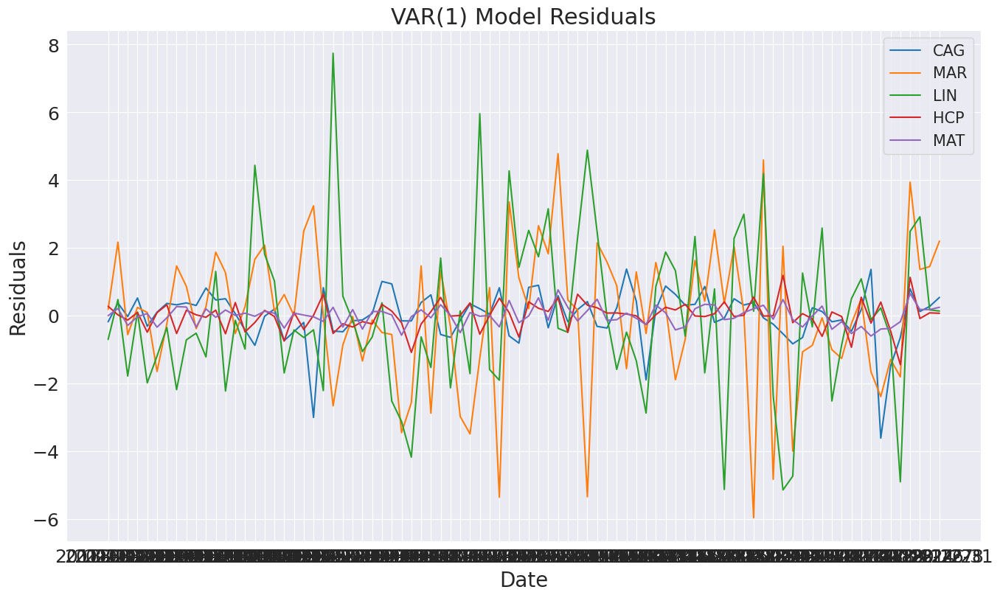

In [22]:
plt.plot(results.resid)
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.title('VAR(1) Model Residuals')
plt.legend(results.resid.columns)
plt.savefig(FIGURES_PATH+'var_model_residuals.svg')
plt.show()

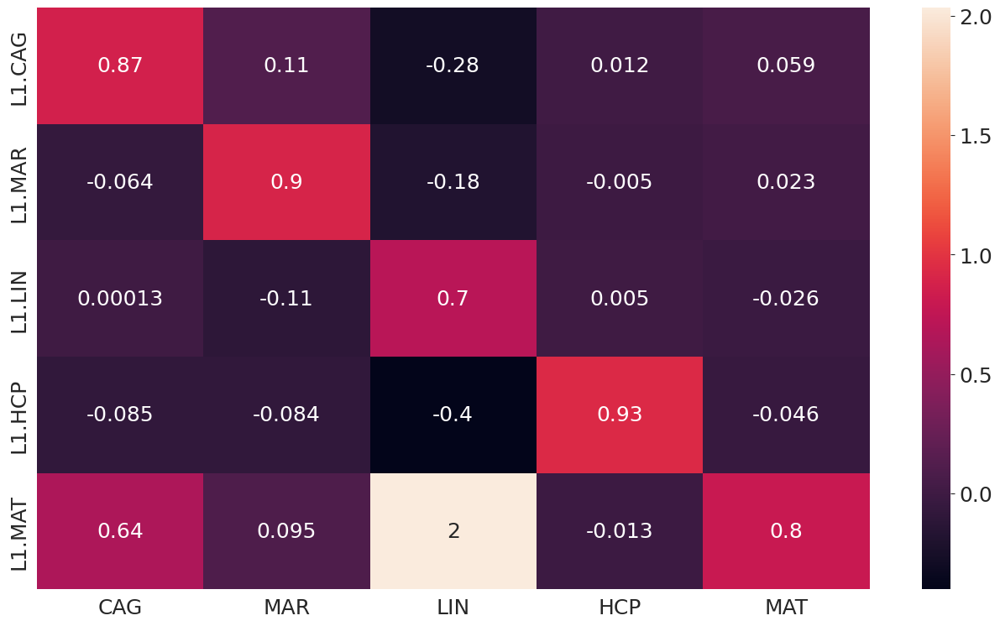

In [23]:
# create a heatmap using seaborn
sns.heatmap(A, annot=True)

# show the plot
plt.savefig(FIGURES_PATH+'var_model_A_heatmap.svg')
plt.show()

### 1.3.5

In [24]:
for sector in info["GICS Sector"].unique():
  tickers = info.loc[info["GICS Sector"]== sector]["Symbol"].tolist()
  stocks = df[tickers]

stocks.head()

,APC,APA,BHGE,COG,CVX,XEC,CXO,COP,DVN,FANG,...,NFX,NBL,OXY,OKE,PSX,PXD,SLB,FTI,VLO,WMB
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,82.290001,63.830002,56.169998,30.100000,112.580002,106.879997,101.010002,68.919998,60.959999,59.930000,...,26.600000,46.880001,80.513130,49.919998,72.290001,149.889999,85.669998,46.520000,50.340000,45.220001
2015-01-05,75.800003,59.910000,55.160000,28.450001,108.080002,100.690002,96.110001,65.639999,58.700001,57.279999,...,24.900000,42.389999,77.528198,47.060001,67.919998,139.830002,83.349998,44.700001,48.270000,43.430000
2015-01-06,75.239998,59.259998,54.990002,28.049999,108.029999,98.919998,94.180000,62.930000,57.500000,57.369999,...,24.600000,41.900002,76.869324,45.099998,66.019997,139.460007,81.720001,43.770000,47.680000,42.840000
2015-01-07,76.440002,58.599998,56.470001,28.290001,107.940002,98.080002,91.989998,63.349998,57.770000,58.250000,...,23.610001,41.740002,76.879303,44.770000,66.309998,137.929993,81.709999,42.279999,47.310001,42.610001
2015-01-08,78.910004,60.869999,57.029999,28.860001,110.410004,100.529999,96.400002,64.930000,59.820000,61.090000,...,23.980000,43.180000,77.558151,45.259998,68.889999,141.410004,82.699997,43.430000,50.020000,43.020000


In [25]:
stocks_ma = stocks.rolling(window=66).mean()
stocks_detrended = stocks.sub(stocks_ma).dropna()

model = VAR(stocks_detrended)
results = model.fit(1)
A = results.params[1:]
eigA,_ = np.linalg.eig(A)

print(A.head())

eigA_abs = [np.absolute(eig) for eig in eigA]
print(eigA_abs)

print("Max A eigenvalue: {}".format(max(eigA_abs)))

              APC       APA      BHGE       COG       CVX       XEC       CXO  \
L1.APC   0.899565  0.009050 -0.002193 -0.010254 -0.081052 -0.046905 -0.020438   
L1.APA   0.039963  0.938545 -0.009534 -0.004446  0.040962  0.027431  0.031936   
L1.BHGE  0.010828  0.009671  0.951718  0.000857  0.006464  0.001695 -0.021043   
L1.COG  -0.050341  0.003407 -0.057215  0.945686 -0.014936 -0.032648  0.033278   
L1.CVX   0.011427  0.005770 -0.010219 -0.004894  0.934240  0.003278 -0.076487   

              COP       DVN      FANG  ...       NFX       NBL       OXY  \
L1.APC  -0.022130 -0.015705 -0.007175  ... -0.017753 -0.011908 -0.030415   
L1.APA   0.025832 -0.004395 -0.004877  ...  0.005023  0.027905  0.007659   
L1.BHGE  0.005749 -0.002652 -0.032764  ...  0.009473  0.006298 -0.002875   
L1.COG  -0.046080  0.011797 -0.009296  ... -0.007989 -0.018786 -0.005214   
L1.CVX   0.014878  0.021638 -0.040898  ... -0.016624  0.017663 -0.010183   

              OKE       PSX       PXD       SLB       FT

ANSWER HERE

## **Section 2: Bond Pricing**

### **2.1 Examples of bond pricing**

### **2.1.1**

$$r_1 = 1100$$

$$r_0 = 1000$$

Annually:
$$1+r_f = \frac{1100}{1000}$$. Therefore, $$r_f = \frac{1100}{1000}-1 = 0.1 = 10% $$

Semi-annually:

$$1100 = 1000*(1+\frac{r_f}{2})^2 $$
$$ \sqrt{1.1} = 1+\frac{r_f}{2} $$
$$ r_f = (\sqrt{1.1}-1)*2 = 0.0976 = 9.76% $$

Monthly:

$$ 1100 = 1000*(1+\frac{r_f}{12})^{12}$$
$$ 1.1^{1/12} = 1+\frac{r_f}{12} $$
$$ r_f = (1.1^{1/12}-1)*12 = 0.0957 = 9.57% $$

Continuous:

$$ 1100 = 1000*e^{r_f} $$
$$ r_f = ln(1.1) = 0.0953 = 9.53% $$



### 2.1.2

Let $ r_0 = 1000 $
$$ r_1 = 1000*(1+\frac{0.15}{12})^{12} = 1160.75 $$
Therefore,
$$ r_f = ln(\frac{r_1}{1000}) = 0.149 = 14.9% $$

### 2.1.3

$ r_0 = 10000 $

$$ r_f = ln((1+\frac{0.12}{4})^4) = 0.122 = 12.2% $$
Therefore, year interest $ = 0.122 * 10,000 = 1,220 $

ANSWER HERE

### 2.2 Forward Rates

a)

Forward rates are calculated to determine future values.

If investing for one year, $r_0 = 100$
$$ r_1 = 100*1.05 = 105 $$
$$ r_2 = 105*1.05 = 110.25 $$
Where the investor has re-invested his one year return, assuming the same one-year interest rate.
However, $110.25 < 114.49$, so it is better to invest for 2 years rather than one.

On the other hand, the opportunity cost of keeping the $100 locked in may not be suitable for an investor, in case the economic conditions change between year 1 and year 2, e.g. a more favourable spot rate after year 1. 

b)

The 5\% investment strategy is the most flexible as the investor has the choice to re-invest his earnings after one year, or choose a different asset. 

The 7\% strategy is more optimal given that the investor does not require the invested \$100 until 2 years, e.g. through arbitrate opportunities, i.e. the market is efficient. Arbitrage should be exploited if found and so the investor would want all the cash available to profit maximally. 

The extra return strategy of 9\% relies on the seller's prediction of market interest rates in one years time to be accurate. However, economic shocks or new innovations (assuming Adaptive Market Hypothesis) may make these predictions in accurate, and so the extra return strategy may lead to even better gains, or worse returns than the 5\% strategy.

c)

Advantages:
- If the forward rate rate of interest of 9\% is accurate, this will lead to a more optimal allocation of resources (cash) by the investor now.
- The investor (and seller) can be more confident in their returns, as the agreement ensures a fixed return after 2 years regardless of market conditions later. This reduces risk (variance). 

Disadvantages:
- It is almost impossible to predict forward rates of interest with absolute certainty, and so there will be a non-negligible probability (following a probability distribution) that the forward rate of 9\% will be sub-optimal after the 2nd year. For example, economic shocks or new innovations may create arbitrage opportunities after year 1, which the investor would want all the resources (i.e. the invested \$100 with one-year interest rate) to invest with. 

d)

$(1+r_i)^i = (1+r_j)^j(1+f_{j,i})^{ij}$

### 2.3 Duration of a coupon-bearing bond

### 2.3.1

a)

Duration = 
$$ \frac{1*9.52}{768.55} + \frac{2*9.07}{768.55} + \frac{3*8.64}{768.55} + \frac{4*8.23}{768.55} + \frac{5*7.84}{768.55} + \frac{6*7.46}{768.55} + \frac{7*717.79}{768.55}$$
$$ = 6.76 $$ years

b)

 
$$ Modified duration = \frac{duration}{1+yield} = \frac{6.76}{1.05} = 6.44$$
The modified duration will always be smaller than duration for a positive yield. 

The modified duration is an approximation to $-\frac{dP}{dy}$, whereas duration is the weighted average of times to each of the cash payments.

c)

Duration and modified duration is a measure of the sensitivity of a bond's price to changes in interest rates. It is therefore a measure of risk (through measures of variance/volatility) when looking at bonds.

By using duration or modified duration to assess the potential impact of changes in interest rates on its investments, a pension plan can better understand the risks associated with those investments and make informed decisions about how to manage those risks. For example, a pension plan might choose to invest in bonds with shorter durations or modified durations in order to reduce its exposure to changes in interest rates, or it might choose to invest in a diversified portfolio of bonds with a range of durations or modified durations in order to spread out the risk of changes in interest rates.

### **2.4: Capital Asset Pricing Model (CAPM) and Arbitrage Pricing Theory (APT)**

### **2.4.1**

In [26]:
df = pd.read_csv(FSP_CASE_31_BSD_PATH, index_col=0, header =[0, 1])
print("Before filling na values: ",df.isna().sum().sum())
df = df.fillna(0)
print("After filling na values: ",df.isna().sum().sum())
df.head()

Before filling na values:  8440
After filling na values:  0


ret                                                    \
cmp_id       G_AALLN   G_ABIBB    G_ACFP  G_ADENVX  G_ADLERR    G_ADNA   
2017-01-02  0.000000  0.005470  0.008044  0.000000 -0.008627  0.002247   
2017-01-03  0.001724 -0.008902  0.024360  0.013504 -0.005221 -0.005728   
2017-01-04 -0.016781  0.002495  0.022686  0.028127  0.010847 -0.005261   
2017-01-05  0.002188  0.005973  0.015369  0.000000  0.001385 -0.010073   
2017-01-06 -0.008734 -0.005443 -0.002764 -0.000720  0.019357 -0.002035   

                                                    ...          mcap  \
cmp_id        G_AFFP    G_AIFP   G_AIRFP  G_AKZANA  ...       G_TUIGR   
2017-01-02 -0.003672 -0.002366 -0.000318  0.005388  ...  8.482741e+09   
2017-01-03  0.003686  0.002372  0.010824  0.004522  ...  8.323817e+09   
2017-01-04  0.012176 -0.000946 -0.001575  0.004502  ...  8.406386e+09   
2017-01-05  0.014703  0.000474  0.018928 -0.004149  ...  8.537808e+09   
2017-01-06 -0.007339  0.004261  0.008359 -0.003333  ...  8.447881e+09   

                                                                    \
cmp_id           G_UNANA       G_UPMFH       G_VIEFP       G_VIVFP   
2017-01-02  6.465269e+10  1.321824e+10  9.715319e+09  2.455592e+10   
2017-01-03  6.322076e+10  1.307431e+10  9.450640e+09  2.419532e+10   
2017-01-04  6.387596e+10  1.307768e+10  9.501459e+09  2.454330e+10   
2017-01-05  6.472923e+10  1.327334e+10  9.432685e+09  2.487707e+10   
2017-01-06  6.430797e+10  1.324455e+10  9.316880e+09  2.494558e+10   

                                                                    \
cmp_id            G_VLVY         G_VOD          G_VW       G_WKLNA   
2017-01-02  1.917195e+10  6.573149e+10  4.385454e+10  1.107642e+10   
2017-01-03  1.911179e+10  6.594797e+10  4.404805e+10  1.083419e+10   
2017-01-04  1.934832e+10  6.733531e+10  4.391066e+10  1.088538e+10   
2017-01-05  1.952943e+10  6.923743e+10  4.480999e+10  1.116088e+10   
2017-01-06  1.946114e+10  6.930293e+10  4.450991e+10  1.109675e+10   

                          
cmp_id           G_WPPLN  
2017-01-02  2.874160e+10  
2017-01-03  2.861405e+10  
2017-01-04  2.854250e+10  
2017-01-05  2.910968e+10  
2017-01-06  2.903305e+10  

[5 rows x 314 columns]

In [27]:
# market returns per day
market_returns_per_day = df['ret'].mean(axis=1)
market_returns_per_day.index = df['ret'].index

print("Equally weighted total market return: {}".format(market_returns_per_day.sum()))
print("Equally weighted market return mean: {}".format(market_returns_per_day.mean()))
market_returns_per_day.head()

Equally weighted total market return: 0.03175380891719741
Equally weighted market return mean: 6.0947809821876025e-05


2017-01-02    0.007301
2017-01-03    0.000903
2017-01-04   -0.002168
2017-01-05    0.002934
2017-01-06    0.000987
dtype: float64

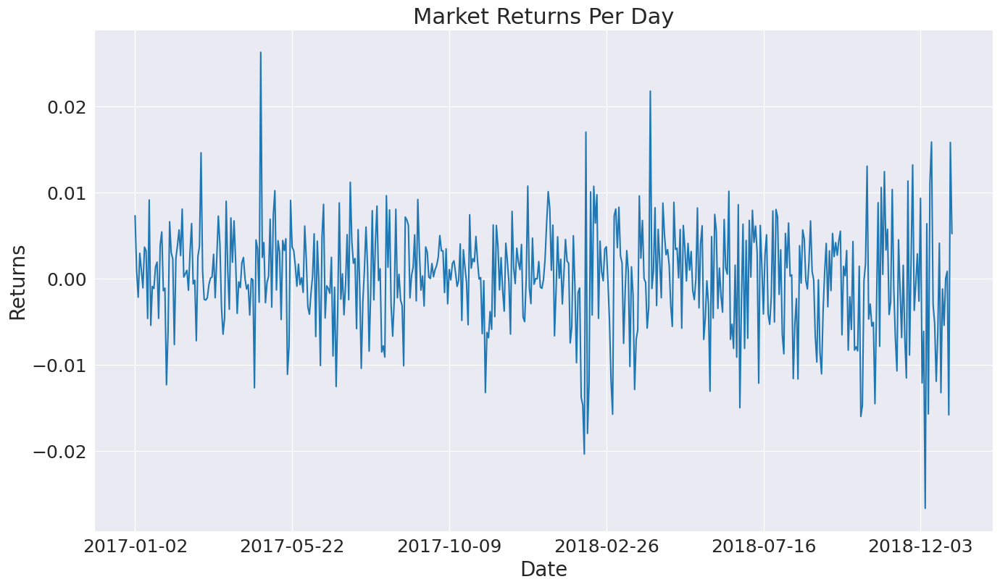

In [28]:
market_returns_per_day.plot()

plt.xlabel('Date')
plt.ylabel('Returns')
plt.title('Market Returns Per Day')

plt.savefig(FIGURES_PATH+'market_ret_per_day.svg')
plt.show()

### **2.4.2**

market return rolling betas mean: 1.0
market return rolling betas std: 0.708104366971137


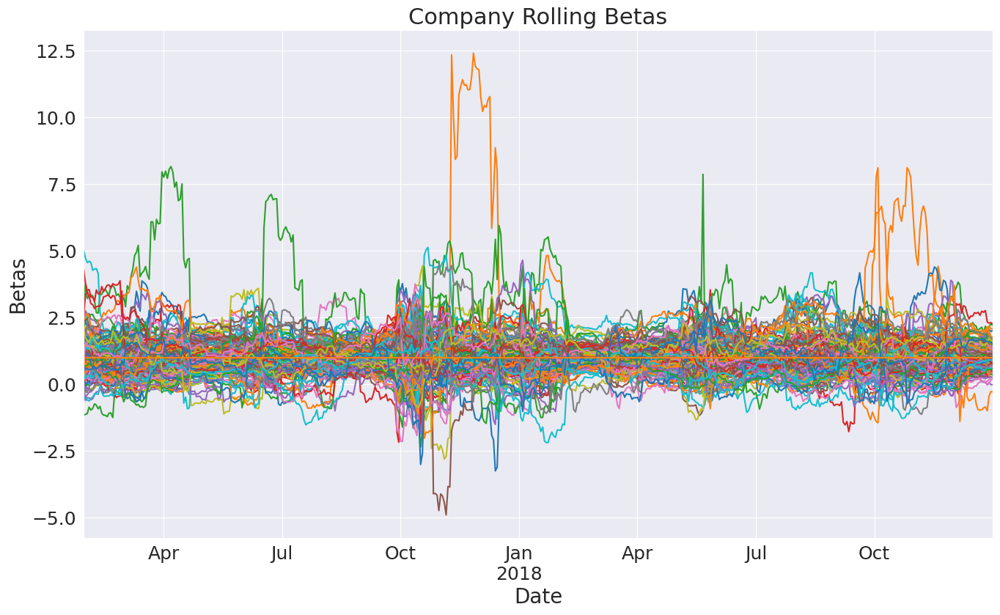

In [29]:
# data
df = pd.read_csv(FSP_CASE_31_BSD_PATH, index_col = 0, header = [0 ,1]) 

# Pre-process returns data.
returns = df['ret'].copy().dropna(1) # simple data pre-processing
returns.index = pd.to_datetime(returns.index) # Seth the index to date time type
returns = returns.sort_index() # sort by time
mark_return_non_weighted = returns.mean(1) # market equally-weighted returns

w = 22

# Define equally weighted returns and betas.
all_ret_non_weighted = returns.copy() 
all_ret_non_weighted['market'] = mark_return_non_weighted.copy()

betas_non_weighted = pd.DataFrame(columns = all_ret_non_weighted.columns) 

for t in all_ret_non_weighted.index[(w-1):]: 
    # For each time step calculate covariance matrix and betas.
    ret_C = all_ret_non_weighted[:t].iloc[-w:].cov() 
    curr_betas = ret_C['market'] / ret_C['market']['market']
    
    # Save betas into dataframe.
    betas_non_weighted.loc[t] = curr_betas

print("market return rolling betas mean: {}".format(np.mean(betas_non_weighted.values.reshape(-1))))
print("market return rolling betas std: {}".format(np.std(betas_non_weighted.values.reshape(-1))))

betas_non_weighted.plot(legend=False)
plt.xlabel('Date')
plt.ylabel('Betas')
plt.title('Company Rolling Betas')

plt.savefig(FIGURES_PATH+'company_rolling_betas.svg')
plt.show()

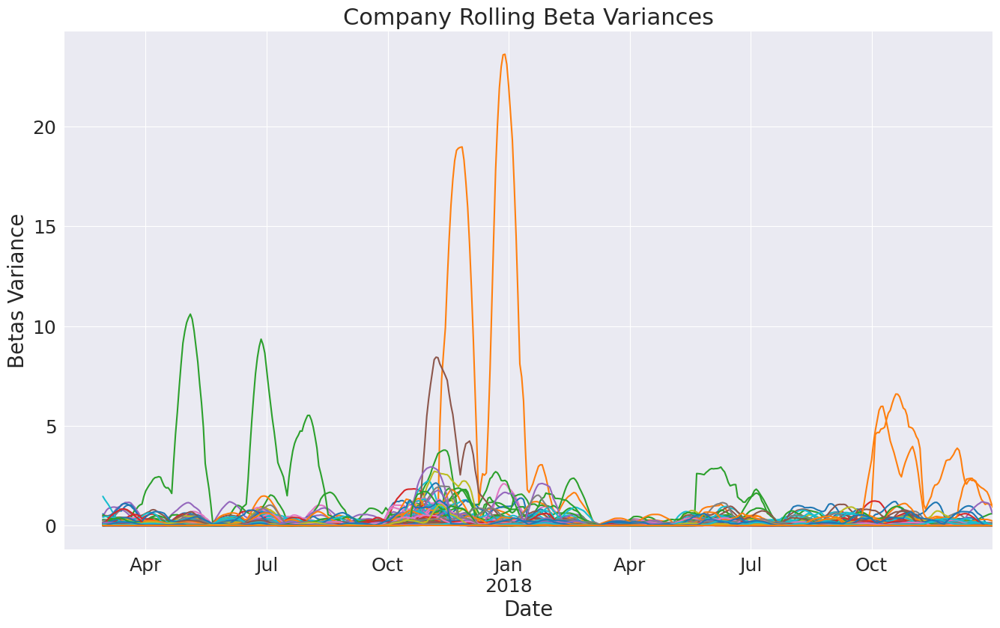

In [30]:
# volatility of betas
betas_non_weighted.rolling(22).var().plot(legend=False)
plt.xlabel('Date')
plt.ylabel('Betas Variance')
plt.title('Company Rolling Beta Variances')

plt.savefig(FIGURES_PATH+'company_rolling_betas_volatility.svg')
plt.show()

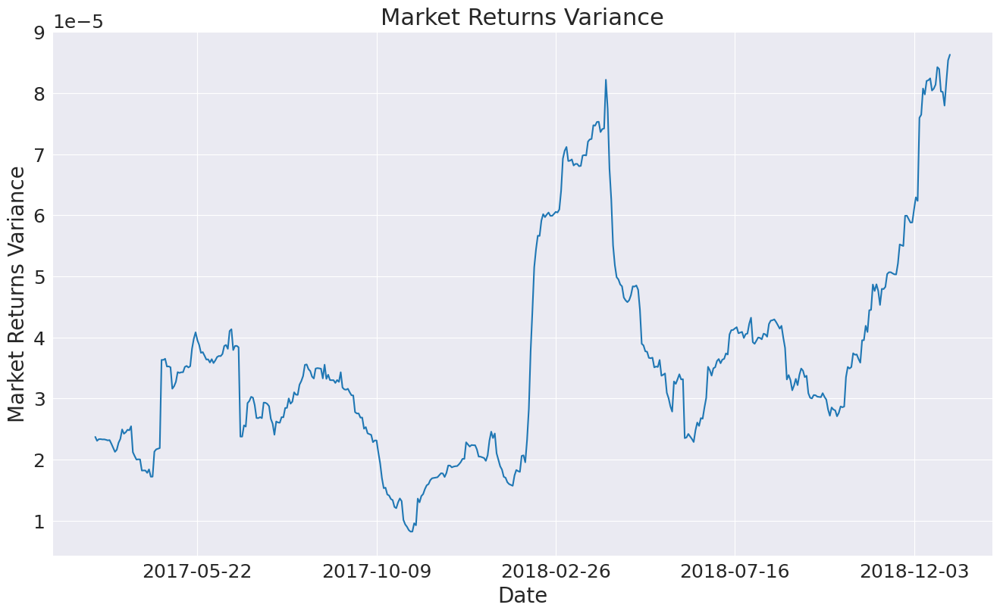

In [31]:
# Market volatility to compare to beta volatility

market_returns_per_day.rolling(44).var().plot()

plt.xlabel('Date')
plt.ylabel('Market Returns Variance')
plt.title('Market Returns Variance')

plt.savefig(FIGURES_PATH+'market_returns_variance.svg')
plt.show()

### **2.4.3**

Cap-weighted market return sum: 0.09816676864057114
Cap-weighted market return mean: 0.00018841990142144172
Cap-weighted market return std: 0.006599318685834846


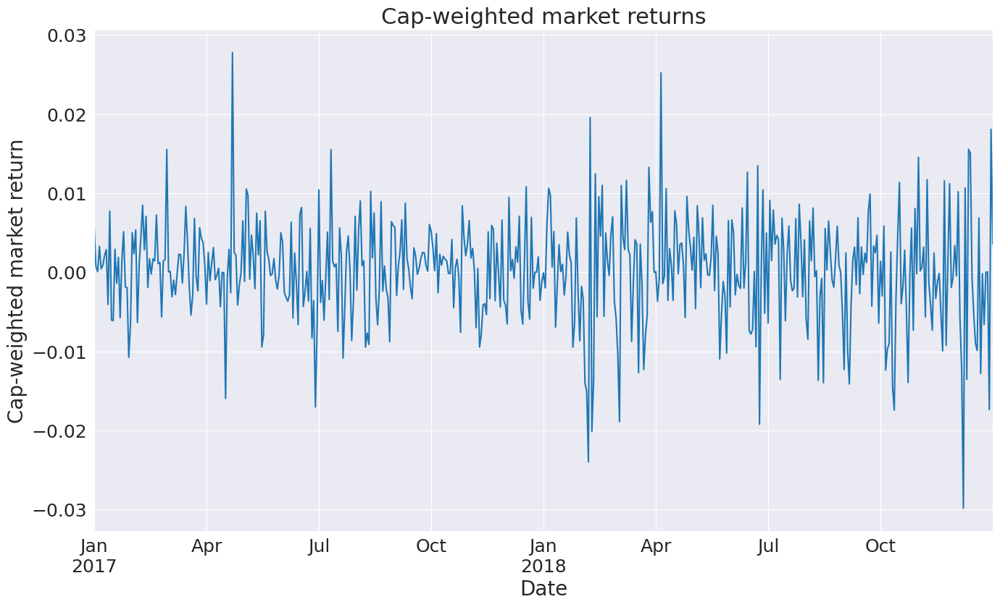

In [32]:
# market caps.
market_cap = df['mcap'].copy() 
market_cap.index = pd.to_datetime(market_cap.index) 
market_cap = market_cap[returns.columns]

# Compute the weights based on the market cap.
weights = market_cap.divide(market_cap.sum(1), 0)

# Compute the weighted market return.
weighted_returns = weights * returns.copy()
weighted_market_return = weighted_returns.sum(1)

print("Cap-weighted market return sum: {}".format(weighted_market_return.sum()))
print("Cap-weighted market return mean: {}".format(weighted_market_return.mean()))
print("Cap-weighted market return std: {}".format(weighted_market_return.std()))

weighted_market_return.plot()
plt.xlabel('Date')
plt.ylabel('Cap-weighted market return')
plt.title('Cap-weighted market returns')

plt.savefig(FIGURES_PATH+'cap_weighted_market_returns.svg')
plt.show()

### **2.4.4**

Cap-weighted market return rolling betas mean: 0.9616577418388089
Cap-weighted market return rolling betas std: 0.6940217680471462


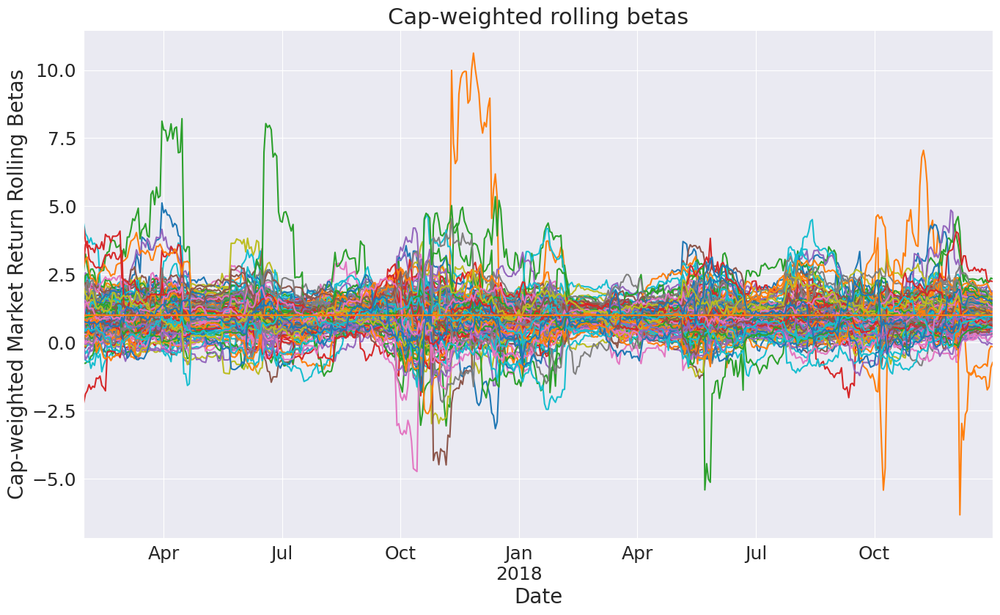

In [33]:
w = 22

# Recopy returns and populate betas dataframe
returns_matrix = returns.copy()
returns_matrix['market'] = weighted_market_return.copy() 

betas_weighted = pd.DataFrame(columns = returns_matrix.columns) 

for t in returns_matrix.index[w-1:]: 
    # At each time step compute covariance matrix and betas.
    ret_C = returns_matrix[:t].iloc[-w:].cov() 
    curr_betas = ret_C['market'] / ret_C['market']['market'] 
    
    # Save beta into dataframe.
    betas_weighted.loc[t] = curr_betas


print("Cap-weighted market return rolling betas mean: {}".format(np.mean(betas_weighted.values.reshape(-1))))
print("Cap-weighted market return rolling betas std: {}".format(np.std(betas_weighted.values.reshape(-1))))

betas_weighted.plot(legend=False)
plt.xlabel('Date')
plt.ylabel('Cap-weighted Market Return Rolling Betas')
plt.title('Cap-weighted rolling betas')

plt.savefig(FIGURES_PATH+'cap_weighted_market_return_rolling_betas.svg')
plt.show()

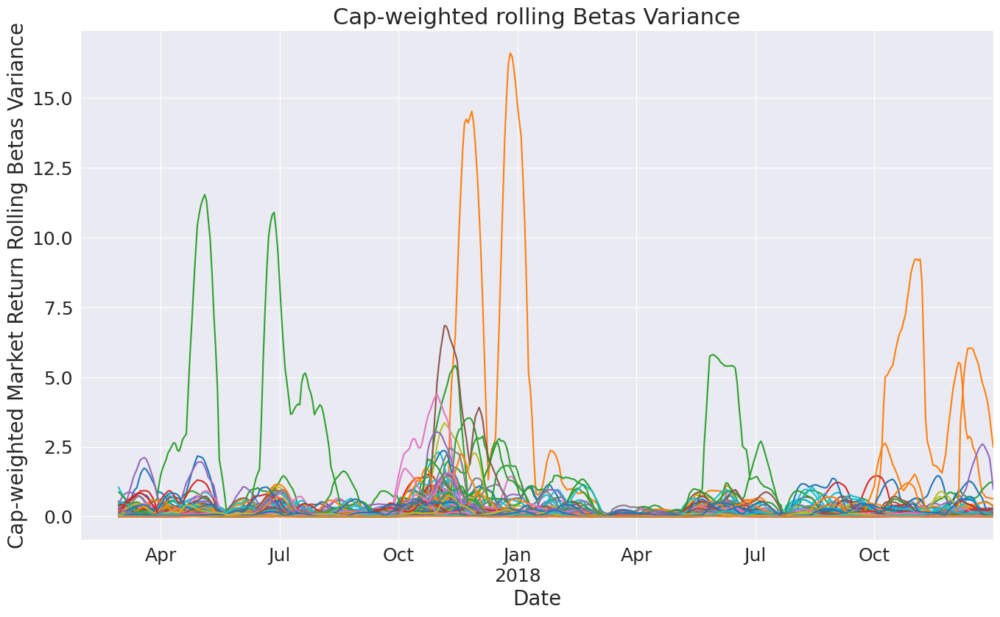

In [34]:
betas_weighted.rolling(22).var().plot(legend=False)
plt.xlabel('Date')
plt.ylabel('Cap-weighted Market Return Rolling Betas Variance')
plt.title('Cap-weighted rolling Betas Variance')

plt.savefig(FIGURES_PATH+'cap_weighted_market_return_rolling_betas_variance.svg')
plt.show()

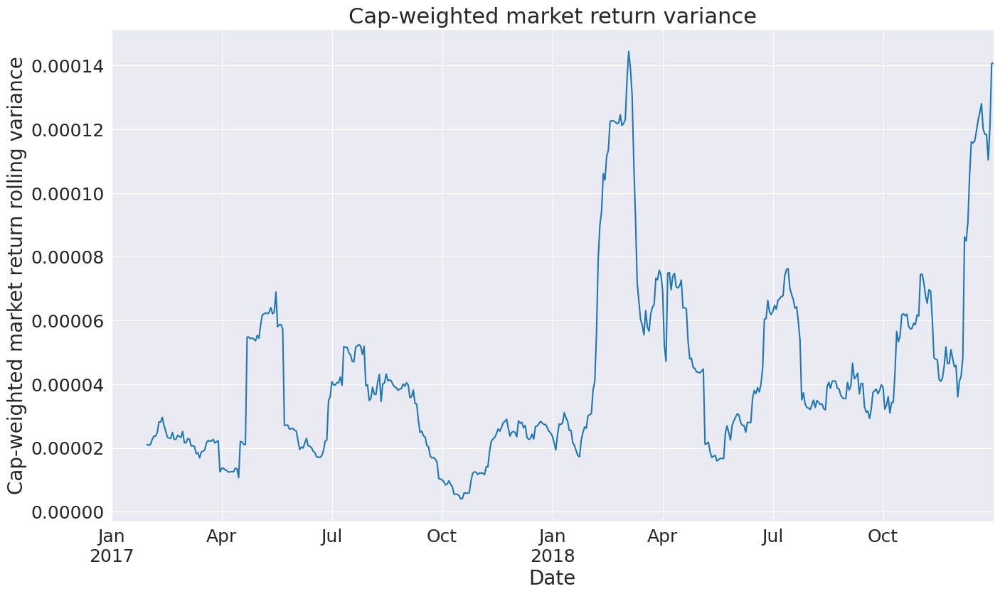

In [35]:
weighted_market_return.rolling(22).var().plot()
plt.xlabel('Date')
plt.ylabel('Cap-weighted market return rolling variance')
plt.title('Cap-weighted market return variance')

plt.savefig(FIGURES_PATH+'cap_weighted_market_return_variance.svg')
plt.show()

### **2.4.5**

In [36]:
# Remove market column from betas_weighted (all 1's)
betas_weighted = betas_weighted.drop(['market'], axis=1)

# Initialise APT parameters
daily_returns = returns.loc[betas_weighted.index]
Rm = pd.Series(index=daily_returns.index, dtype='float64')
Rs = pd.Series(index=daily_returns.index, dtype='float64')
a = pd.Series(index=daily_returns.index, dtype='float64')
e = pd.DataFrame(index=daily_returns.index, columns=daily_returns.columns)

In [37]:
# APT betas
betas_size = np.log(market_cap.loc[betas_weighted.index])
betas_size.head()

cmp_id,G_AALLN,G_ABIBB,G_ACFP,G_ADENVX,G_ADLERR,G_ADNA,G_AFFP,G_AIFP,G_AIRFP,G_AKZANA,...,G_TUIGR,G_UNANA,G_UPMFH,G_VIEFP,G_VIVFP,G_VLVY,G_VOD,G_VW,G_WKLNA,G_WPPLN
2017-01-31,23.899539,25.893432,23.169267,23.225770,20.364250,24.029109,21.186255,24.461549,24.682604,23.563044,...,22.874227,24.868187,23.217543,22.983570,23.882933,23.764075,24.898980,24.575244,23.168644,24.114918
2017-02-01,23.914623,25.894165,23.178058,23.229854,20.408430,24.027951,21.196801,24.460092,24.683554,23.567944,...,22.869405,24.866138,23.274499,22.962466,23.887589,23.808363,24.897203,24.579893,23.161926,24.115763
2017-02-02,23.909894,25.903728,23.183647,23.233685,20.403651,24.038160,21.196569,24.465992,24.683831,23.575972,...,22.872333,24.871877,23.307598,22.975232,23.887598,23.825519,24.889144,24.579590,23.181803,24.108300
2017-02-03,23.874348,25.910920,23.210398,23.228850,20.387374,24.044557,21.177003,24.468841,24.685705,23.575922,...,22.884303,24.880856,23.270543,22.979677,23.883624,23.814399,24.891835,24.582342,23.183944,24.110143
2017-02-06,23.867540,25.901053,23.192214,23.226684,20.376682,24.031232,21.166673,24.449814,24.681946,23.560481,...,22.875729,24.874325,23.258752,22.965852,23.877304,23.806120,24.880444,24.551603,23.180226,24.097054


In [38]:
for t in daily_returns.index: 
    # At each time frame compute current return, market beta and beta size.
    curr_r = daily_returns.loc[t].values.reshape(-1,1)
    curr_beta_market = betas_weighted.loc[t].values.reshape(-1,1)
    curr_beta_size = betas_size.loc[t].values.reshape(-1,1)
    
    # Compute M and b.
    one_matrix = np.ones((curr_beta_market.shape))
    B = np.hstack((one_matrix, curr_beta_market, curr_beta_size))
    theta = (np.linalg.inv(B.T @ B) @ B.T) @ curr_r # OLS Regression solution
    
    # save current values for Rm, Rs, a and e.
    Rm[t] = float(theta[1])
    Rs[t] = float(theta[2])
    a[t] = float(theta[0])
    e.loc[t] = (curr_r - B @ theta).reshape(1,-1)

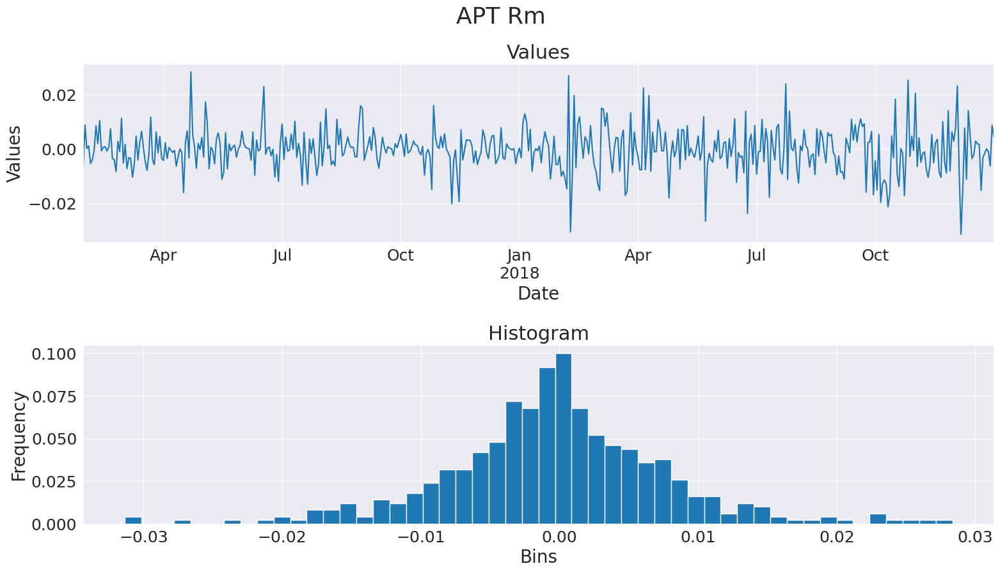

In [39]:
# Rm
fig = plt.figure()
st = fig.suptitle("APT Rm", fontsize="x-large")

ax1 = fig.add_subplot(211)
Rm.plot()
ax1.set_title("Values")
ax1.set_xlabel('Date')
ax1.set_ylabel('Values')

ax2 = fig.add_subplot(212)
weights = np.ones_like(Rm)/len(Rm)
Rm.plot.hist(bins=50, weights=weights)
ax2.set_title("Histogram")
ax2.set_xlabel('Bins')
ax2.set_ylabel('Frequency')
fig.tight_layout()

# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)
fig.show()

fig.savefig(FIGURES_PATH+'APT_Rm.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

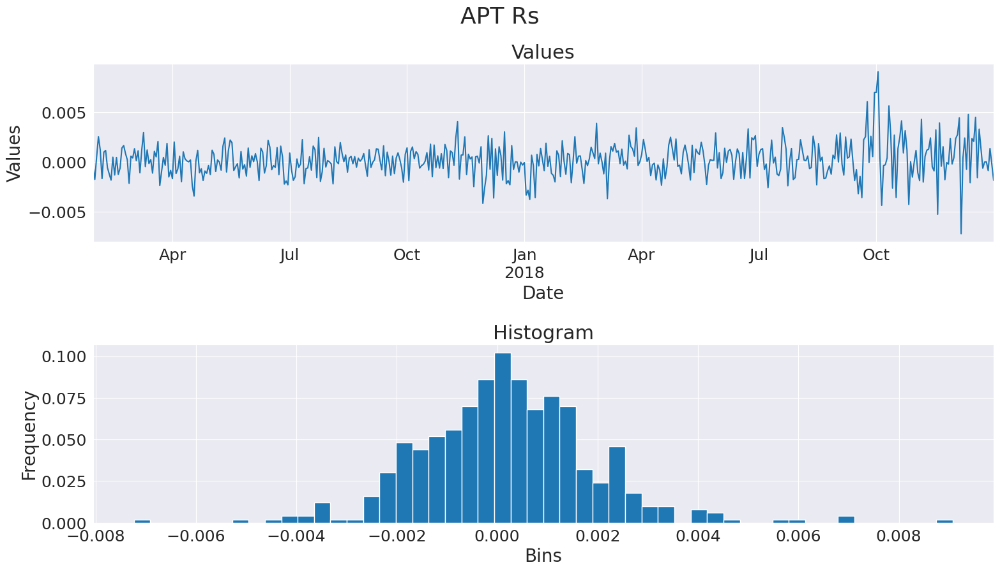

In [40]:
# Rs
fig = plt.figure()
st = fig.suptitle("APT Rs", fontsize="x-large")

ax1 = fig.add_subplot(211)
Rs.plot()
ax1.set_title("Values")
ax1.set_xlabel('Date')
ax1.set_ylabel('Values')

ax2 = fig.add_subplot(212)
weights = np.ones_like(a)/len(a)
Rs.plot.hist(bins=50, weights=weights)
ax2.set_title("Histogram")
ax2.set_xlabel('Bins')
ax2.set_ylabel('Frequency')
fig.tight_layout()

# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)
fig.show()

fig.savefig(FIGURES_PATH+'APT_Rs.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

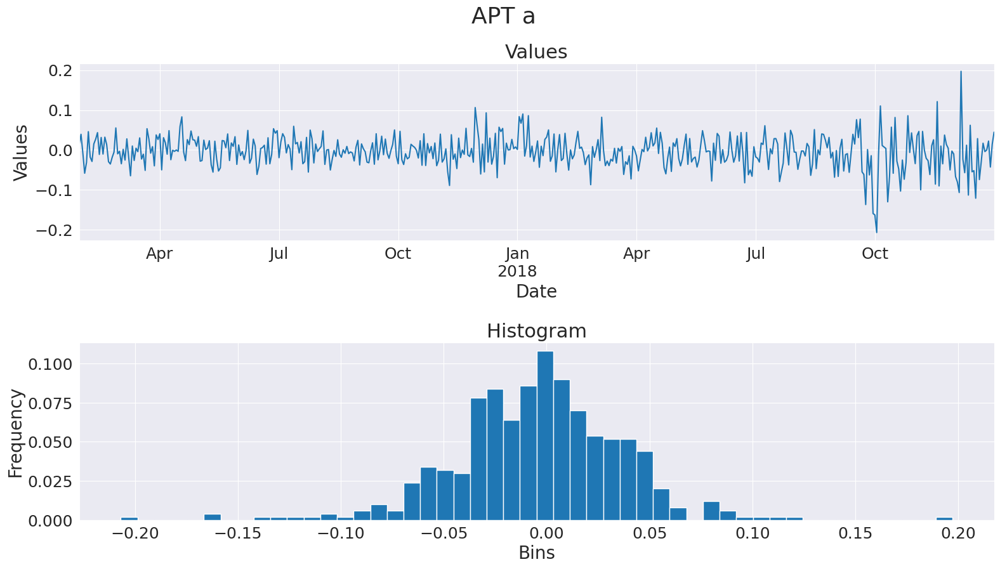

In [41]:
# a
fig = plt.figure()
st = fig.suptitle("APT a", fontsize="x-large")

ax1 = fig.add_subplot(211)
a.plot()
ax1.set_title("Values")
ax1.set_xlabel('Date')
ax1.set_ylabel('Values')

ax2 = fig.add_subplot(212)
weights = np.ones_like(a)/len(a)
a.plot.hist(bins=50, weights=weights)
ax2.set_title("Histogram")
ax2.set_xlabel('Bins')
ax2.set_ylabel('Frequency')
fig.tight_layout()

# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)
fig.show()

fig.savefig(FIGURES_PATH+'APT_a.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

b)

c)

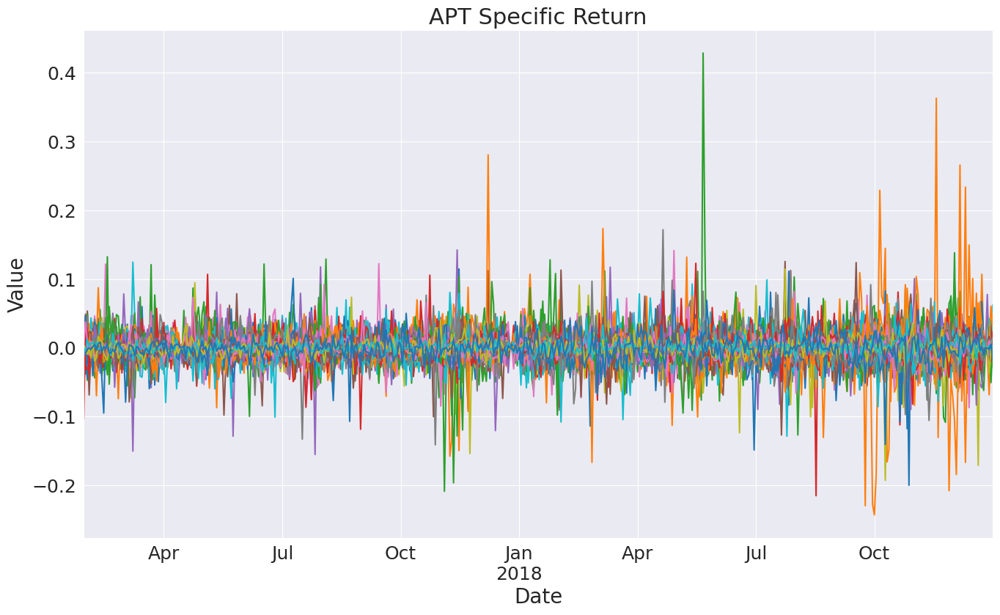

In [42]:
# Residual of the regression already calculated in a
e.plot(legend=False)
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('APT Specific Return')

plt.savefig(FIGURES_PATH+'APT_specific_return.svg')
plt.show()

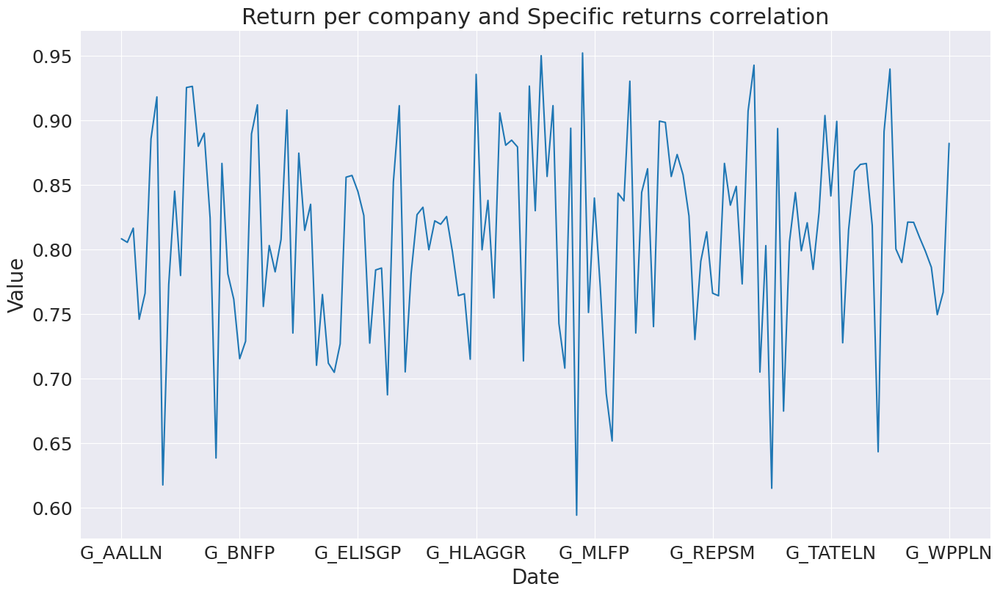

In [43]:
# Correlation of specific return with daily return
specific_ret_corr = pd.Series(index = e.columns, dtype = 'float64')

for company in e.columns:
    specific_ret_corr[company] = pearsonr(e[company], daily_returns[company])[0]

specific_ret_corr.plot()
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Return per company and Specific returns correlation')

plt.savefig(FIGURES_PATH+'APT_return_correlation.svg')
plt.show()

d)

          Rm        Rs
Rm  0.000063 -0.000003
Rs -0.000003  0.000003


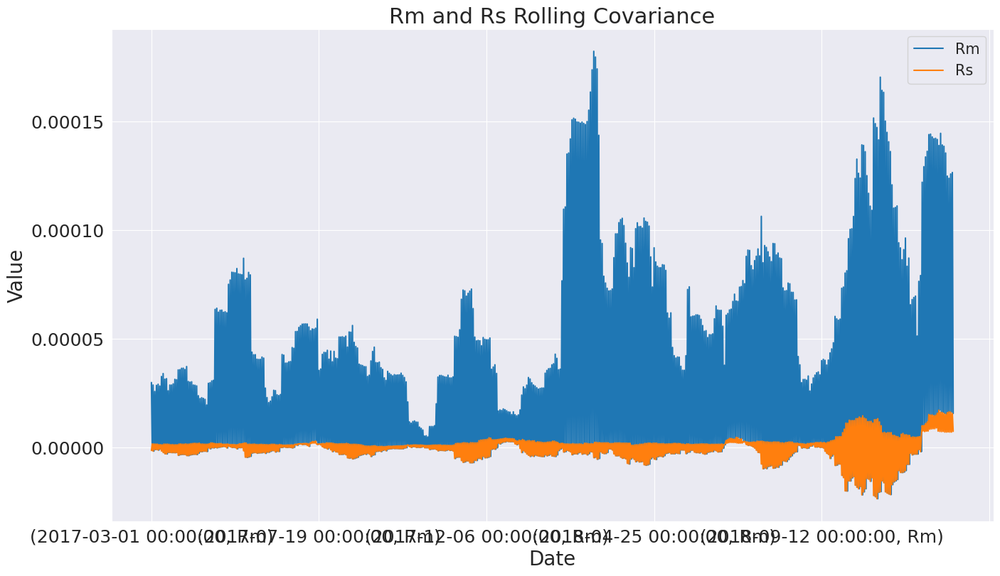

In [44]:
R = pd.concat([Rm, Rs], axis=1)
R.columns = ['Rm', 'Rs']
R_cov = R.cov()
print(R_cov)
R.rolling(22).cov().dropna().plot()
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Rm and Rs Rolling Covariance')

plt.savefig(FIGURES_PATH+'APT_Rm_Rs_Cov.svg')
plt.show()

e)

In [45]:
# Covariance matrix of specific returns
e_cov = e.astype(float).cov()
print(e_cov.shape)

(141, 141)


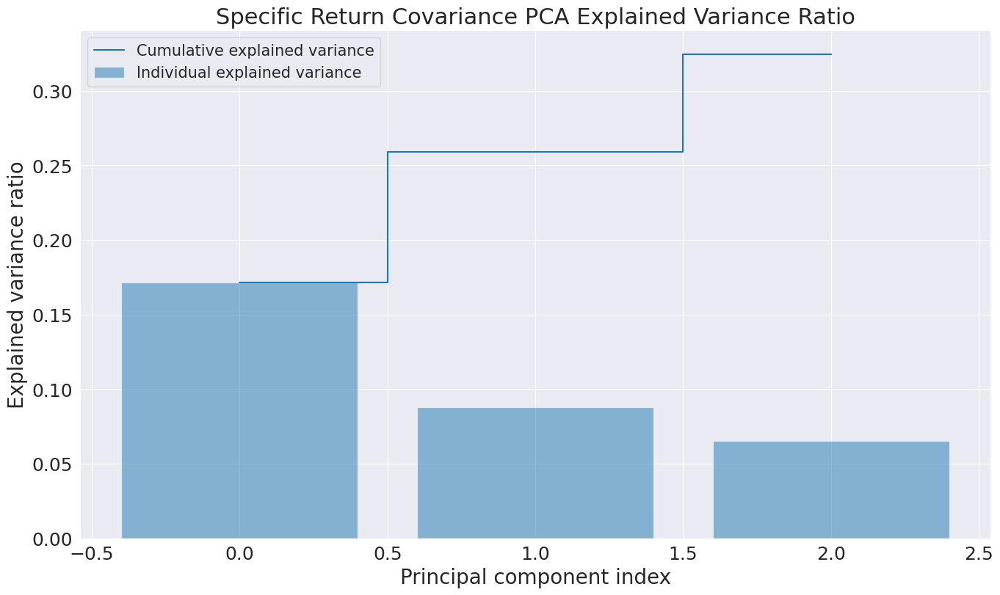

In [46]:
# PCA
# normalize the data before applying the fit method
e_cov_normalized = (e_cov - e_cov.mean()) / e_cov.std()
pca = PCA(n_components=3)
pca.fit(e_cov_normalized)

exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.title('Specific Return Covariance PCA Explained Variance Ratio')

plt.savefig(FIGURES_PATH+'APT_e_cov_pca.svg')
plt.show()

## **Section 3: Portfolio Optimization**

### **3.1: Adaptive minimum-variance portfolio optimization**

The Lagrangian optimisation formulation:
$$ min_{\boldsymbol{w}, \lambda} J'(\boldsymbol{w}, \lambda, \boldsymbol{C}) = \frac{1}{2}\boldsymbol{w^TCw} - \lambda (\boldsymbol{w^T1}-1) $$
To solve, we calculate partial derivates and set them = 0 to find optmial solutions.
$$ \frac{\partial J'}{\partial w} = \boldsymbol{w^TC} - \lambda\boldsymbol{1} = 0 $$
Therefore,
$$ \boldsymbol{w^TC} = \lambda \boldsymbol{1} $$
$$ \boldsymbol{w^T} = \lambda \boldsymbol{1C^{-1}} $$
We can then substitue this result into the theoretical variance of the portfolio: 
$$ \hat{\sigma}^2 = \boldsymbol{w^TCw} = \lambda \boldsymbol{C^{-1}C} \lambda \boldsymbol{C^{-T}} = \lambda^2 \boldsymbol{C^{-T}}$$

We can also calculate the optimal $\lambda$:
$$ \frac{\partial J'}{\partial \lambda} = -\boldsymbol{w^T1} + 1 = 0$$
$$ \boldsymbol{w^T1} = 1$$
Substituting optimal $\boldsymbol{w}$:
$$ \lambda \boldsymbol{1^TC^{-1}1} = 1 $$
$$ \lambda = \frac{1}{\boldsymbol{1^TC^{-1}1}} $$

### **3.1.2**

In [85]:
# Retrieve returns data.
df = pd.read_csv(FSP_CASE_31_BSD_PATH, index_col=0, header =[0, 1]) 
daily_returns = df['ret'].copy().dropna(1) 
daily_returns.index = pd.to_datetime(daily_returns.index) 
daily_returns_last_10 = daily_returns.iloc[:, -10:]

daily_returns_last_10.head()

cmp_id,G_TUIGR,G_UNANA,G_UPMFH,G_VIEFP,G_VIVFP,G_VLVY,G_VOD,G_VW,G_WKLNA,G_WPPLN
2017-01-02,0.028915,0.003451,0.005998,0.010820,0.002216,0.001880,0.000000,0.030347,0.010604,0.000000
2017-01-03,-0.003285,-0.006752,0.004685,-0.011927,0.000829,0.005629,0.012760,0.020227,-0.006468,0.004956
2017-01-04,0.001099,0.001539,-0.008478,-0.003404,0.005522,0.004664,0.016304,-0.011826,-0.004051,-0.007124
2017-01-05,0.003658,0.001409,0.002993,-0.018945,0.001647,-0.001857,0.018230,0.008448,0.013219,0.009934
2017-01-06,-0.008382,-0.004348,0.000000,-0.010130,0.004934,0.000000,0.009071,-0.004537,-0.003584,0.005464


In [86]:
# Split data into train and test
daily_returns_last_10_train = daily_returns_last_10.iloc[0:len(df)//2,:]
daily_returns_last_10_test = daily_returns_last_10.iloc[(len(df)//2):,:]
daily_returns_last_10_train.head()

cmp_id,G_TUIGR,G_UNANA,G_UPMFH,G_VIEFP,G_VIVFP,G_VLVY,G_VOD,G_VW,G_WKLNA,G_WPPLN
2017-01-02,0.028915,0.003451,0.005998,0.010820,0.002216,0.001880,0.000000,0.030347,0.010604,0.000000
2017-01-03,-0.003285,-0.006752,0.004685,-0.011927,0.000829,0.005629,0.012760,0.020227,-0.006468,0.004956
2017-01-04,0.001099,0.001539,-0.008478,-0.003404,0.005522,0.004664,0.016304,-0.011826,-0.004051,-0.007124
2017-01-05,0.003658,0.001409,0.002993,-0.018945,0.001647,-0.001857,0.018230,0.008448,0.013219,0.009934
2017-01-06,-0.008382,-0.004348,0.000000,-0.010130,0.004934,0.000000,0.009071,-0.004537,-0.003584,0.005464


Optimal portfolio variance on test data: 8.16060884665014e-05
Equally-weighted portfolio variance on test data: 7.902990670170893e-05
Optimal portfolio cumulative return on test data: -0.11758175254048284
Equally-weighted portfolio cumulative return on test data: -0.12350270000000009
Test Set Theoretical variance of optimal portfolio: 1.4010445228496191e-05
Test Set Empirical variance of optimal portfolio: 8.16060884665014e-05


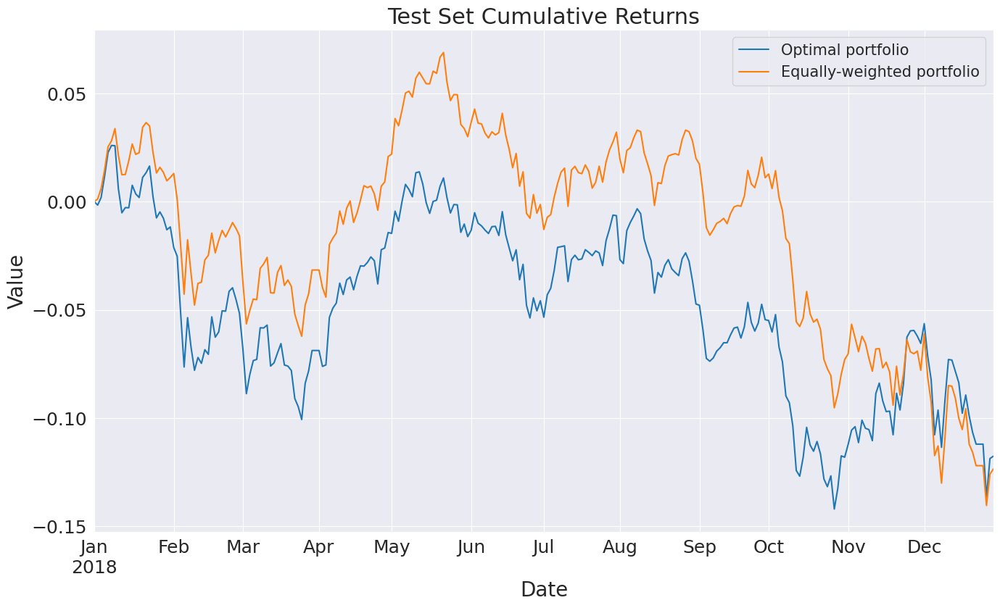

In [87]:
# Compute optimal portfolio weights from training data
cov_train = daily_returns_last_10_train.cov()
cov_train_inv = np.linalg.inv(cov_train.values)
one_matrix = np.ones((daily_returns_last_10_train.shape[1], 1))
optimal_lambda = float((1 / (one_matrix.T @ cov_train_inv @ one_matrix)))
optimal_w = optimal_lambda * (cov_train_inv @ one_matrix)
optimal_w = optimal_w.reshape(-1,)


### TEST ###
# Compute variance and cumulative return of optimal portfolio on test data
portfolio_returns_test = daily_returns_last_10_test @ optimal_w
portfolio_variance_test = np.var(portfolio_returns_test)
cumulative_return_test = portfolio_returns_test.cumsum()

# Compute variance and cumulative return of equally-weighted portfolio on test data
m = daily_returns_last_10_test.shape[1]
equally_weighted_w = np.full((m,), 1/m)
equally_weighted_returns_test = daily_returns_last_10_test @ equally_weighted_w
equally_weighted_variance_test = np.var(equally_weighted_returns_test)
equally_weighted_cumulative_return_test = equally_weighted_returns_test.cumsum()

# Compare variance and cumulative return of portfolios
print("Optimal portfolio variance on test data:", portfolio_variance_test)
print("Equally-weighted portfolio variance on test data:", equally_weighted_variance_test)
print("Optimal portfolio cumulative return on test data:", cumulative_return_test[-1])
print("Equally-weighted portfolio cumulative return on test data:", equally_weighted_cumulative_return_test[-1])

# Compare Test set theoretical and empirical variance of optimal portfolio
theoretical_variance = optimal_lambda**2 * np.linalg.inv(daily_returns_last_10_test.cov().values).sum()
empirical_variance = np.var(portfolio_returns_test)
print("Test Set Theoretical variance of optimal portfolio:", theoretical_variance)
print("Test Set Empirical variance of optimal portfolio:", empirical_variance)


# Plot cumulative returns of portfolios
cumulative_returns_df = pd.DataFrame({
    "Optimal portfolio": cumulative_return_test,
    "Equally-weighted portfolio": equally_weighted_cumulative_return_test
})
cumulative_returns_df.plot(title="Test Set Cumulative Returns")

plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Test Set Cumulative Returns')

plt.savefig(FIGURES_PATH+'min_var_portfolio_cum_returns_test.svg')
plt.show()

Optimal portfolio variance on train data: 2.8506231382651697e-05
Equally-weighted portfolio variance on train data: 3.735076882378633e-05
Optimal portfolio cumulative return on train data: 0.24906220625269074
Equally-weighted portfolio cumulative return on train data: 0.22348419999999997
Theoretical variance of optimal portfolio: 2.8616294052082795e-05
Empirical variance of optimal portfolio: 2.8506231382651697e-05


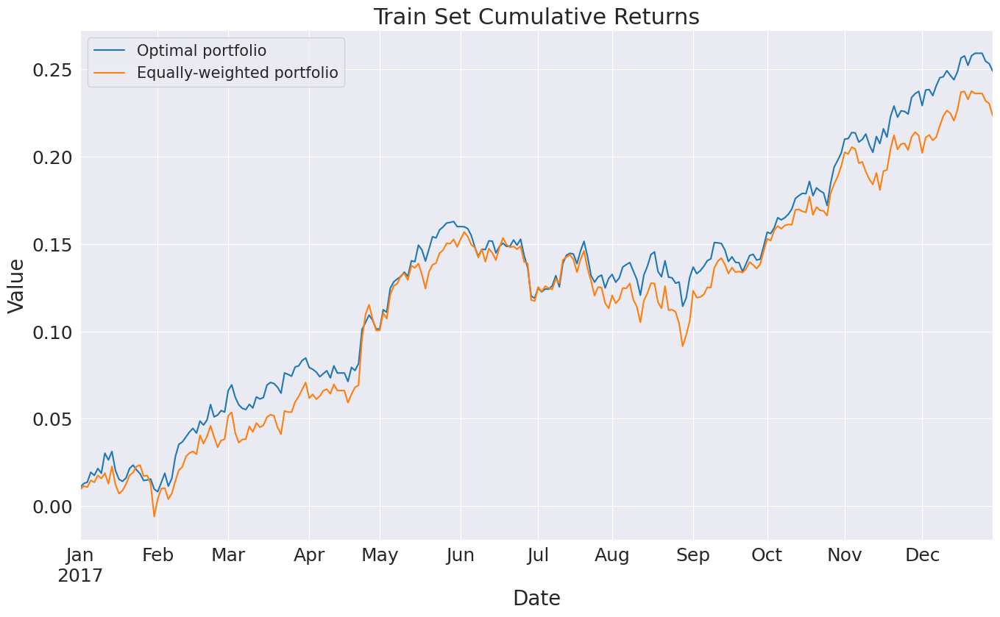

In [88]:
### TRAIN ###
# Compute variance and cumulative return of optimal portfolio on train data
portfolio_returns_train = daily_returns_last_10_train @ optimal_w
portfolio_variance_train = np.var(portfolio_returns_train)
cumulative_return_train = portfolio_returns_train.cumsum()

# Compute variance and cumulative return of equally-weighted portfolio on train data
m = daily_returns_last_10_train.shape[1]
equally_weighted_w = np.full((m,), 1/m)
equally_weighted_returns_train = daily_returns_last_10_train @ equally_weighted_w
equally_weighted_variance_train = np.var(equally_weighted_returns_train)
equally_weighted_cumulative_return_train = equally_weighted_returns_train.cumsum()

# Compare variance and cumulative return of portfolios
print("Optimal portfolio variance on train data:", portfolio_variance_train)
print("Equally-weighted portfolio variance on train data:", equally_weighted_variance_train)
print("Optimal portfolio cumulative return on train data:", cumulative_return_train[-1])
print("Equally-weighted portfolio cumulative return on train data:", equally_weighted_cumulative_return_train[-1])

# Compare theoretical and empirical variance of optimal portfolio
theoretical_variance = optimal_lambda**2 * np.linalg.inv(cov_train.values).sum()
empirical_variance = np.var(portfolio_returns_train)
print("Theoretical variance of optimal portfolio:", theoretical_variance)
print("Empirical variance of optimal portfolio:", empirical_variance)


# Plot cumulative returns of portfolios
cumulative_returns_df = pd.DataFrame({
    "Optimal portfolio": cumulative_return_train,
    "Equally-weighted portfolio": equally_weighted_cumulative_return_train
})
cumulative_returns_df.plot(title="Train Set Cumulative Returns")

plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Train Set Cumulative Returns')

plt.savefig(FIGURES_PATH+'min_var_portfolio_cum_returns_train.svg')
plt.show()

### **3.1.3**

Adaptive minimum variance portfolio:
Portfolio variance: 0.00010824146863553496
Cumulative return: 0.07477350103220962

Equally-weighted portfolio:
Portfolio variance: 8.228487692114826e-05
Cumulative return: -0.13466130000000007


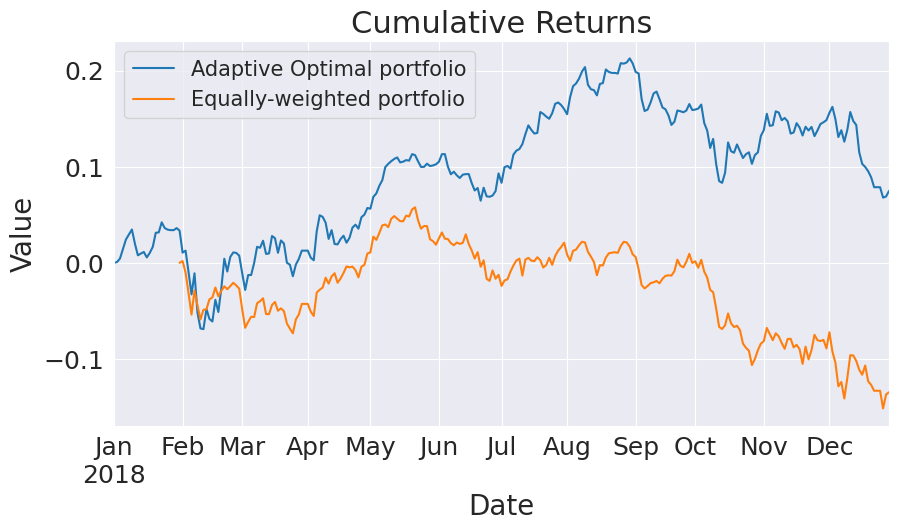

In [51]:
M = 22

portfolio_returns_adaptive = pd.Series(dtype = 'float64') 


for t in daily_returns_last_10_test.index: 
    # Compute returns, cov matrix and optimal weights.
    returns_window = daily_returns_last_10[:t].iloc[(-M-1):-1] 
    cov_matrix = returns_window.cov() 

    # Calculate optimal portfolio weights
    cov_matrix_inv = np.linalg.inv(cov_matrix)
    ones_vec = np.ones((returns_window.shape[1], 1))
    optimal_lambda = 1 / ( (ones_vec.T @ cov_matrix_inv) @ ones_vec)
    optimal_weights = optimal_lambda * ( cov_matrix_inv @ ones_vec )
    optimal_weights = optimal_weights.reshape(-1,)
    
    
    portfolio_returns_adaptive[t] = sum(daily_returns_last_10_test.loc[t] * optimal_weights)  

# Calculate portfolio variance and cumulative return
portfolio_variance_adaptive = portfolio_returns_adaptive.var()
cumulative_return_adaptive = portfolio_returns_adaptive.cumsum()

# Calculate portfolio returns using equally-weighted portfolio
weights_equally_weighted = pd.DataFrame(1/len(daily_returns_last_10_test.columns), index=daily_returns_last_10_test.index[M:], columns=daily_returns_last_10_test.columns)
portfolio_returns_equally_weighted = (weights_equally_weighted.shift(1) * daily_returns_last_10_test).sum(axis=1)
portfolio_returns_equally_weighted = portfolio_returns_equally_weighted[M:]

# Calculate portfolio variance and cumulative return
portfolio_variance_equally_weighted = portfolio_returns_equally_weighted.var()
cumulative_return_equally_weighted = portfolio_returns_equally_weighted.cumsum()

# Print results
print('Adaptive minimum variance portfolio:')
print('Portfolio variance:', portfolio_variance_adaptive)
print('Cumulative return:', cumulative_return_adaptive.iloc[-1])
print()
print('Equally-weighted portfolio:')
print('Portfolio variance:', portfolio_variance_equally_weighted)
print('Cumulative return:', cumulative_return_equally_weighted.iloc[-1])

# Plot cumulative returns of portfolios
cumulative_returns_df = pd.DataFrame({
    "Adaptive Optimal portfolio": cumulative_return_adaptive,
    "Equally-weighted portfolio": cumulative_return_equally_weighted
})

cumulative_returns_df.plot(title='Cumulative Returns', figsize=(10, 5))
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Cumulative Returns')

plt.savefig(FIGURES_PATH+'min_var_portfolio_adaptive_cum_returns.svg')
plt.show()

## **Section 4: Robust Statistics and Non-Linear Methods**

### **4.1: Data Import and Exploratory Data Analysis**

### **4.1.1**

In [52]:
df_apple = pd.read_csv(APPLE_PATH, index_col=0)
df_jpm = pd.read_csv(JPM_PATH, index_col=0)
df_ibm = pd.read_csv(IBM_PATH, index_col=0)
df_dji = pd.read_csv(DJI_PATH, index_col=0)

# Name df's
df_apple.name = 'Apple'
df_jpm.name = 'JPM'
df_ibm.name = 'IBM'
df_dji.name = 'DJI'

stock_dfs = [df_apple, df_jpm, df_ibm, df_dji]

df_apple.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2018-03-16,178.649994,179.119995,177.619995,178.020004,175.349915,39404700
2018-03-19,177.320007,177.470001,173.660004,175.300003,172.670731,33446800
2018-03-20,175.240005,176.800003,174.940002,175.240005,172.611618,19649400
2018-03-21,175.039993,175.089996,171.259995,171.270004,168.701157,36338100
2018-03-22,170.000000,172.679993,168.600006,168.850006,166.317459,41490800


In [53]:
for stock in stock_dfs:
  # descriptive statistics
  stock['ret'] = stock['Adj Close'].pct_change(1).dropna(how='any')
  stock.dropna(how='any', inplace=True, axis=0)

In [54]:
# descriptive statistics
df_apple['ret'] = df_apple['Adj Close'].pct_change(1).dropna(how='any')
df_apple.dropna(how='any', inplace=True, axis=0)
df_apple.describe()

,Open,High,Low,Close,Adj Close,Volume,ret
count,249.000000,249.000000,249.000000,249.000000,249.000000,2.490000e+02,249.000000
mean,187.764619,189.652249,185.905502,187.800723,186.271976,3.267486e+07,0.000489
std,22.217445,22.348043,22.077563,22.227239,21.965120,1.423032e+07,0.019336
min,143.979996,145.720001,142.000000,142.190002,141.582779,1.251390e+07,-0.099607
25%,171.250000,173.000000,169.699997,170.949997,170.210007,2.288540e+07,-0.008217
50%,186.350006,187.669998,184.990005,186.309998,184.411102,2.901770e+07,0.001652
75%,207.360001,209.500000,206.089996,207.990005,205.925232,3.902510e+07,0.009430
max,230.779999,233.470001,229.779999,232.070007,230.275482,9.624670e+07,0.070422


In [55]:
df_jpm['ret'] = df_jpm['Adj Close'].pct_change(1).dropna(how='any')
df_jpm.dropna(how='any', inplace=True, axis=0)
df_jpm.describe()

,Open,High,Low,Close,Adj Close,Volume,ret
count,249.000000,249.000000,249.000000,249.000000,249.000000,2.490000e+02,249.000000
mean,108.655382,109.600883,107.629679,108.555341,107.223856,1.468582e+07,-0.000102
std,5.348502,5.191853,5.420699,5.290487,4.833084,5.360335e+06,0.013105
min,92.690002,94.220001,91.110001,92.139999,91.397758,6.488400e+06,-0.044636
25%,104.519997,105.379997,103.699997,104.430000,104.110001,1.080080e+07,-0.007231
50%,109.099998,110.489998,107.779999,108.980003,107.196465,1.363300e+07,-0.000482
75%,113.199997,114.239998,112.290001,113.080002,111.152634,1.700930e+07,0.007637
max,119.129997,119.239998,118.080002,118.629997,116.856049,4.131390e+07,0.041459


In [56]:
df_ibm['ret'] = df_ibm['Adj Close'].pct_change(1).dropna(how='any')
df_ibm.dropna(how='any', inplace=True, axis=0)
df_ibm.describe()

,Open,High,Low,Close,Adj Close,Volume,ret
count,249.000000,249.000000,249.000000,249.000000,249.000000,2.490000e+02,249.000000
mean,138.282249,139.319840,137.162851,138.198916,134.768142,5.181480e+06,-0.000180
std,12.008588,11.803361,12.109713,11.934338,10.606778,3.332281e+06,0.015551
min,108.000000,111.000000,105.940002,107.570000,106.331108,1.963200e+06,-0.076282
25%,131.169998,131.899994,128.410004,130.550003,127.423546,3.420000e+06,-0.006421
50%,142.619995,143.820007,142.000000,142.690002,138.559998,4.196000e+06,0.000447
75%,146.619995,147.199997,145.539993,146.350006,141.820511,5.369100e+06,0.006727
max,158.820007,162.000000,158.509995,160.910004,153.671936,2.206370e+07,0.084639


In [57]:
df_dji['ret'] = df_dji['Adj Close'].pct_change(1).dropna(how='any')
df_dji.dropna(how='any', inplace=True, axis=0)
df_dji.describe()

,Open,High,Low,Close,Adj Close,Volume,ret
count,249.000000,249.000000,249.000000,249.000000,249.000000,2.490000e+02,249.000000
mean,25002.186928,25143.485316,24847.535454,25000.924213,25000.924213,3.314178e+08,0.000252
std,862.227335,818.300870,906.592480,862.228706,862.228706,9.216985e+07,0.010462
min,21857.730469,22339.869141,21712.529297,21792.199219,21792.199219,1.559400e+08,-0.031472
25%,24483.150391,24607.759766,24269.710938,24423.259766,24423.259766,2.697000e+08,-0.004067
50%,25033.919922,25130.820313,24883.060547,25052.830078,25052.830078,3.130100e+08,0.000417
75%,25600.300781,25692.720703,25480.859375,25598.740234,25598.740234,3.768900e+08,0.005801
max,26833.470703,26951.810547,26789.080078,26828.390625,26828.390625,9.005100e+08,0.049846


### **4.1.2**

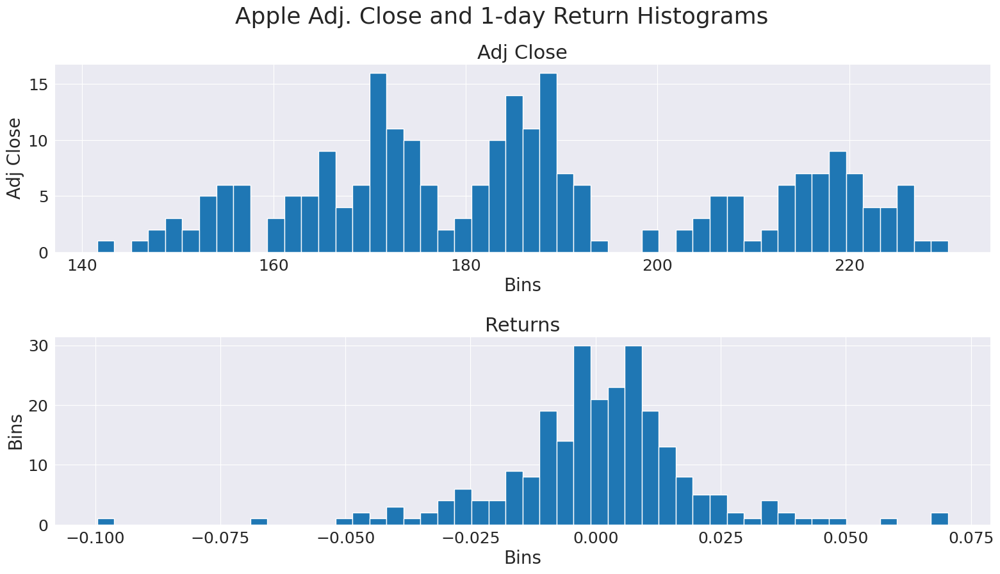

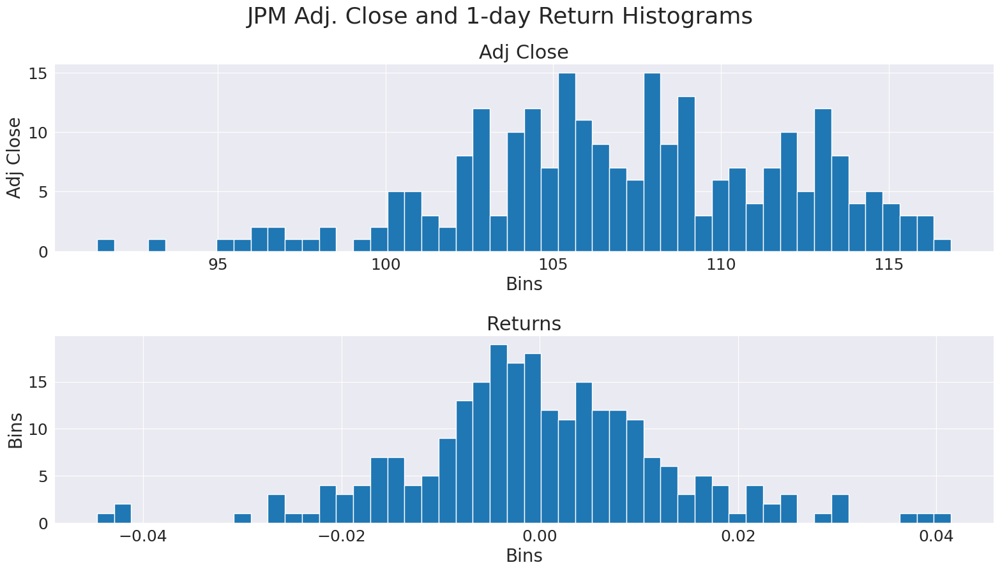

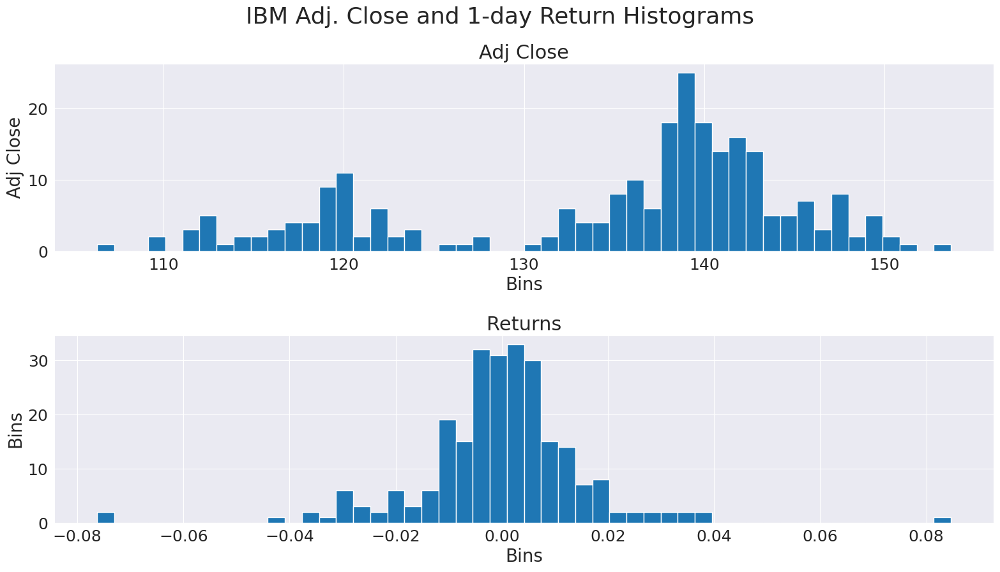

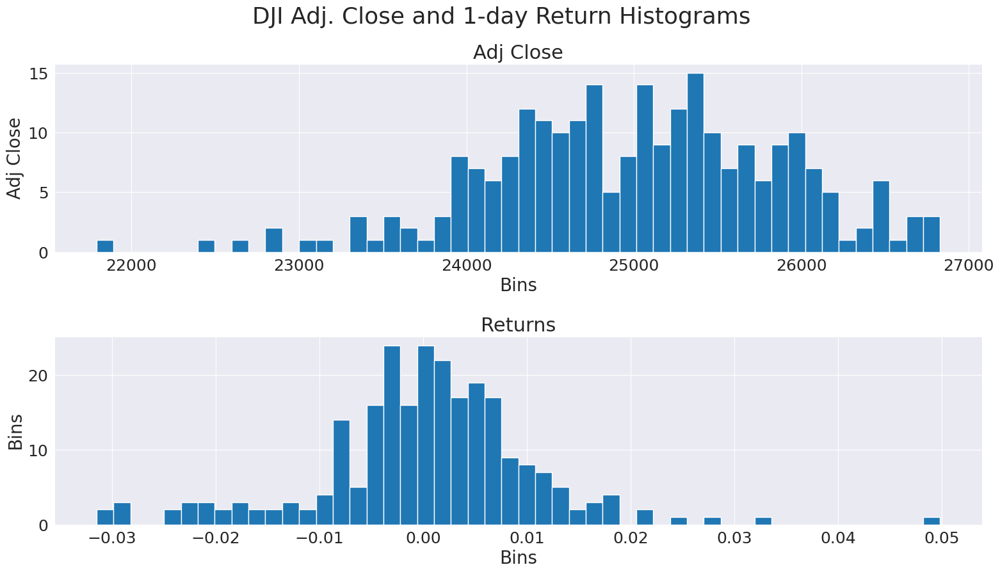

In [58]:
# Stats
for df in stock_dfs:
  fig = plt.figure()
  st = fig.suptitle(df.name + " Adj. Close and 1-day Return Histograms", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  df['Adj Close'].plot.hist(bins=50)
  ax1.set_title("Adj Close")
  ax1.set_xlabel('Bins')
  ax1.set_ylabel('Adj Close')

  ax2 = fig.add_subplot(212)
  df['ret'].plot.hist(bins=50)
  ax2.set_title("Returns")
  ax2.set_xlabel('Bins')
  ax2.set_ylabel('Bins')
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_hist_close_return.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

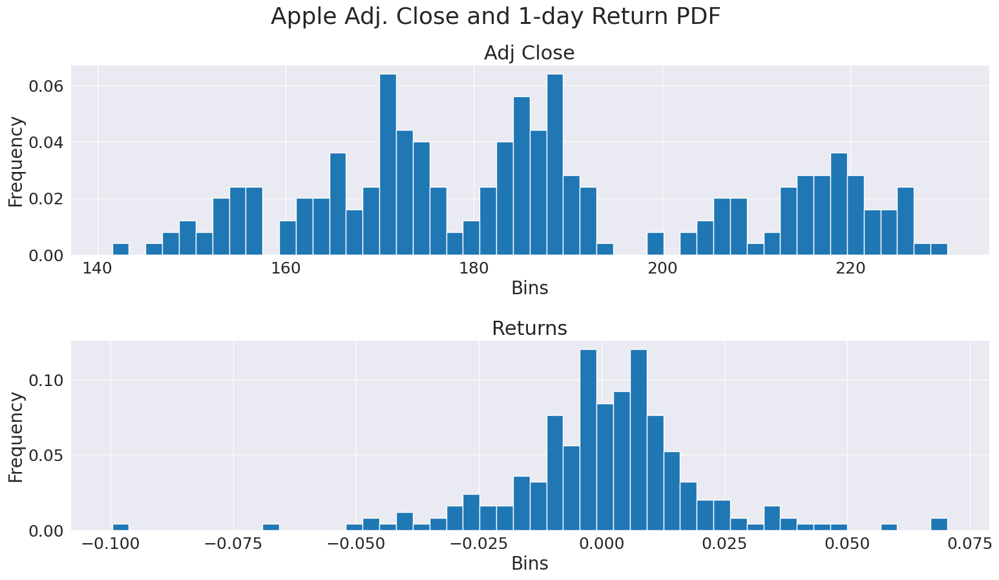

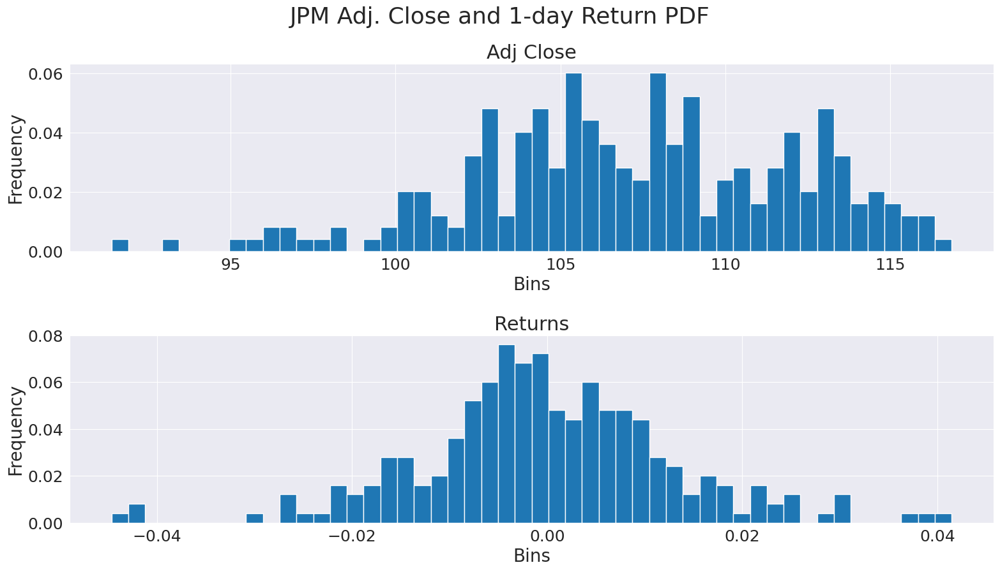

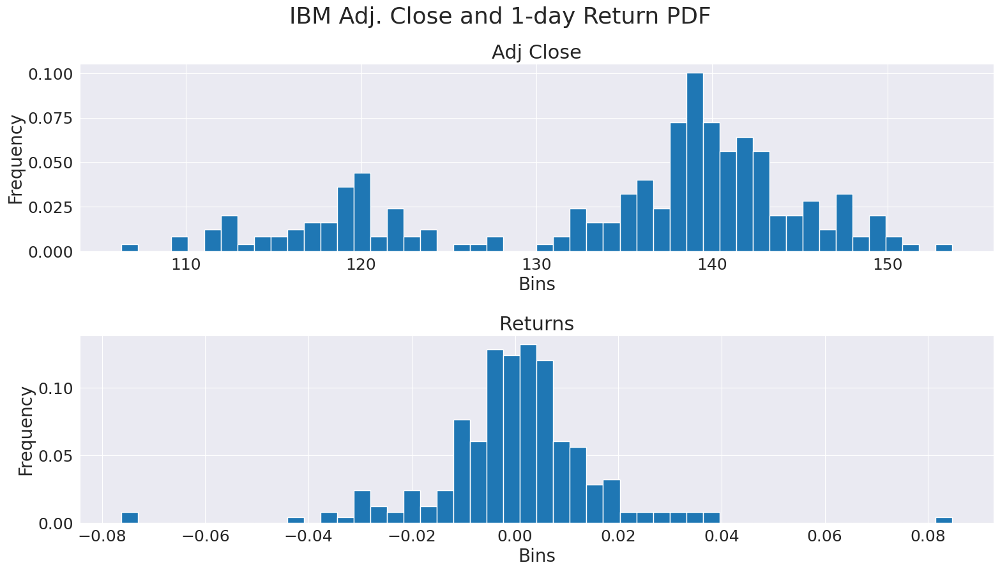

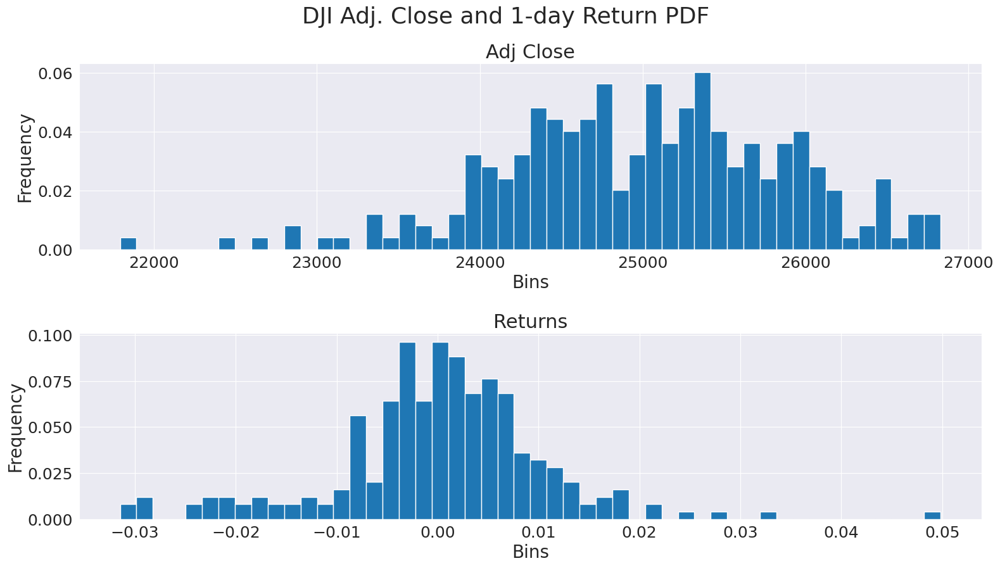

In [59]:
# Stats
for df in stock_dfs:

  fig = plt.figure()
  st = fig.suptitle(df.name +" Adj. Close and 1-day Return PDF", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  weights = np.ones_like(df['Adj Close'])/len(df)
  df['Adj Close'].plot.hist(bins=50, weights=weights)
  ax1.set_title("Adj Close")
  ax1.set_xlabel('Bins')
  ax1.set_ylabel('Frequency')

  ax2 = fig.add_subplot(212)
  weights = np.ones_like(df['ret'])/len(df)
  df['ret'].plot.hist(bins=50, weights=weights)
  ax2.set_title("Returns")
  ax2.set_xlabel('Bins')
  ax2.set_ylabel('Frequency')
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_pdf_close_return.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

 ANSWER HERE

### **4.1.3**

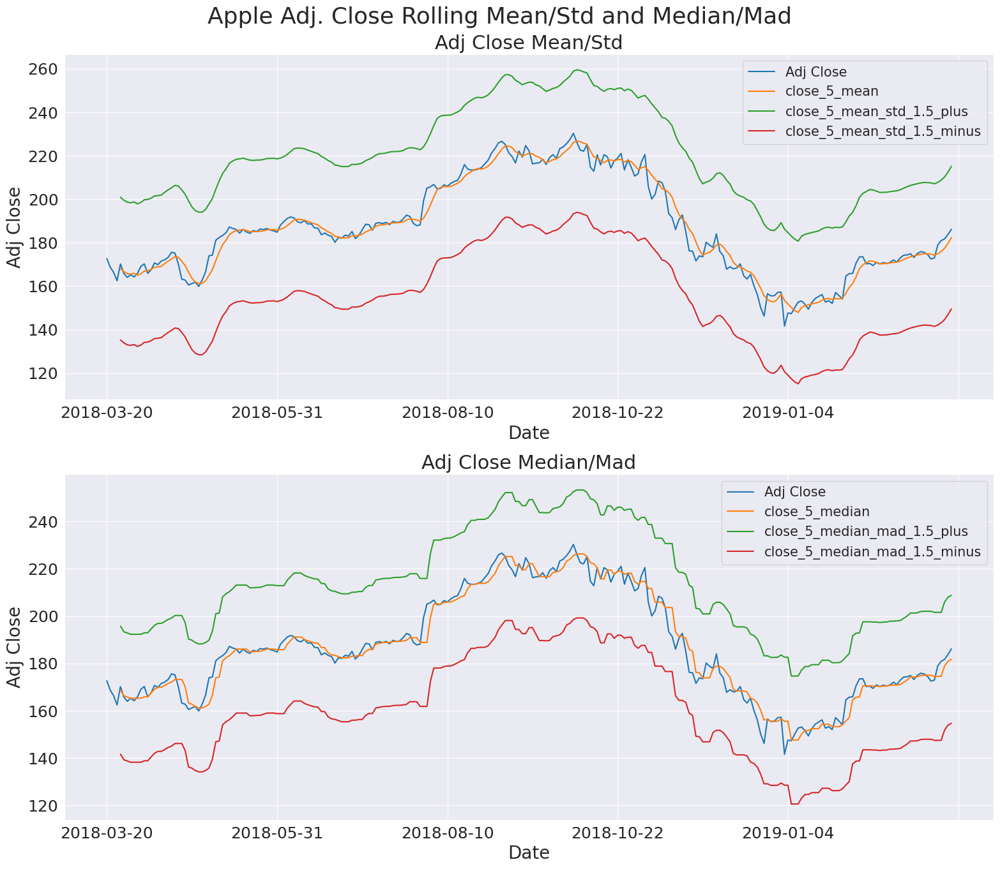

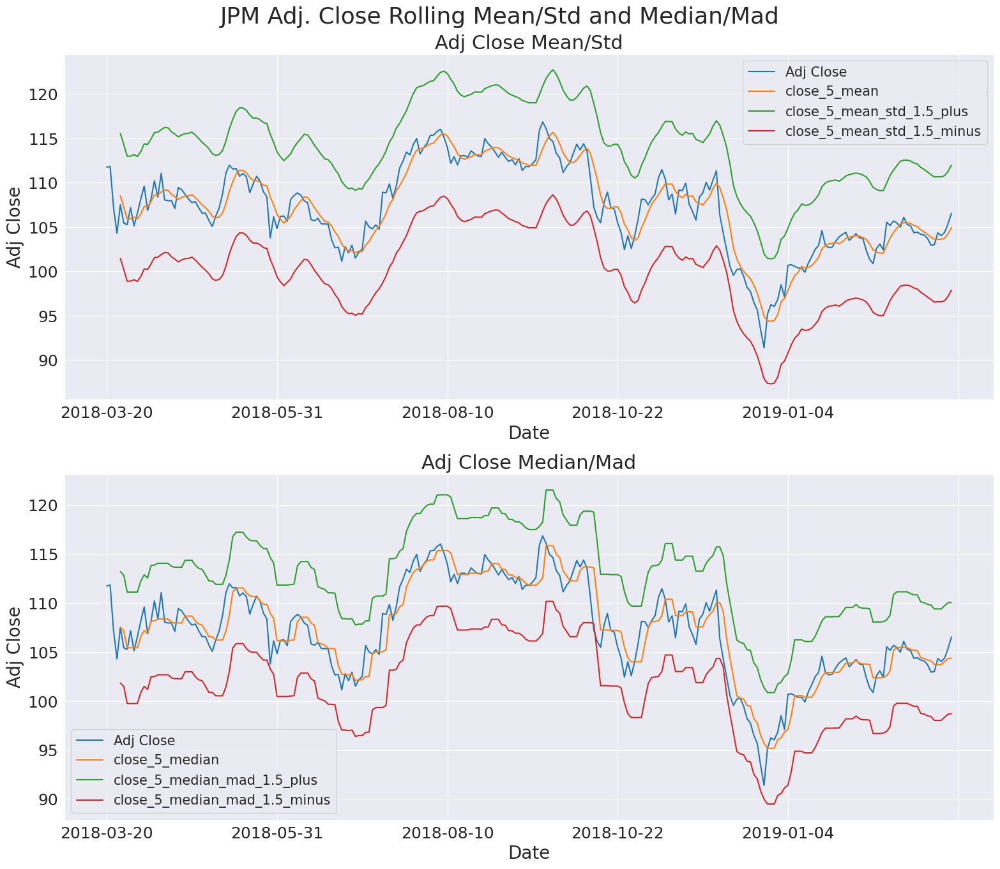

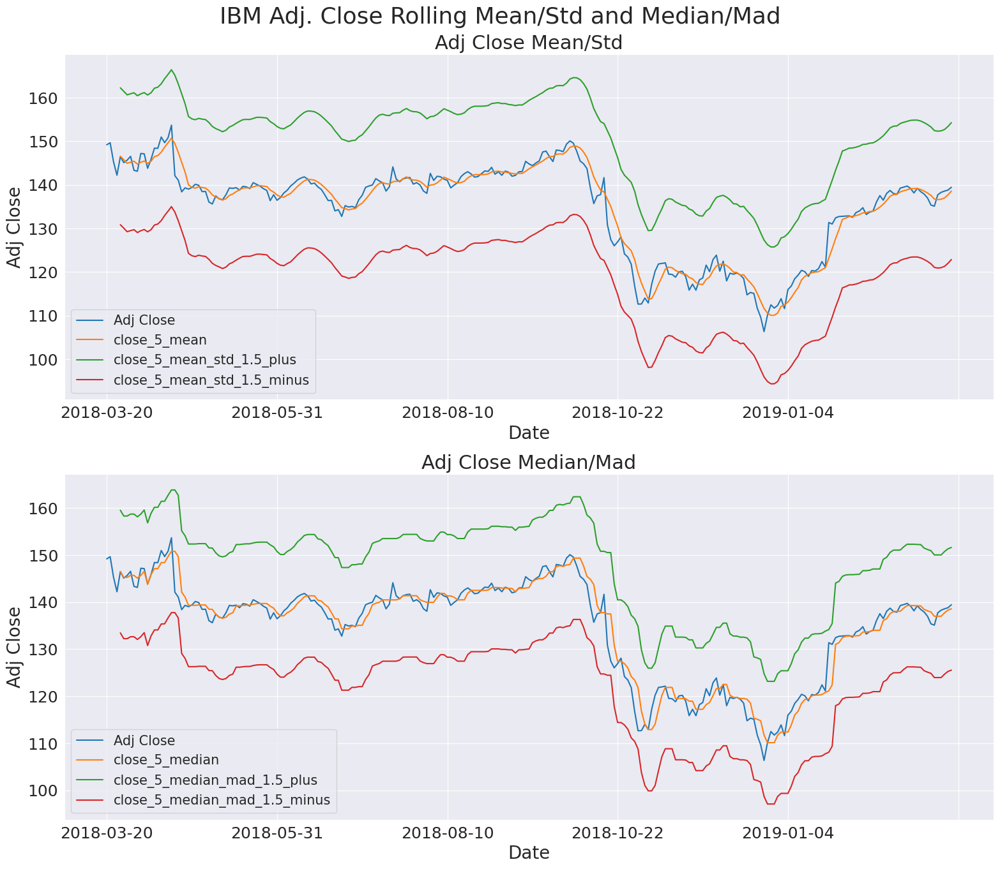

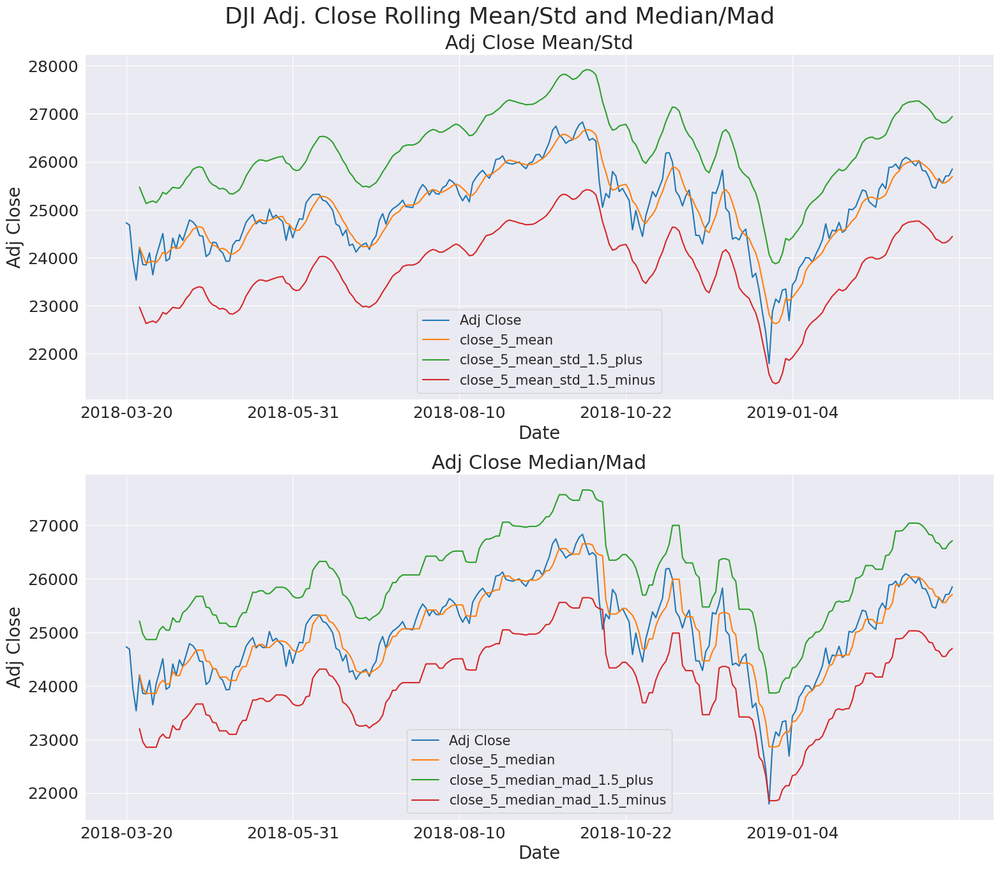

In [60]:
# Stats
stock_dfs_copy = [df.copy() for df in stock_dfs]

for i in range(len(stock_dfs)):
  stock_dfs_copy[i].name = stock_dfs[i].name


for df in stock_dfs_copy:

  fig = plt.figure(figsize=(16, 15))
  st = fig.suptitle(df.name +" Adj. Close Rolling Mean/Std and Median/Mad", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  df['Adj Close'].plot(legend=True, ax=ax1)
  df['close_5_mean'] = df['Adj Close'].rolling(5).mean().dropna()
  df['close_5_mean'].plot(legend=True, ax=ax1)

  df['close_5_mean_std'] = df['close_5_mean'].std()
  df['close_5_mean_std_1.5_plus'] = df['close_5_mean'] + df['close_5_mean_std'].multiply(1.5)
  df['close_5_mean_std_1.5_minus'] = df['close_5_mean'] - df['close_5_mean_std'].multiply(1.5)

  df['close_5_mean_std_1.5_plus'].plot(legend=True, ax=ax1)
  df['close_5_mean_std_1.5_minus'].plot(legend=True, ax=ax1)

  ax1.set_title("Adj Close Mean/Std")
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Adj Close')

  ax2 = fig.add_subplot(212)
  df['Adj Close'].plot(legend=True, ax=ax2)
  df['close_5_median'] = df['Adj Close'].rolling(5).median().dropna()
  df['close_5_median'].plot(legend=True, ax=ax2)

  df['close_5_median_mad'] = df['close_5_median'].mad()
  df['close_5_median_mad_1.5_plus'] = df['close_5_median'] + df['close_5_median_mad'].multiply(1.5)
  df['close_5_median_mad_1.5_minus'] = df['close_5_median'] - df['close_5_median_mad'].multiply(1.5)


  df['close_5_median_mad_1.5_plus'].plot(legend=True, ax=ax2)
  df['close_5_median_mad_1.5_minus'].plot(legend=True, ax=ax2)

  ax2.set_title("Adj Close Median/Mad")
  ax2.set_xlabel('Date')
  ax2.set_ylabel('Adj Close')

  fig.tight_layout()
  # shift subplots down:
  st.set_y(0.85)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_adj_rolling_std_mad.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

ANSWER HERE

### **4.1.4**

In [61]:
dates = ['2018-05-14', '2018-09-14', '2018-12-14', '2019-01-14']

stock_dfs_outliers = [df.copy() for df in stock_dfs]


for i, df in enumerate(stock_dfs_outliers):
  df.name = stock_dfs[i].name
  for t in dates:
    df.at[t, 'Adj Close'] = df.loc[t]['Adj Close'] * 1.2

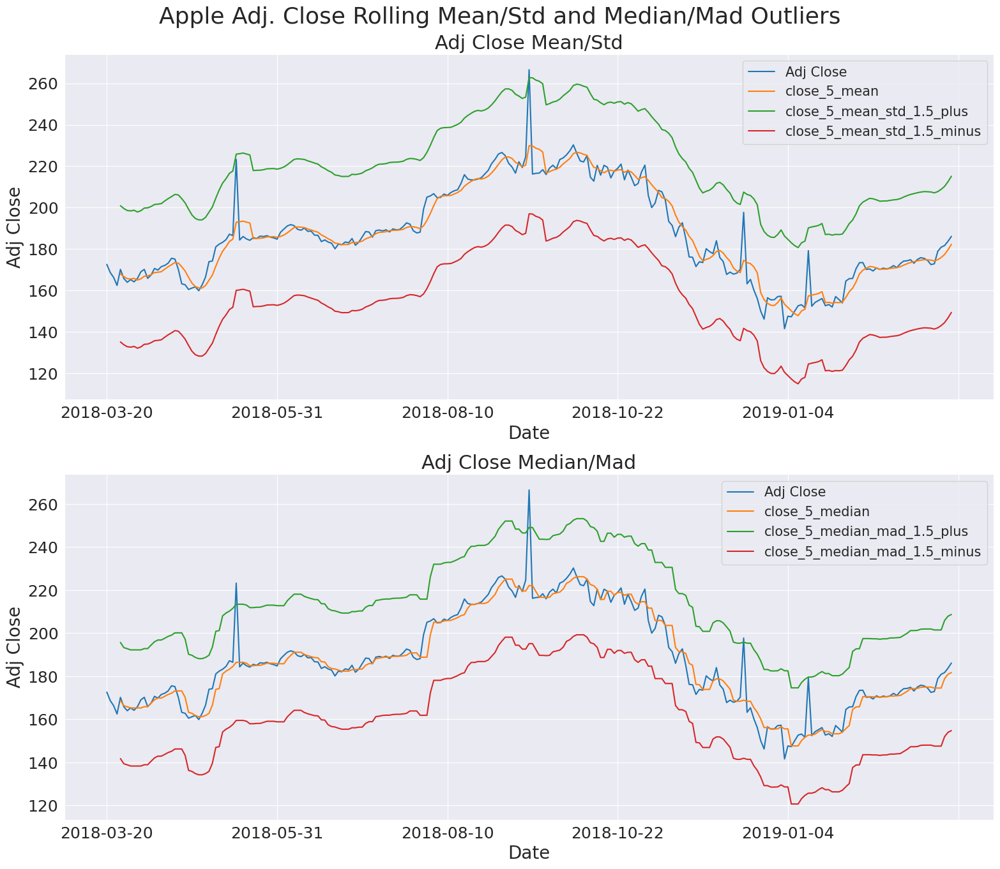

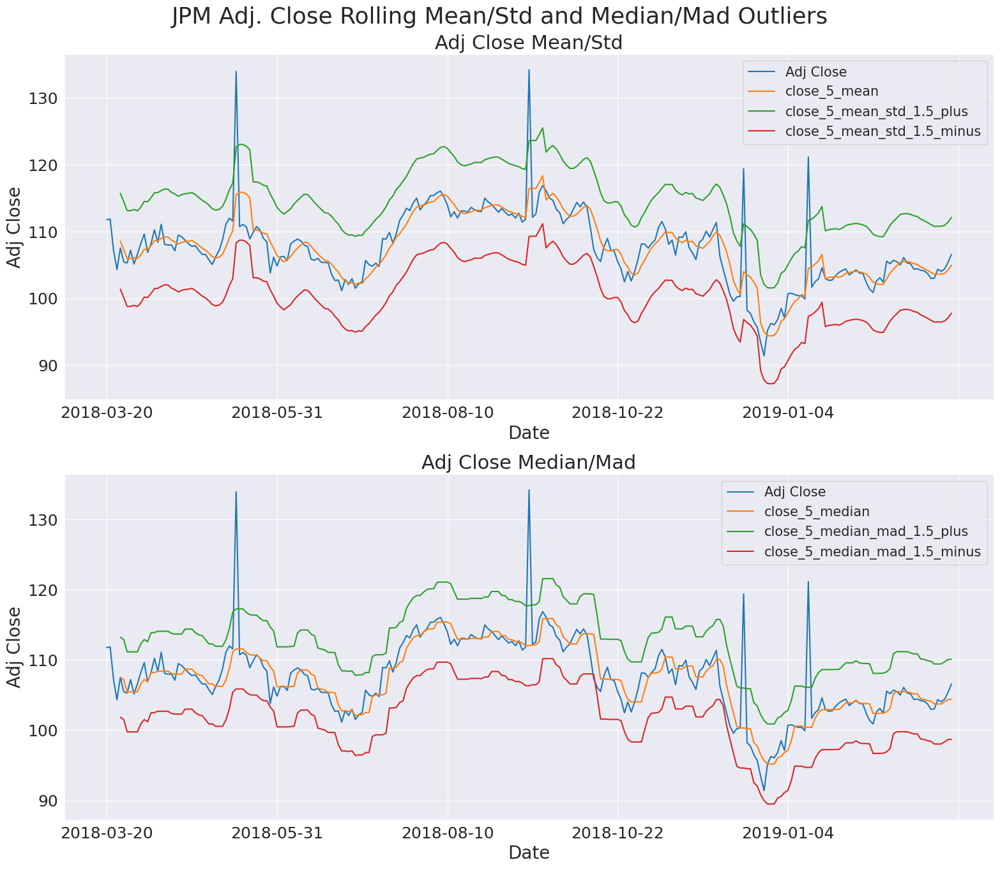

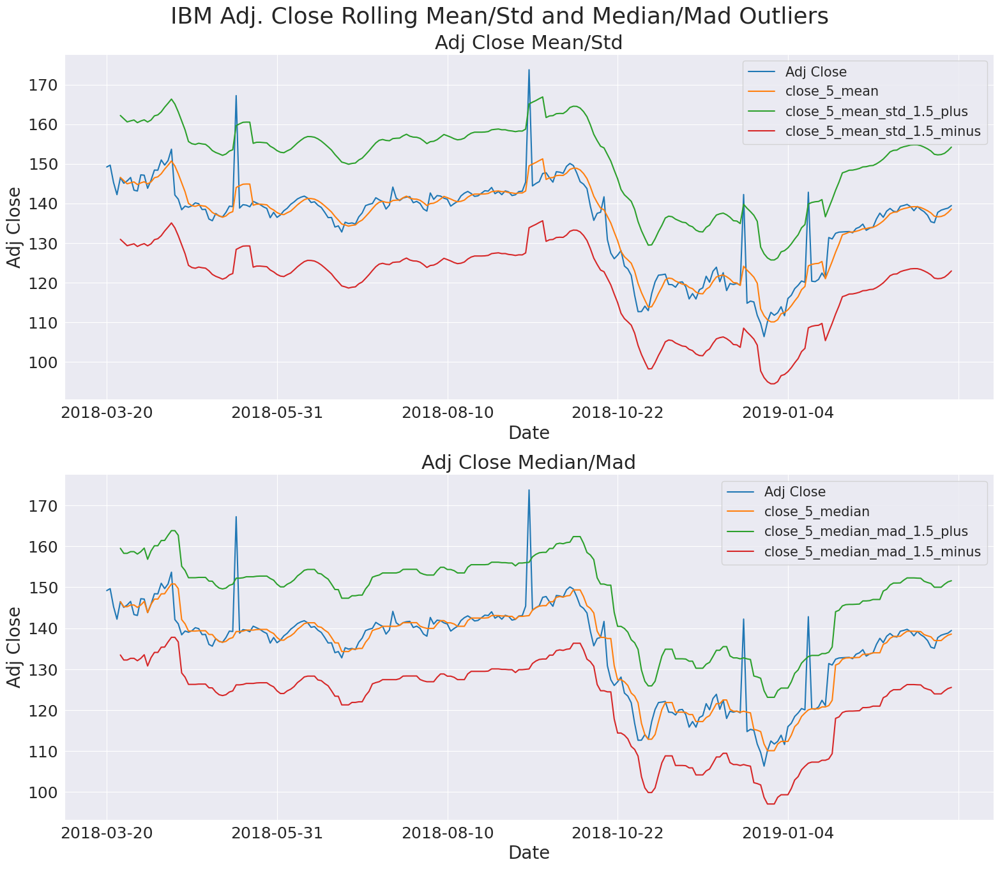

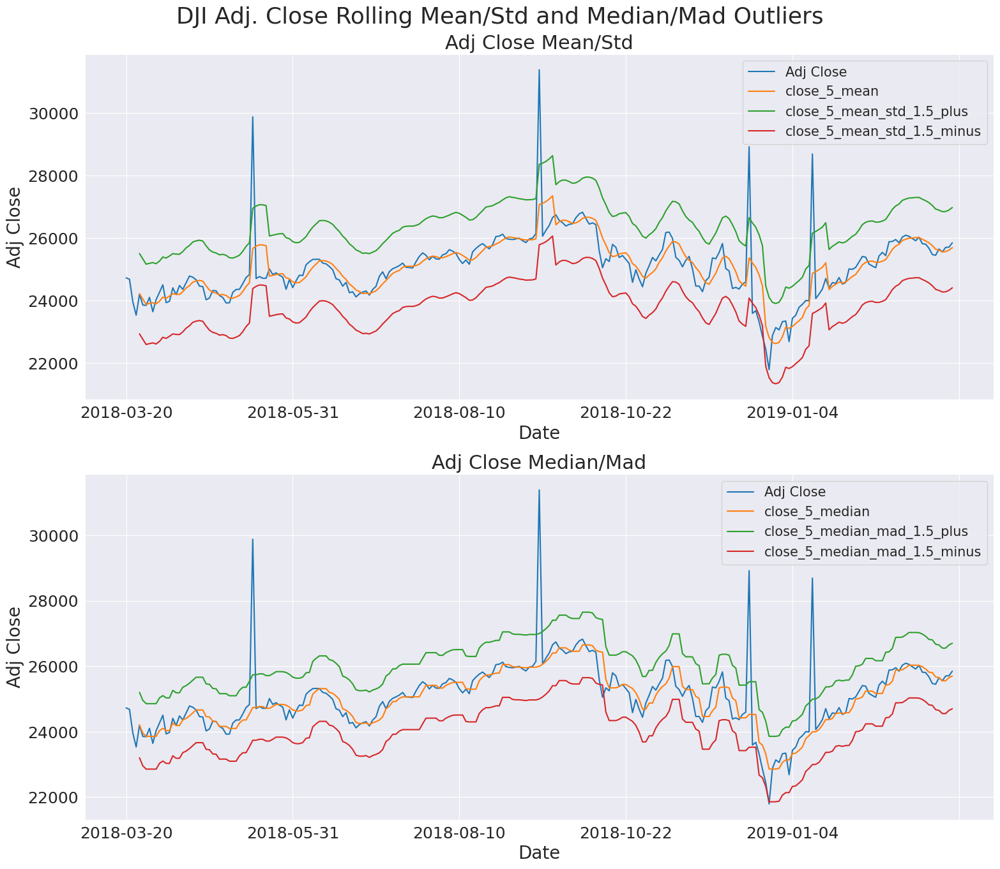

In [62]:
# Stats
for df in stock_dfs_outliers:

  fig = plt.figure(figsize=(16, 15))
  st = fig.suptitle(df.name +" Adj. Close Rolling Mean/Std and Median/Mad Outliers", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  df['Adj Close'].plot(legend=True, ax=ax1)
  df['close_5_mean'] = df['Adj Close'].rolling(5).mean().dropna()
  df['close_5_mean'].plot(legend=True, ax=ax1)

  df['close_5_mean_std'] = df['close_5_mean'].std()
  df['close_5_mean_std_1.5_plus'] = df['close_5_mean'] + df['close_5_mean_std'].multiply(1.5)
  df['close_5_mean_std_1.5_minus'] = df['close_5_mean'] - df['close_5_mean_std'].multiply(1.5)

  df['close_5_mean_std_1.5_plus'].plot(legend=True, ax=ax1)
  df['close_5_mean_std_1.5_minus'].plot(legend=True, ax=ax1)

  ax1.set_title("Adj Close Mean/Std")
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Adj Close')

  ax2 = fig.add_subplot(212)
  df['Adj Close'].plot(legend=True, ax=ax2)
  df['close_5_median'] = df['Adj Close'].rolling(5).median().dropna()
  df['close_5_median'].plot(legend=True, ax=ax2)

  df['close_5_median_mad'] = df['close_5_median'].mad()
  df['close_5_median_mad_1.5_plus'] = df['close_5_median'] + df['close_5_median_mad'].multiply(1.5)
  df['close_5_median_mad_1.5_minus'] = df['close_5_median'] - df['close_5_median_mad'].multiply(1.5)


  df['close_5_median_mad_1.5_plus'].plot(legend=True, ax=ax2)
  df['close_5_median_mad_1.5_minus'].plot(legend=True, ax=ax2)

  ax2.set_title("Adj Close Median/Mad")
  ax2.set_xlabel('Date')
  ax2.set_ylabel('Adj Close')

  fig.tight_layout()
  # shift subplots down:
  st.set_y(0.85)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_adj_rolling_std_mad_outliers.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

ANSWER HERE

### **4.1.5**

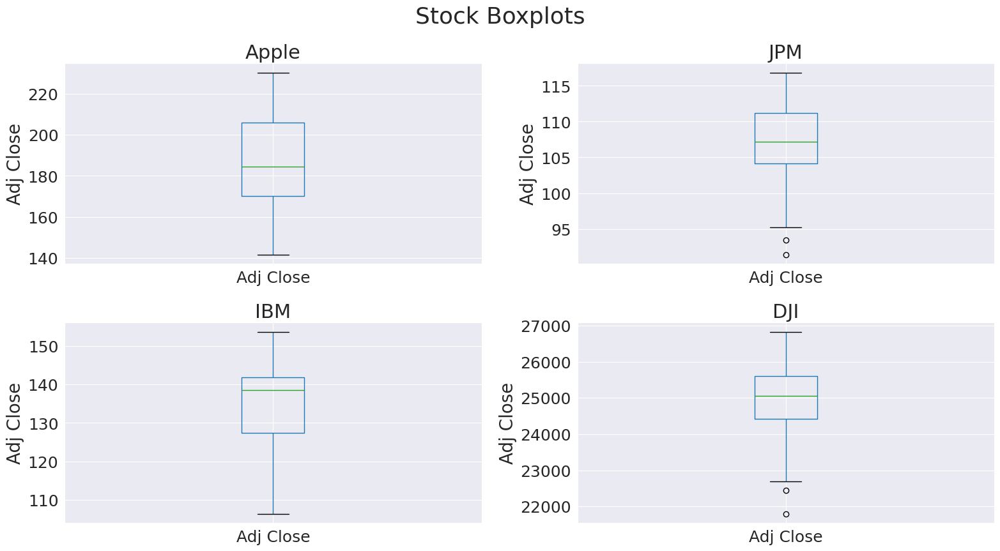

In [63]:
# Stats
fig = plt.figure()
st = fig.suptitle("Stock Boxplots", fontsize="x-large")

ax1 = fig.add_subplot(221)
stock_dfs[0].boxplot(column=['Adj Close'], ax=ax1)
ax1.set_title(stock_dfs[0].name)
ax1.set_ylabel('Adj Close')

ax2 = fig.add_subplot(222)
stock_dfs[1].boxplot(column=['Adj Close'])

ax2.set_title(stock_dfs[1].name)
ax2.set_ylabel('Adj Close')

ax3 = fig.add_subplot(223)
stock_dfs[2].boxplot(column=['Adj Close'])

ax3.set_title(stock_dfs[2].name)
ax3.set_ylabel('Adj Close')

ax4 = fig.add_subplot(224)
stock_dfs[3].boxplot(column=['Adj Close'])

ax4.set_title(stock_dfs[3].name)
ax4.set_ylabel('Adj Close')

fig.tight_layout()
# shift subplots down:
st.set_y(0.9)
fig.subplots_adjust(top=0.8, bottom=0)
fig.show()

fig.savefig(FIGURES_PATH+'stock_boxplots.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

ANSWER HERE

### **4.2: Robust Estimators**

### **4.2.1**

In [64]:
def custom_median(data):
    start_time = time.perf_counter()
    # sort data
    data = data.sort_values() 
    # if length of sequence is odd, simply take the middle value.
    # else return the average of the two middle values.
    value = 0
    if len(data) % 2 == 0:
        value =  data[int(len(data) / 2)]
    else:
        median_low  = data[int(len(data) / 2) - 1] 
        median_high = data[int(len(data) / 2)]
        value = (median_low + median_high) / 2  

    end_time = time.perf_counter()
    execution_time = end_time - start_time
    print(f"Custom median execution time is: {execution_time}")
    return value
        
def custom_iqr(data):
    start_time = time.perf_counter()
    # sort data
    data = data.sort_values() 
    
    # if length of sequence is odd, simply take the first and third quartiles.
    # else return the average of the two values around the quartiles.
    value = 0
    if len(data) % 2 == 0:
        quart1 = data[int(len(data) / 4)]
        quart3 = data[int(len(data) * 3 / 4)] 
        value = quart3 - quart1
    else:
        quart1_low = data[int(len(data) / 4) - 1]
        quart1_high = data[int(len(data) / 4)]
        quart3_low = data[int(len(data) * 3 / 4) - 1] 
        quart3_high = data[int(len(data) * 3 / 4)] 
        
        value = (quart3_high + quart3_low) / 2 - (quart1_high + quart1_low) / 2 
        
    end_time = time.perf_counter()
    execution_time = end_time - start_time
    print(f"Custom IQR execution time is: {execution_time}")
    return value    
    
def custom_mad(data):
    start_time = time.perf_counter()
    dev = abs(data - custom_median(data))

    value = custom_median(dev) 

    end_time = time.perf_counter()
    execution_time = end_time - start_time
    print(f"Custom mad execution time is: {execution_time}")
    return value

### **4.2.2**

In [65]:
robust_estimators = pd.DataFrame(columns = ['Median', 'IQR', 'MAD', 
                                     'custom_median', 'custom_iqr', 'custom_mad'], 
                          index = ['Apple', 'JPM', 'IBM', 'DJI'])

stock_dfs_copy = [df.copy() for df in stock_dfs]



for i in range(len(stock_dfs)):
  stock_dfs_copy[i].name = stock_dfs[i].name

for df in stock_dfs_copy:
  start_time = time.perf_counter()

  # Call the custom function here

  df['Adj Close'].mad()

  end_time = time.perf_counter()
  execution_time = end_time - start_time

  print(f"Pandas Function Execution time is: {execution_time}")

  robust_estimators.loc[df.name] = [df['Adj Close'].median(), iqr(df['Adj Close']), 
                           df['Adj Close'].mad(), custom_median(df['Adj Close']), 
                           custom_iqr(df['Adj Close']), custom_mad(df['Adj Close'])]

robust_estimators

Pandas Function Execution time is: 0.000858568000012383
Custom median execution time is: 0.0003454440000041359
Custom IQR execution time is: 0.0010348239999871112
Custom median execution time is: 0.0008088929999985339
Custom median execution time is: 0.0008119539999995595
Custom mad execution time is: 0.002471116000009488
Pandas Function Execution time is: 0.000764907000018411
Custom median execution time is: 0.00028666700001167555
Custom IQR execution time is: 0.0007974370000169984
Custom median execution time is: 0.000809034000013753
Custom median execution time is: 0.0008636139999964598
Custom mad execution time is: 0.002089847000007694
Pandas Function Execution time is: 0.0007256149999932404
Custom median execution time is: 0.000329936000014186
Custom IQR execution time is: 0.0007941780000066956
Custom median execution time is: 0.0007777630000020963
Custom median execution time is: 0.0008398169999850325
Custom mad execution time is: 0.0020155599999895912
Pandas Function Execution t

,Median,IQR,MAD,custom_median,custom_iqr,custom_mad
Apple,184.411102,35.715225,17.971016,184.381439,35.691315,15.577713
JPM,107.196465,7.042633,3.921722,107.189042,7.056469,3.403046
IBM,138.559998,14.396965,8.665439,138.558357,14.626244,4.433212
DJI,25052.830078,1175.480468,689.96902,25048.559571,1171.695312,595.97461


### **4.2.3**

### **4.3: Robust and OLS Regression**

### **4.3.1**

Apple R2 score 0.5152886642120589
JPM R2 score 0.5558197372784114
IBM R2 score 0.41503609219010373


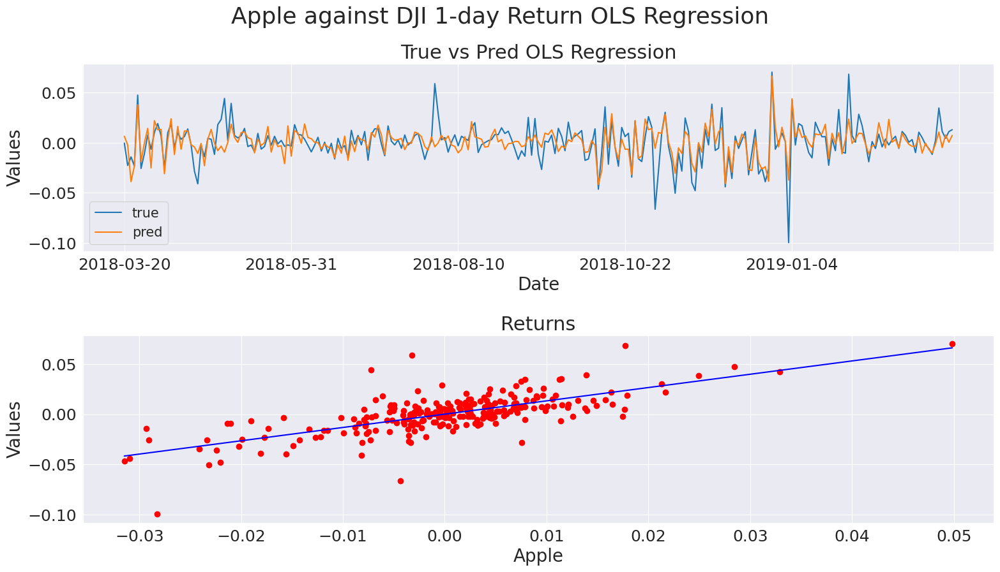

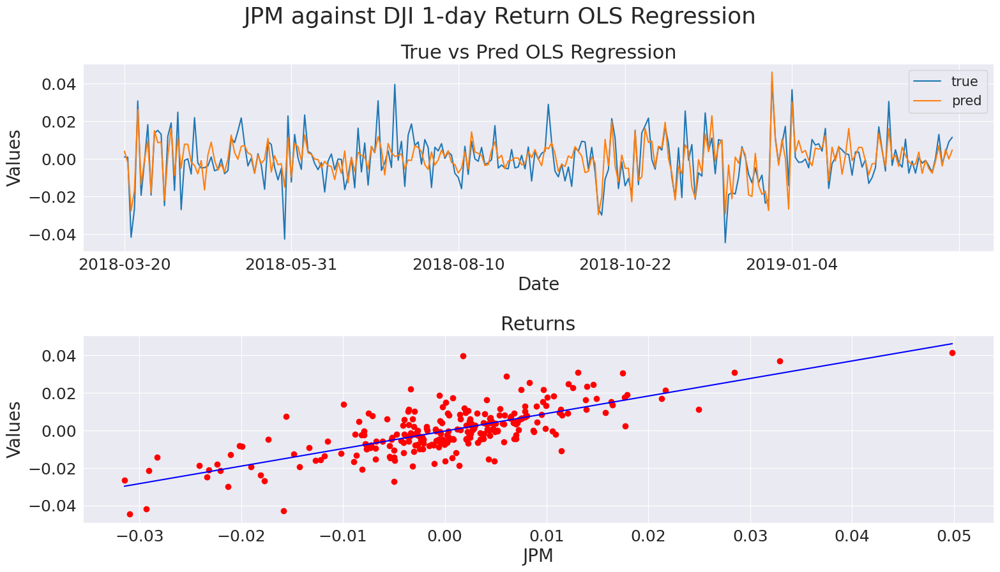

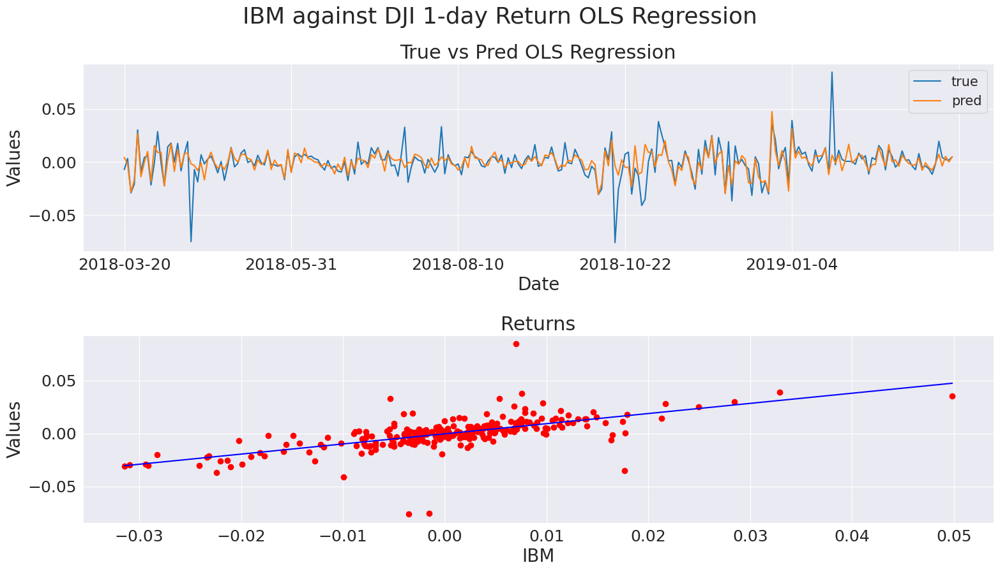

In [66]:
# Stats

stock_dfs_copy = [df.copy() for df in stock_dfs]

for i in range(len(stock_dfs)):
  stock_dfs_copy[i].name = stock_dfs[i].name

df_dji = stock_dfs_copy[3]

for df in stock_dfs_copy[0:3]:

  fig = plt.figure()
  st = fig.suptitle(df.name +" against " + df_dji.name + " 1-day Return OLS Regression", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  # OLS Regresssion
  x = df_dji['ret'].values.reshape(-1,1)
  linspace_x = np.linspace(x.min(), x.max())

  # DF
  true = df['ret'].values.reshape(-1,1)
  ols = linear_model.LinearRegression().fit(x, true)
  pred = ols.predict(x)
  coef = (ols.coef_ * linspace_x + ols.intercept_).reshape(-1,1)

  print(df.name+ " R2 score " + str(r2_score(true, pred)))

  # Convert back to df to plot
  df_ols = pd.DataFrame({'true': true.ravel(), 'pred': pred.ravel()}, index=df['ret'].index)
  df_ols.plot(ax=ax1)
  ax1.set_title("True vs Pred OLS Regression")
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Values')

  ax2 = fig.add_subplot(212)
  ax2.plot(linspace_x, coef, label='OLS Regression', color='blue')
  ax2.scatter(x, true, color='red')
  ax2.set_xlabel(df.name)
  ax2.set_ylabel('Values')
  ax2.set_title("Returns")
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_dji_ols_regression.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

### **4.3.2**

Apple R2 score 0.5141442715807596
JPM R2 score 0.5542774908539867
IBM R2 score 0.4149589125187234


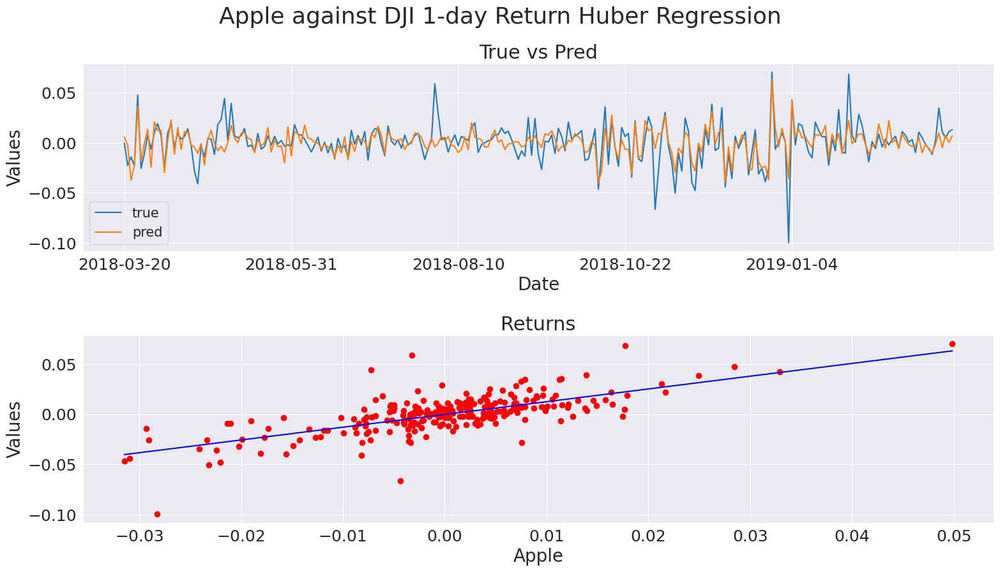

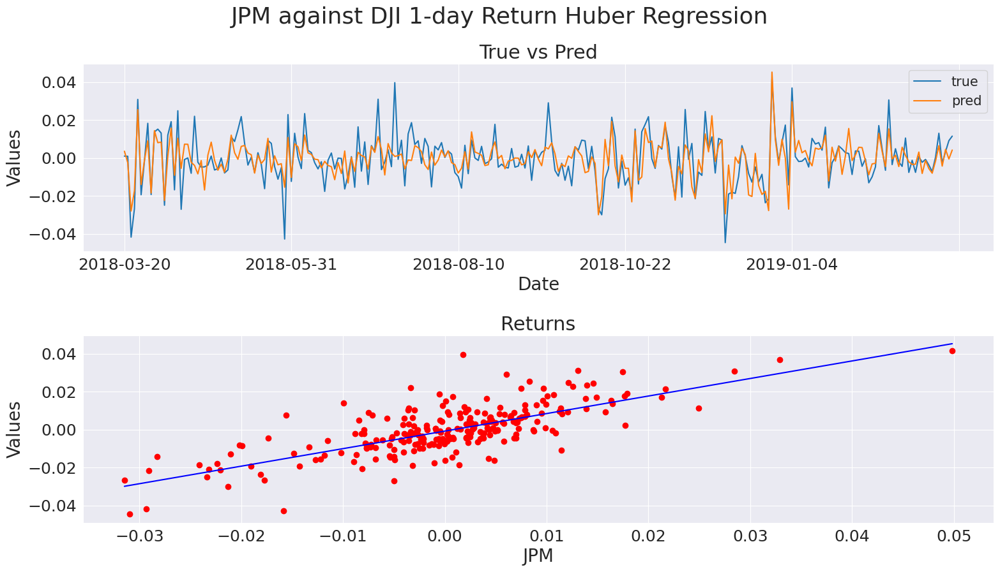

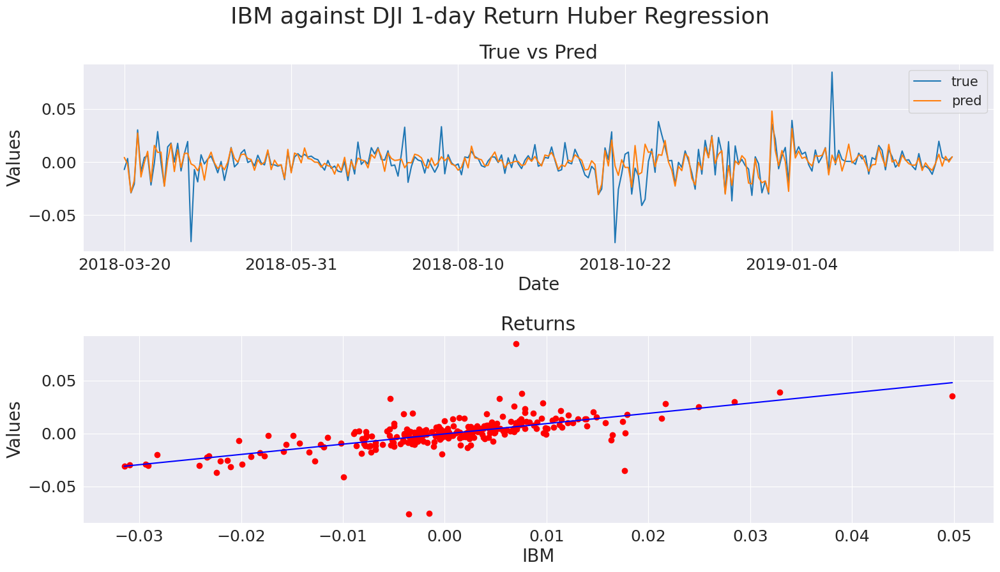

In [67]:
# Stats

stock_dfs_copy = [df.copy() for df in stock_dfs]

for i in range(len(stock_dfs)):
  stock_dfs_copy[i].name = stock_dfs[i].name

df_dji = stock_dfs_copy[3]

for df in stock_dfs_copy[0:3]: # until DJI
  fig = plt.figure()
  st = fig.suptitle(df.name + " against " + df_dji.name + " 1-day Return Huber Regression", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  # Huber Regresssion
  x = df_dji['ret'].values.reshape(-1,1)
  linspace_x = np.linspace(x.min(), x.max())

  # Apple
  true = df['ret'].values.reshape(-1,1)
  huber = linear_model.HuberRegressor().fit(x, true)
  pred = huber.predict(x)
  coef = (huber.coef_ * linspace_x + huber.intercept_).reshape(-1,1)

  print(df.name+ " R2 score " + str(r2_score(true, pred)))

  # Convert back to df to plot
  df_huber = pd.DataFrame({'true': true.ravel(), 'pred': pred.ravel()}, index=df['ret'].index)
  df_huber.plot(ax=ax1)
  ax1.set_title("True vs Pred")
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Values')

  ax2 = fig.add_subplot(212)
  ax2.plot(linspace_x, coef, label='Huber Regression', color='blue')
  ax2.scatter(x, true, color='red')
  ax2.set_xlabel(df.name)
  ax2.set_ylabel('Values')
  ax2.set_title("Returns")
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_dji_huber_regression.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

### **4.3.3**

ANSWER HERE

In [68]:
dates = ['2018-05-14', '2018-09-14', '2018-12-14', '2019-01-14']

stock_dfs_outliers = [df.copy() for df in stock_dfs]


for i, df in enumerate(stock_dfs_outliers):
  df.name = stock_dfs[i].name
  for t in dates:
    df.at[t, 'Adj Close'] = df.loc[t]['Adj Close'] * 1.2

Apple R2 score 0.5152886642120589
JPM R2 score 0.5558197372784114
IBM R2 score 0.41503609219010373


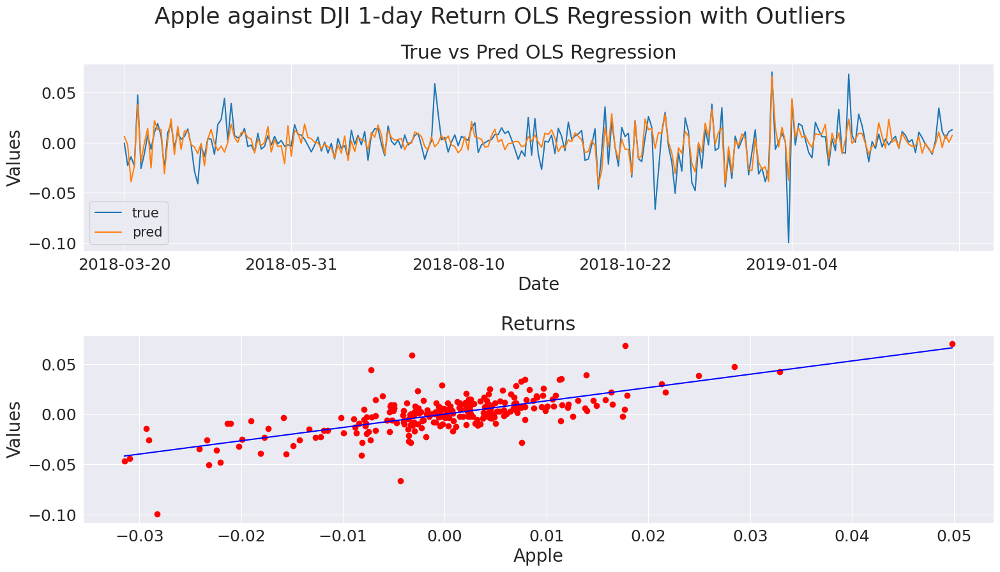

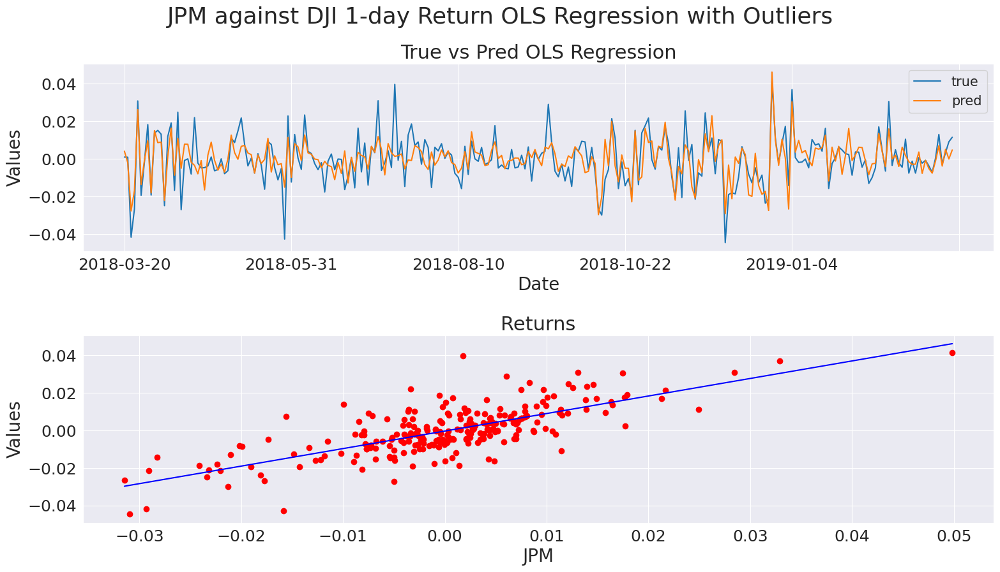

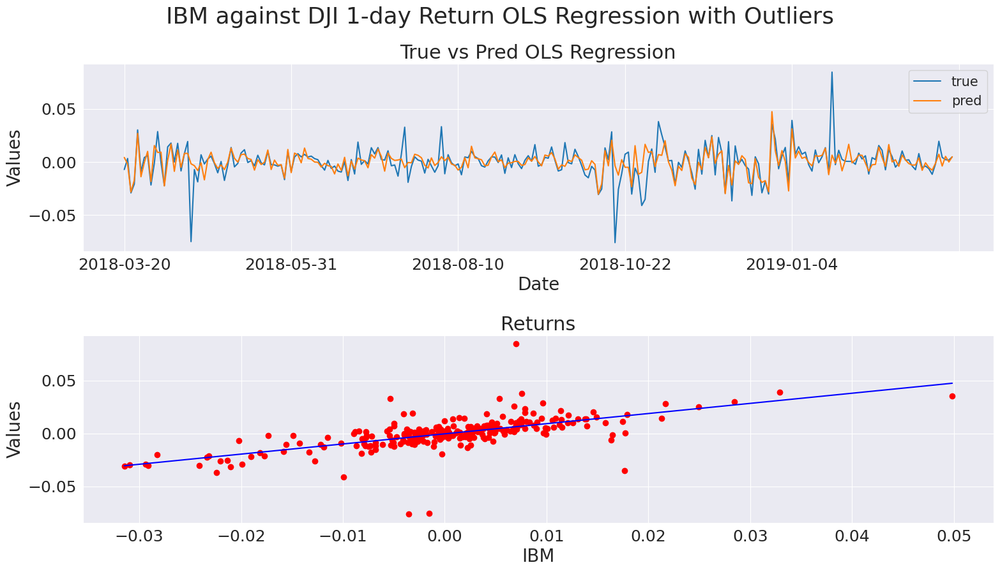

In [69]:
# Stats

for df in stock_dfs_outliers[0:3]:

  fig = plt.figure()
  st = fig.suptitle(df.name +" against " + df_dji.name + " 1-day Return OLS Regression with Outliers", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  # OLS Regresssion
  x = df_dji['ret'].values.reshape(-1,1)
  linspace_x = np.linspace(x.min(), x.max())

  # DF
  true = df['ret'].values.reshape(-1,1)
  ols = linear_model.LinearRegression().fit(x, true)
  pred = ols.predict(x)
  coef = (ols.coef_ * linspace_x + ols.intercept_).reshape(-1,1)

  print(df.name+ " R2 score " + str(r2_score(true, pred)))

  # Convert back to df to plot
  df_ols = pd.DataFrame({'true': true.ravel(), 'pred': pred.ravel()}, index=df['ret'].index)
  df_ols.plot(ax=ax1)
  ax1.set_title("True vs Pred OLS Regression")
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Values')

  ax2 = fig.add_subplot(212)
  ax2.plot(linspace_x, coef, label='OLS Regression', color='blue')
  ax2.scatter(x, true, color='red')
  ax2.set_xlabel(df.name)
  ax2.set_ylabel('Values')
  ax2.set_title("Returns")
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_dji_ols_regression_outliers.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

Apple R2 score 0.5141442715807596
JPM R2 score 0.5542774908539867
IBM R2 score 0.4149589125187234


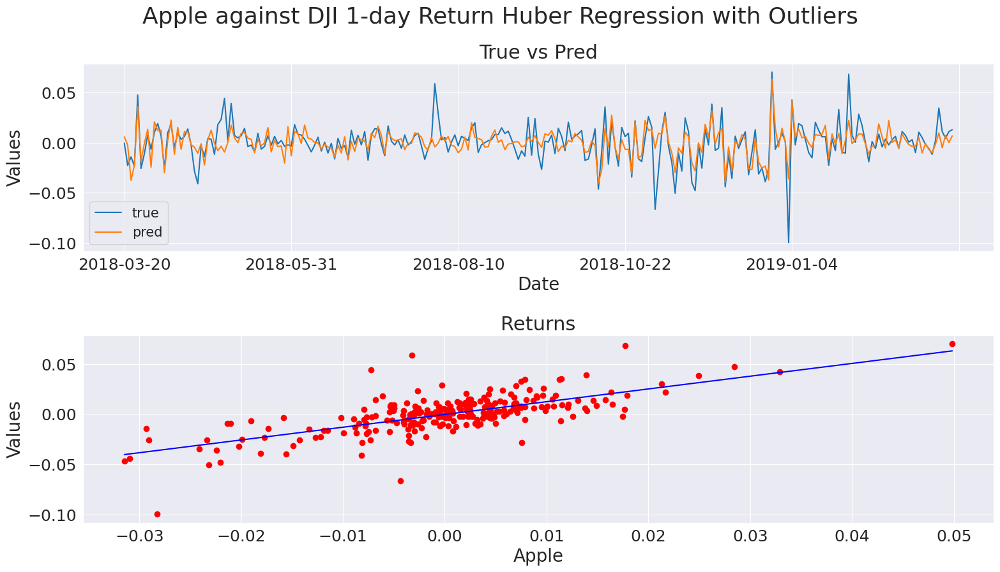

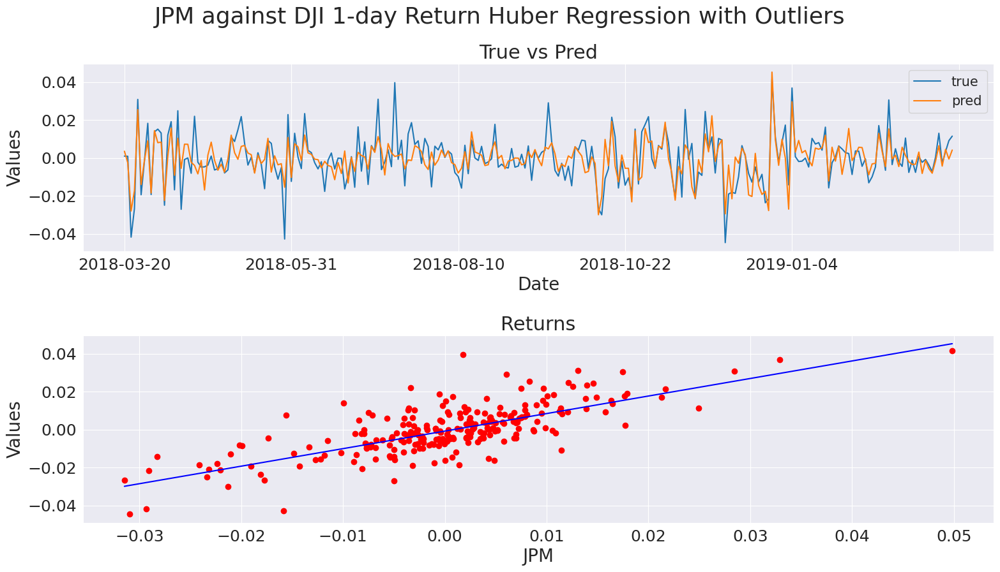

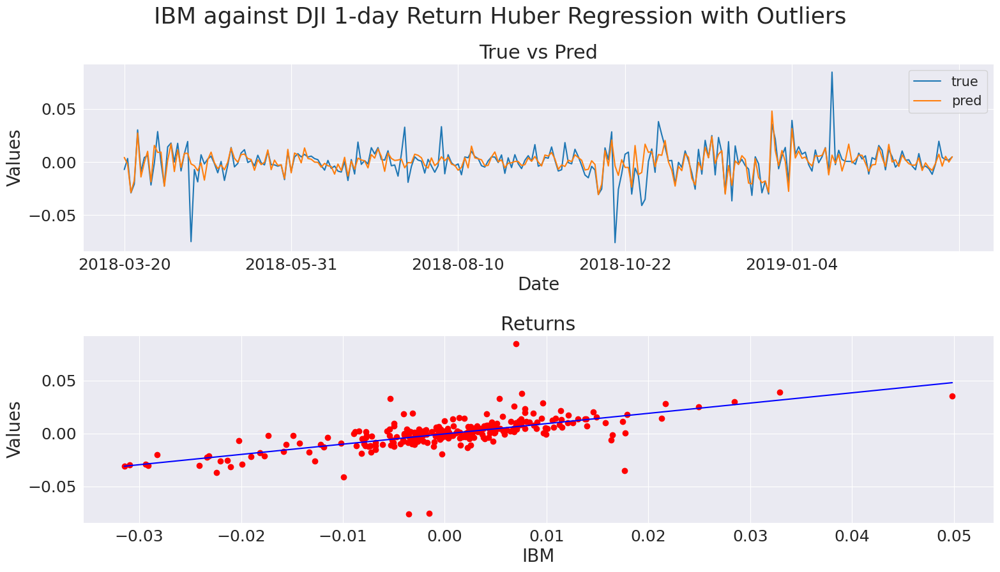

In [70]:
# Stats

for df in stock_dfs_outliers[0:3]: # until DJI
  fig = plt.figure()
  st = fig.suptitle(df.name + " against " + df_dji.name + " 1-day Return Huber Regression with Outliers", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  # Huber Regresssion
  x = df_dji['ret'].values.reshape(-1,1)
  linspace_x = np.linspace(x.min(), x.max())

  # Apple
  true = df['ret'].values.reshape(-1,1)
  huber = linear_model.HuberRegressor().fit(x, true)
  pred = huber.predict(x)
  coef = (huber.coef_ * linspace_x + huber.intercept_).reshape(-1,1)

  print(df.name+ " R2 score " + str(r2_score(true, pred)))

  # Convert back to df to plot
  df_huber = pd.DataFrame({'true': true.ravel(), 'pred': pred.ravel()}, index=df['ret'].index)
  df_huber.plot(ax=ax1)
  ax1.set_title("True vs Pred")
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Values')

  ax2 = fig.add_subplot(212)
  ax2.plot(linspace_x, coef, label='Huber Regression', color='blue')
  ax2.scatter(x, true, color='red')
  ax2.set_xlabel(df.name)
  ax2.set_ylabel('Values')
  ax2.set_title("Returns")
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_dji_huber_regression_outliers.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

### **4.4: Robust Trading Strategies**

### **4.4.1**

In [71]:
def crossover(df, corrupted=False):
  action = pd.Series(0, df.index)

  col_20 = 'adj_close_20'
  col_50 = 'adj_close_50'

  if corrupted:
    col_20 = 'adj_close_corrupted_20'
    col_50 = 'adj_close_corrupted_50'
    
  for i, t in enumerate(action.index):  
      # Bullish Crossover
      if df.iloc[i][col_20] > df.iloc[i][col_50] and df.iloc[i-1][col_20] < df.iloc[i-1][col_50]:
          
              action.iloc[i]= 1 
  
      # Bearish  Crossover
      if df.iloc[i][col_20] < df.iloc[i][col_50] and df.iloc[i-1][col_20] > df.iloc[i-1][col_50]:
          
              action.iloc[i]= -1 
              
  return action

Apple Not Corrupted
Buy dates: ['2018-07-24', '2019-02-12']
Sell dates: ['2018-07-11', '2018-10-29']
Apple Corrupted
Buy dates: ['2018-07-20', '2019-02-12']
Sell dates: ['2018-07-13', '2018-10-26']
---------------------------------------
JPM Not Corrupted
Buy dates: ['2018-07-27', '2019-02-01']
Sell dates: ['2018-06-12', '2018-09-27']
JPM Corrupted
Buy dates: ['2018-05-31', '2018-06-12', '2018-07-27', '2019-02-01']
Sell dates: ['2018-06-07', '2018-06-14', '2018-10-12']
---------------------------------------
IBM Not Corrupted
Buy dates: ['2018-07-25', '2019-01-24']
Sell dates: ['2018-10-19']
IBM Corrupted
Buy dates: ['2018-06-26', '2018-07-24', '2019-01-25']
Sell dates: ['2018-07-06', '2018-10-18']
---------------------------------------
DJI Not Corrupted
Buy dates: ['2018-07-26', '2019-01-31']
Sell dates: ['2018-07-10', '2018-10-23']
DJI Corrupted
Buy dates: ['2018-07-24', '2018-07-26', '2019-02-05']
Sell dates: ['2018-07-12', '2018-07-25', '2018-10-25']
------------------------------

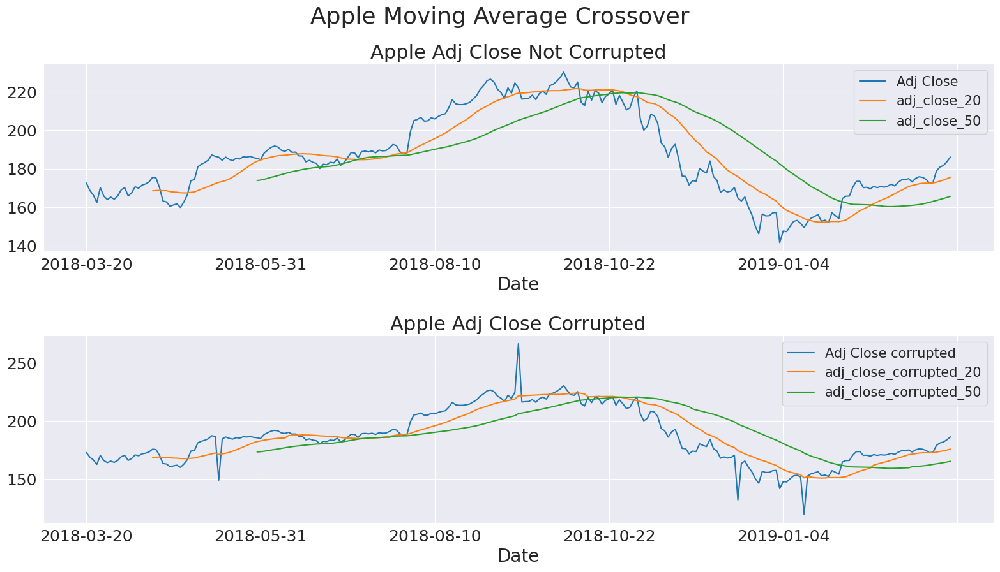

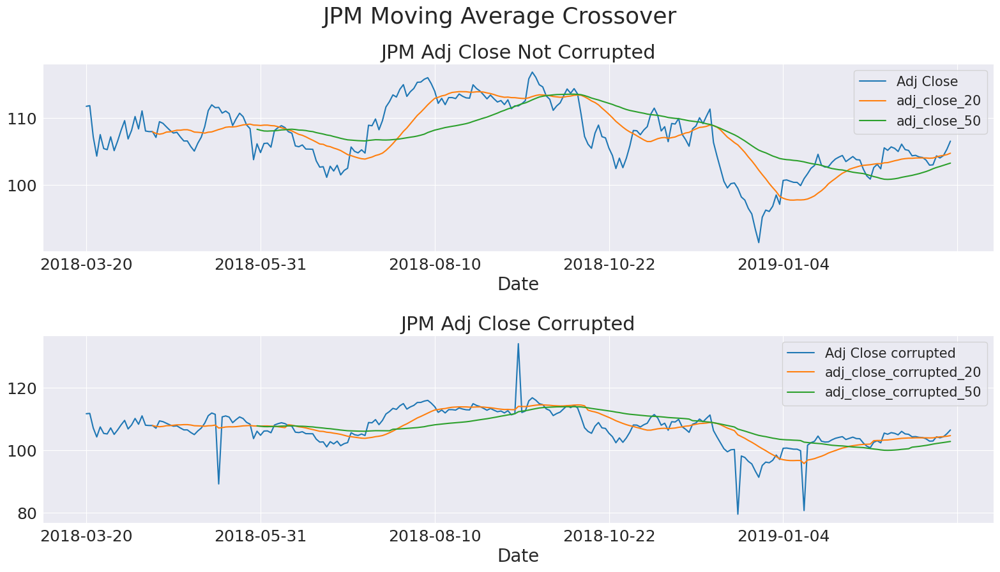

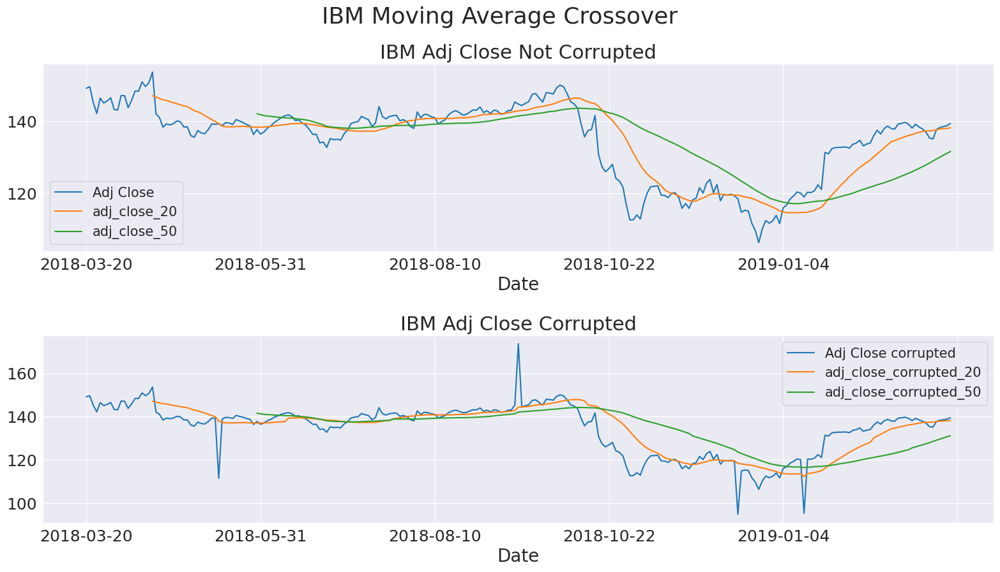

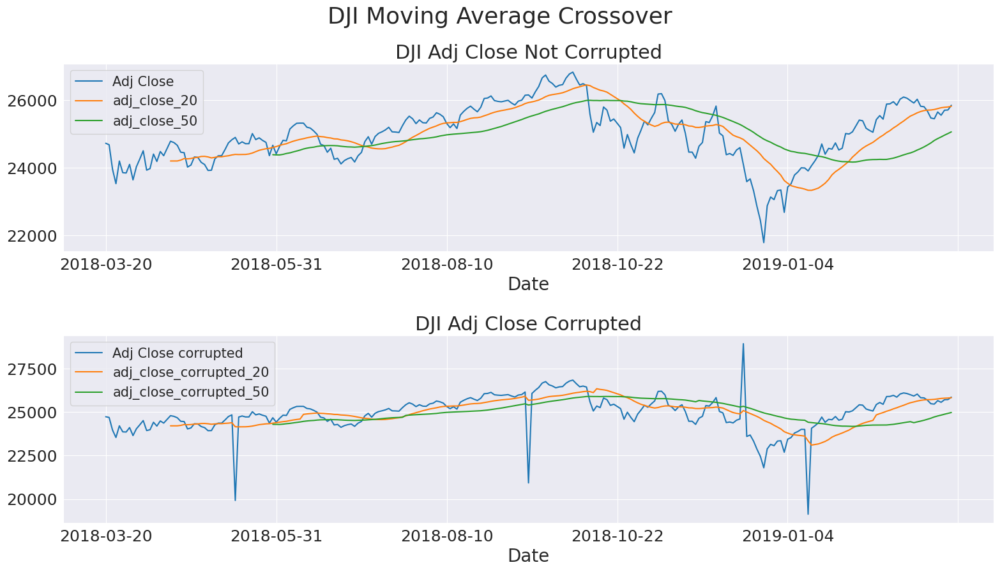

In [72]:
stock_dfs_copy = [df.copy() for df in stock_dfs]

for i in range(len(stock_dfs)):
  stock_dfs_copy[i].name = stock_dfs[i].name

for df in stock_dfs_copy:
  # Stats
  fig = plt.figure()
  st = fig.suptitle(df.name + " Moving Average Crossover", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  # Apple - No Outliers
  df['adj_close_20'] = df['Adj Close'].rolling(20).mean()
  df['adj_close_50'] = df['Adj Close'].rolling(50).mean()

  df_crossover = crossover(df, corrupted=False)

  # Print crossover values
  print(df.name +' Not Corrupted')
  print("Buy dates: {}".format(df_crossover.index[df_crossover == 1].tolist()))
  print("Sell dates: {}".format(df_crossover.index[df_crossover == -1].tolist()))

  df['Adj Close'].plot(ax=ax1, legend=True)
  df['adj_close_20'].plot(ax=ax1, legend=True)
  df['adj_close_50'].plot(ax=ax1, legend=True)
  ax1.set_title(df.name +' Adj Close Not Corrupted')

  ax2 = fig.add_subplot(212)
  # Apple - Outliers
  dates = ['2018-05-14', '2018-09-14', '2018-12-14', '2019-01-14']
  df['Adj Close corrupted'] = df['Adj Close']

  for t in df.index:
    for date in dates:
      if t == date:
        add_or_sub = np.random.randint(2)
        if add_or_sub == 1:
          df.at[t,'Adj Close corrupted'] = df.loc[t]['Adj Close'] + (df.loc[t]['Adj Close']*0.2)
        else:
          df.at[t,'Adj Close corrupted'] = df.loc[t]['Adj Close'] - (df.loc[t]['Adj Close']*0.2)

  df['adj_close_corrupted_20'] = df['Adj Close corrupted'].rolling(20).mean()
  df['adj_close_corrupted_50'] = df['Adj Close corrupted'].rolling(50).mean()

  df_crossover = crossover(df, corrupted=True)
  # Print crossover values
  print(df.name + ' Corrupted')
  print("Buy dates: {}".format(df_crossover.index[df_crossover == 1].tolist()))
  print("Sell dates: {}".format(df_crossover.index[df_crossover == -1].tolist()))
  print("---------------------------------------")

  df['Adj Close corrupted'].plot(ax=ax2, legend=True)
  df['adj_close_corrupted_20'].plot(ax=ax2, legend=True)
  df['adj_close_corrupted_50'].plot(ax=ax2, legend=True)
  ax2.set_title(df.name +' Adj Close Corrupted')
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_moving_avg_crossover.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

### **4.4.2**

Apple Not Corrupted
Buy dates: ['2018-07-23', '2019-02-12']
Sell dates: ['2018-07-03', '2018-10-29']
Apple Corrupted
Buy dates: ['2018-07-23', '2019-02-12']
Sell dates: ['2018-07-03', '2018-10-29']
----------------------------------------------
JPM Not Corrupted
Buy dates: ['2018-07-27', '2018-10-09', '2019-01-30']
Sell dates: ['2018-06-15', '2018-09-17', '2018-10-18', '2018-12-12']
JPM Corrupted
Buy dates: ['2018-07-27', '2018-10-09', '2018-12-14']
Sell dates: ['2018-06-15', '2018-09-17', '2018-10-18', '2018-12-12', '2018-12-17']
----------------------------------------------
IBM Not Corrupted
Buy dates: ['2018-06-13', '2018-07-24']
Sell dates: ['2018-06-20', '2018-10-23']
IBM Corrupted
Buy dates: ['2018-07-24', '2019-01-24']
Sell dates: ['2018-06-20', '2018-10-23']
----------------------------------------------
DJI Not Corrupted
Buy dates: ['2018-07-24', '2019-02-01']
Sell dates: ['2018-07-05', '2018-10-24']
DJI Corrupted
Buy dates: ['2018-07-24', '2019-02-01']
Sell dates: ['2018-07-

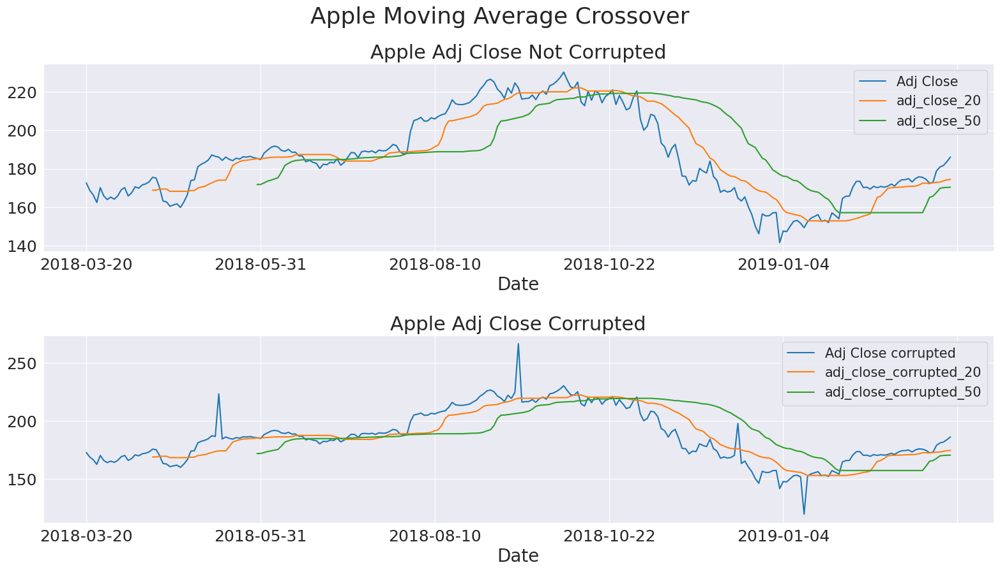

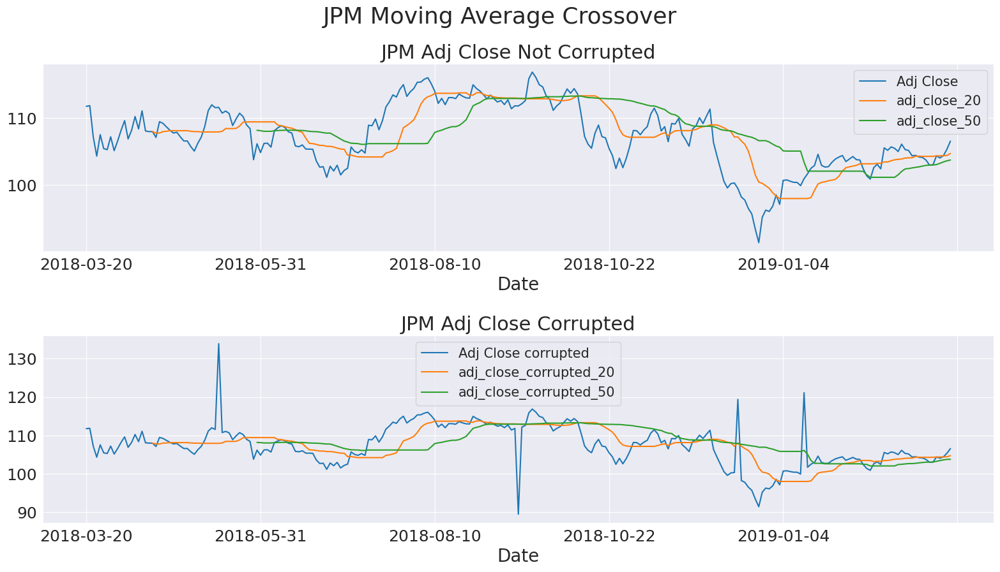

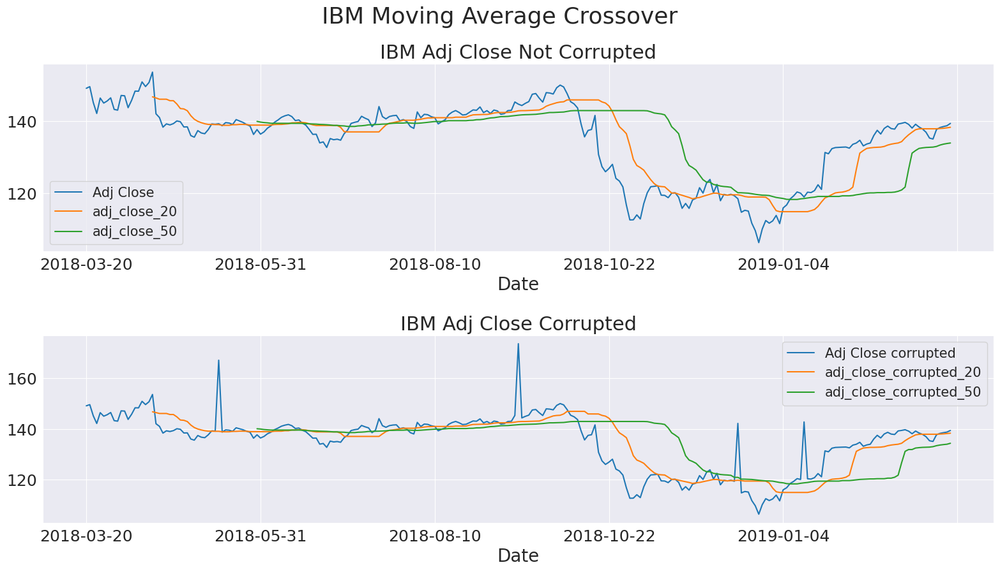

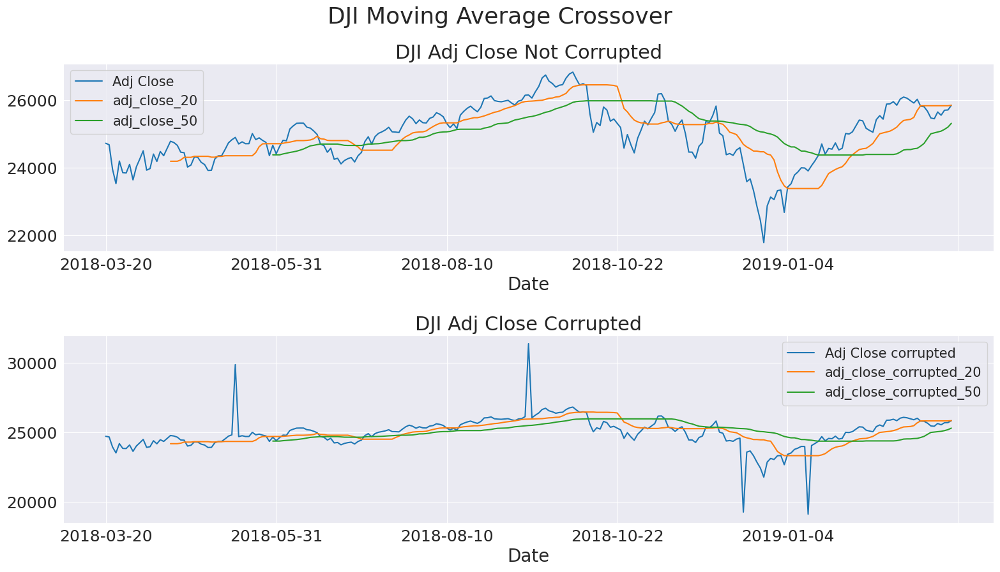

In [73]:
stock_dfs_copy = [df.copy() for df in stock_dfs]

for i in range(len(stock_dfs)):
  stock_dfs_copy[i].name = stock_dfs[i].name

for df in stock_dfs_copy:
  # Stats
  fig = plt.figure()
  st = fig.suptitle(df.name + " Moving Average Crossover", fontsize="x-large")

  ax1 = fig.add_subplot(211)
  # Apple - No Outliers
  df['adj_close_20'] = df['Adj Close'].rolling(20).median()
  df['adj_close_50'] = df['Adj Close'].rolling(50).median()

  df_crossover = crossover(df, corrupted=False)

  # Print crossover values
  print(df.name +' Not Corrupted')
  print("Buy dates: {}".format(df_crossover.index[df_crossover == 1].tolist()))
  print("Sell dates: {}".format(df_crossover.index[df_crossover == -1].tolist()))

  df['Adj Close'].plot(ax=ax1, legend=True)
  df['adj_close_20'].plot(ax=ax1, legend=True)
  df['adj_close_50'].plot(ax=ax1, legend=True)
  ax1.set_title(df.name +' Adj Close Not Corrupted')

  ax2 = fig.add_subplot(212)
  # Apple - Outliers
  dates = ['2018-05-14', '2018-09-14', '2018-12-14', '2019-01-14']
  df['Adj Close corrupted'] = df['Adj Close']

  for t in df.index:
    for date in dates:
      if t == date:
        add_or_sub = np.random.randint(2)
        if add_or_sub == 1:
          df.loc[t,'Adj Close corrupted'] = df.loc[t]['Adj Close'] + (df.loc[t]['Adj Close']*0.2)
        else:
          df.loc[t,'Adj Close corrupted'] = df.loc[t]['Adj Close'] - (df.loc[t]['Adj Close']*0.2)

  df['adj_close_corrupted_20'] = df['Adj Close corrupted'].rolling(20).median()
  df['adj_close_corrupted_50'] = df['Adj Close corrupted'].rolling(50).median()

  df_crossover = crossover(df, corrupted=True)
  # Print crossover values
  print(df.name + ' Corrupted')
  print("Buy dates: {}".format(df_crossover.index[df_crossover == 1].tolist()))
  print("Sell dates: {}".format(df_crossover.index[df_crossover == -1].tolist()))
  print("----------------------------------------------")

  df['Adj Close corrupted'].plot(ax=ax2, legend=True)
  df['adj_close_corrupted_20'].plot(ax=ax2, legend=True)
  df['adj_close_corrupted_50'].plot(ax=ax2, legend=True)
  ax2.set_title(df.name +' Adj Close Corrupted')
  fig.tight_layout()

  # shift subplots down:
  st.set_y(0.9)
  fig.subplots_adjust(top=0.8, bottom=0)
  fig.show()

  fig.savefig(FIGURES_PATH+df.name+'_moving_median_crossover.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])

ANSWER HERE

### **Section 5: Graphs in Finance**

### **5.1**

In [74]:
df = pd.read_csv(SNP_ALLSTOCKS_2015_2019_PATH)
df = df.set_index("Date")

info = pd.read_csv(SNP_INFO_PATH)
info.drop(columns=info.columns[0], inplace=True)

# CHOOSE TOP 10 ASSETS THAT HAVE THE BIGGEST PCT CHANGE IN MARKET CAP
# Subtract the first row from the last row
result = abs(df.tail(1).values - df.head(1).values) / df.head(1).values

# Convert the result to a DataFrame with the same columns as the original DataFrame
result = pd.DataFrame(result, columns=df.columns)

# Sort the columns by the first row values in descending order
sorted_cols = result.iloc[0].sort_values(ascending=False).index.tolist()

sorted_cols[0:9]

['BHF', 'ABMD', 'AMD', 'NVDA', 'NFLX', 'AMZN', 'ALGN', 'TTWO', 'ANET']

In [75]:
growth_stocks_by_industry = []
industries = []

for stock in sorted_cols:
  stock_info = info.loc[info['Symbol'] == stock]

  if stock_info.iloc[0]['GICS Sector'] not in industries:
    growth_stocks_by_industry.append(stock)
    industries.append(stock_info.iloc[0]['GICS Sector'])

  if len(industries) == 10:
    break

print(growth_stocks_by_industry)
print(industries)

['BHF', 'ABMD', 'AMD', 'NFLX', 'AMZN', 'CPRT', 'MKC', 'NEM', 'AWK', 'KMI']
['Financials', 'Health Care', 'Information Technology', 'Communication Services', 'Consumer Discretionary', 'Industrials', 'Consumer Staples', 'Materials', 'Utilities', 'Energy']


In [76]:
chosen_stocks = df[growth_stocks_by_industry].dropna()

chosen_stocks.name = 'chosen_stocks'

chosen_log_ret_df = np.log(chosen_stocks).diff().dropna()

chosen_log_ret_df.name = 'chosen_stocks_log_ret'

chosen_log_ret_df.head()

,BHF,ABMD,AMD,NFLX,AMZN,CPRT,MKC,NEM,AWK,KMI
Date,,,,,,,,,,
2015-01-05,0.000000,-0.006453,-0.003752,-0.052238,-0.020731,-0.009890,-0.017048,0.006186,-0.015507,-0.027470
2015-01-06,0.000000,-0.025684,-0.011342,-0.017269,-0.023098,-0.011384,-0.004549,0.040781,0.002633,-0.019884
2015-01-07,0.000000,0.031333,-0.019195,0.005178,0.010544,0.003067,0.026319,-0.008920,0.012689,0.013139
2015-01-08,0.000000,0.044078,0.011561,0.021946,0.006813,0.010248,0.016286,-0.005490,0.003886,0.023176
2015-01-09,1.098612,-0.014218,0.007634,-0.015578,-0.011818,-0.004696,-0.011855,0.036368,0.002951,-0.012597


In [77]:
chosen_log_ret_df.describe()

,BHF,ABMD,AMD,NFLX,AMZN,CPRT,MKC,NEM,AWK,KMI
count,487.000000,487.000000,487.000000,487.000000,487.000000,487.000000,487.000000,487.000000,487.000000,487.000000
mean,0.019778,0.004445,0.003970,0.003451,0.003250,0.001972,0.001299,0.001197,0.001069,-0.002102
std,0.477977,0.039731,0.077280,0.030323,0.027408,0.027718,0.013352,0.037552,0.016343,0.024573
min,-1.609438,-0.213226,-0.190518,-0.110780,-0.081424,-0.143712,-0.053604,-0.268332,-0.055000,-0.194278
25%,-0.010273,-0.008490,-0.017251,-0.011537,-0.006643,-0.006197,-0.005734,-0.010209,-0.005480,-0.010218
50%,0.000000,0.003016,0.001724,0.001415,0.001904,0.001775,0.001028,0.000000,0.001096,-0.000722
75%,0.007481,0.017042,0.021935,0.017899,0.012248,0.008614,0.007825,0.009657,0.007639,0.007719
max,9.385973,0.427730,1.480847,0.214442,0.336310,0.488318,0.103238,0.594726,0.251259,0.245928


### **5.2**

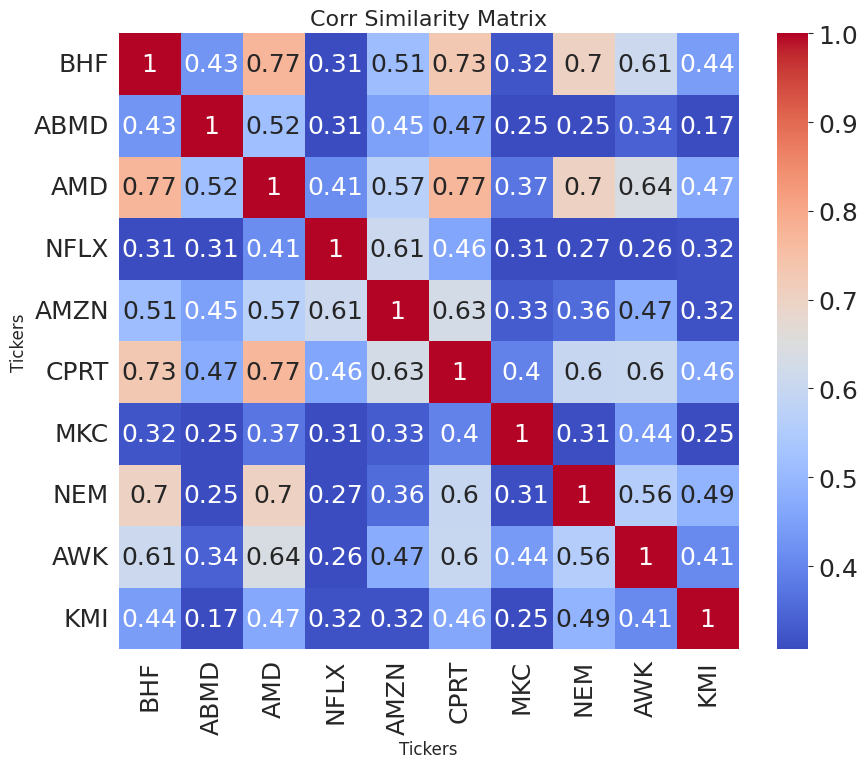

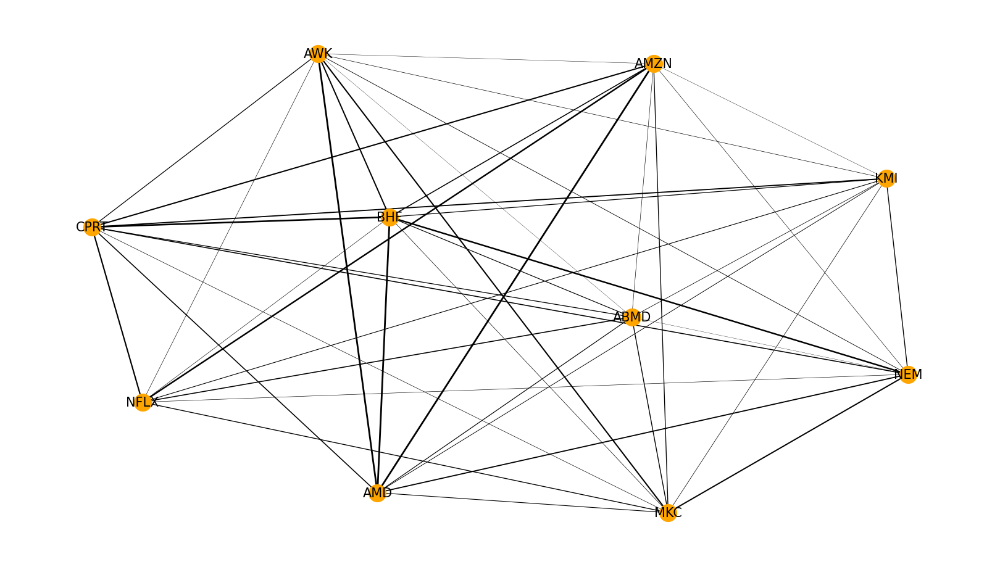

In [78]:
def create_correlation_graph(df, plot=True, graph=True):

      matrix = df.corr()

      if plot:
        plt.figure(figsize=(10, 8))
        sns.heatmap(matrix, annot=True, cmap='coolwarm', vmin=matrix.iloc[0].min(), vmax=matrix.iloc[0].max())
        plt.title('Corr Similarity Matrix', fontsize=16)
        plt.xlabel('Tickers', fontsize=12)
        plt.ylabel('Tickers', fontsize=12)

        plt.savefig(FIGURES_PATH+df.name+'_corr_heatmap.svg',bbox_inches='tight')
        plt.show()

      if graph:
        # Transform it in a links data frame (3 columns only):
        links = matrix.stack().reset_index()
        links.columns = ['var1', 'var2', 'value']

        # Keep only correlation over a threshold and remove self correlation (cor(A,A)=1)
        links_filtered=links.loc[(links['var1'] != links['var2'])]

        # Normalize the weights to the range [0, 1]
        min_weight = links_filtered['value'].min()
        max_weight = links_filtered['value'].max()
        links_filtered['normalized_value'] = (links_filtered['value'] - min_weight) / (max_weight - min_weight)
        
        # Build your graph
        G = nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')
    
        # Plot the network:
        nx.draw(G, with_labels=True, node_color='orange', node_size=400, edge_color='black', linewidths=1, font_size=15, width=links_filtered['normalized_value']*2)

        plt.savefig(FIGURES_PATH+df.name+'_corr_graph.svg', bbox_inches='tight')
    
      return G

G = create_correlation_graph(chosen_log_ret_df)

### **5.3**

ANSWER HERE

### **5.4**

#### Euclidean

In [79]:
def timeseries_euclidean(df, plot=False):

  euclidean_matrix = pd.DataFrame(columns=df.columns, index=df.columns)
  for col1 in df.columns:
      for col2 in df.columns:
          euclidean_matrix.loc[col1, col2] = np.sqrt(np.sum((df[col1] - df[col2]) ** 2))

  euclidean_matrix = euclidean_matrix.astype(float)
  euclidean_matrix = euclidean_matrix.dropna()

  if plot:
    plt.figure(figsize=(10, 8))
    sns.heatmap(euclidean_matrix, annot=True, cmap='coolwarm', vmin=0, vmax=1)
    plt.title('Euclidean Matrix', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Columns', fontsize=12)
    fig.savefig(FIGURES_PATH+'stocks_euc_similarity.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])
    plt.show()

  return euclidean_matrix

euclidean_matrix = timeseries_euclidean(chosen_log_ret_df)

#### Cosine

In [80]:
def square_rooted(x):

    return np.round(math.sqrt(sum([a*a for a in x])),3)

def cosine_similarity(x,y):

    numerator = sum(a*b for a,b in zip(x,y))
    denominator = square_rooted(x)*square_rooted(y)

    return round(numerator/float(denominator),3)

def timeseries_cosine(df, plot=False):
  cosine_matrix = pd.DataFrame(columns=df.columns, index=df.columns)
  for col1 in df.columns:
      for col2 in df.columns:
          cosine_matrix.loc[col1, col2] = cosine_similarity(df[col1], df[col2])

  cosine_matrix = cosine_matrix.astype(float)
  cosine_matrix = cosine_matrix.dropna()

  if plot:
    plt.figure(figsize=(10, 8))
    sns.heatmap(cosine_matrix, annot=True, cmap='coolwarm', vmin=0, vmax=1)
    plt.title('Cosine Matrix', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Columns', fontsize=12)
    fig.savefig(FIGURES_PATH+'stocks_cosine_sim.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])
    plt.show()

  return cosine_matrix

cosine_matrix = timeseries_cosine(chosen_log_ret_df)

#### Dynamic Time Warping (DTW)

In [81]:
# Dynamic Time Warping

def timeseries_dtw(df, plot=False):
  dtw_matrix = pd.DataFrame(columns=df.columns, index=df.columns)

  for col1 in df.columns:
      for col2 in df.columns:
          dtw_result = fastdtw(df[col1].values, df[col2].values)[0]
          dtw_matrix.loc[col1, col2] = dtw_result
  
  dtw_matrix = dtw_matrix.astype(float)
  dtw_matrix = dtw_matrix.dropna()

  if plot:
    plt.figure(figsize=(10, 8))
    sns.heatmap(dtw_matrix, annot=True, cmap='coolwarm', vmin=0, vmax=1)
    plt.title('DTW Matrix', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Columns', fontsize=12)
    fig.savefig(FIGURES_PATH+'stocks_dtw_sim.svg', dpi=fig.dpi, bbox_inches='tight',bbox_extra_artists=[st])
    plt.show()

  return dtw_matrix

dtw_matrix = timeseries_dtw(chosen_log_ret_df, plot=False)

#### Similarity Graph

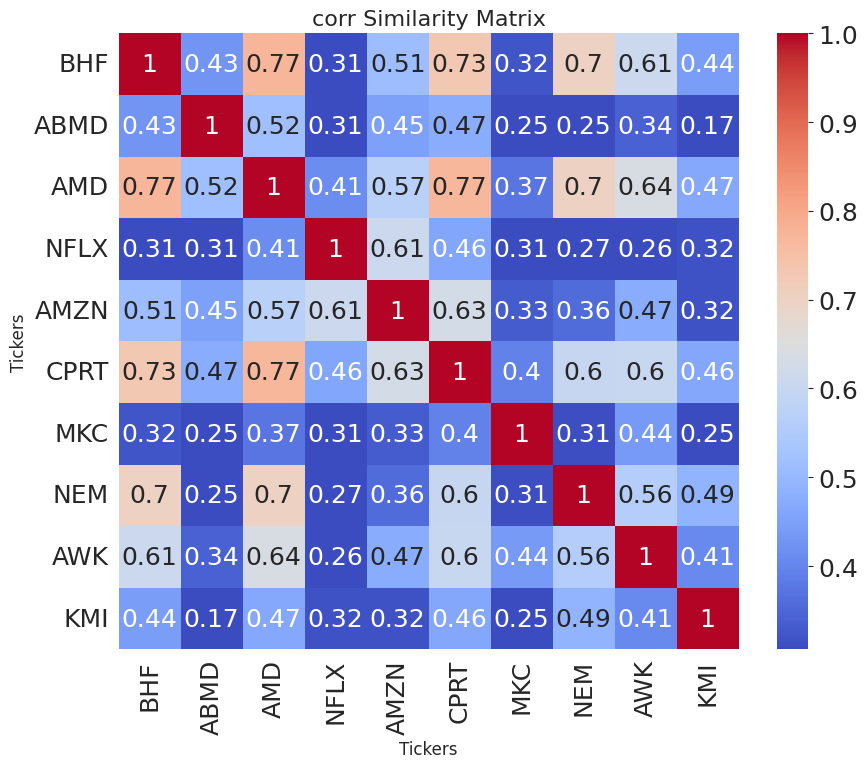

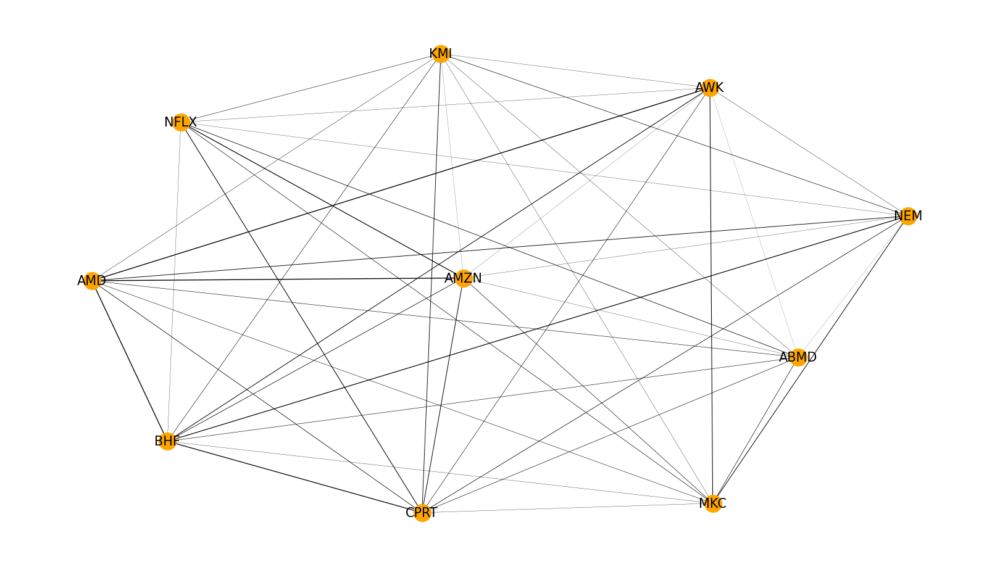

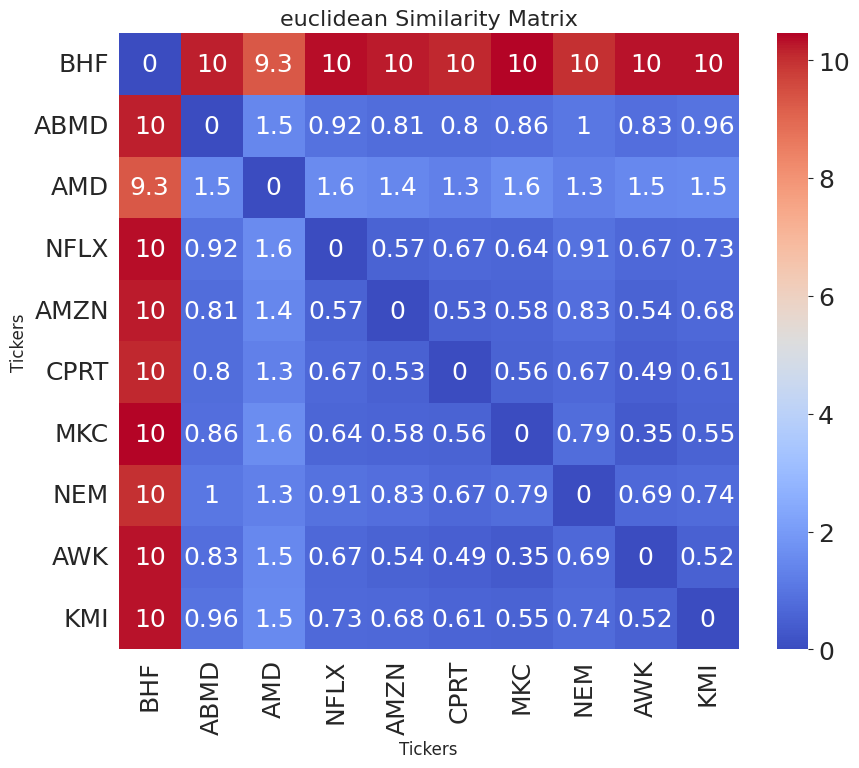

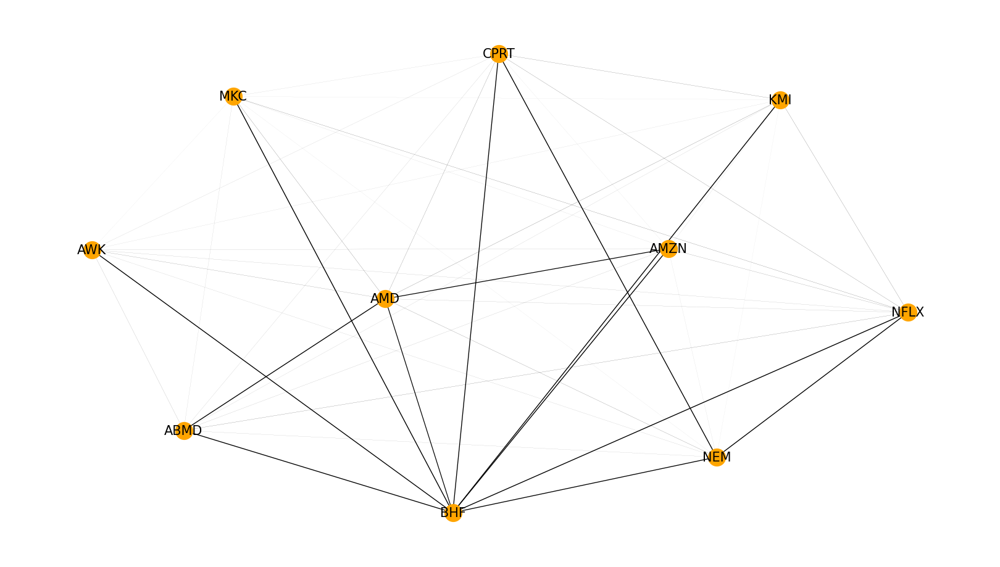

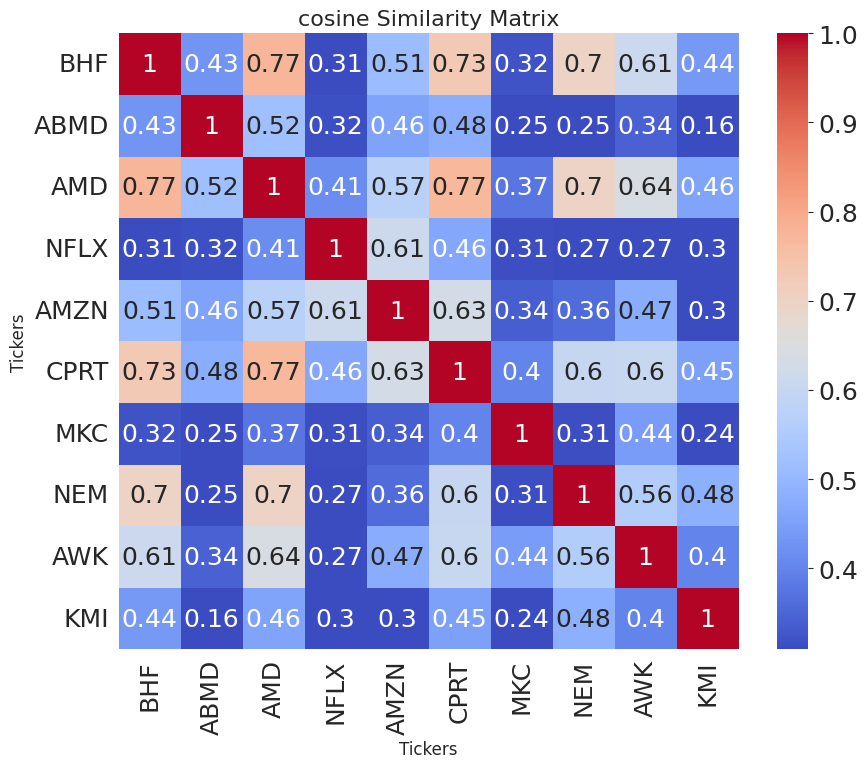

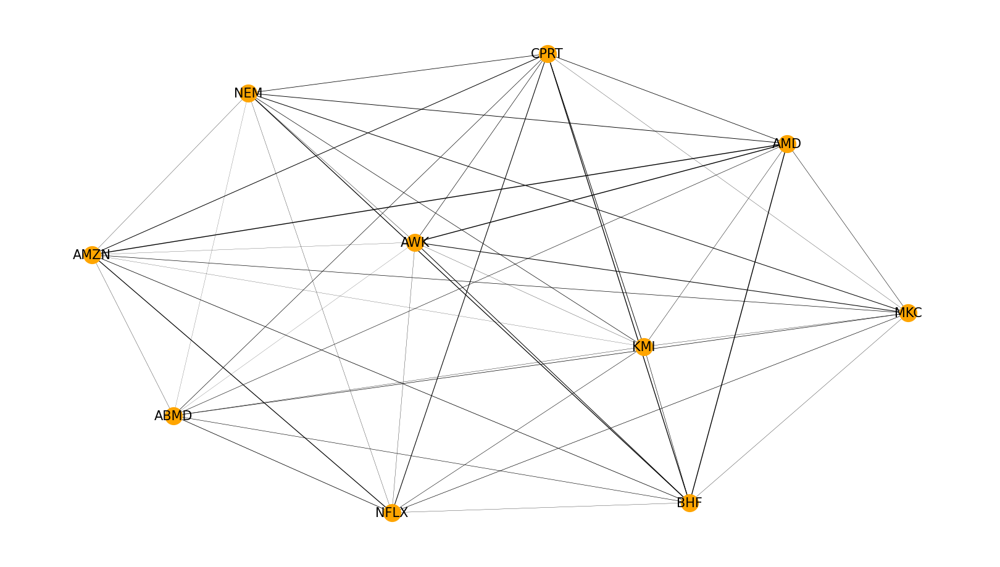

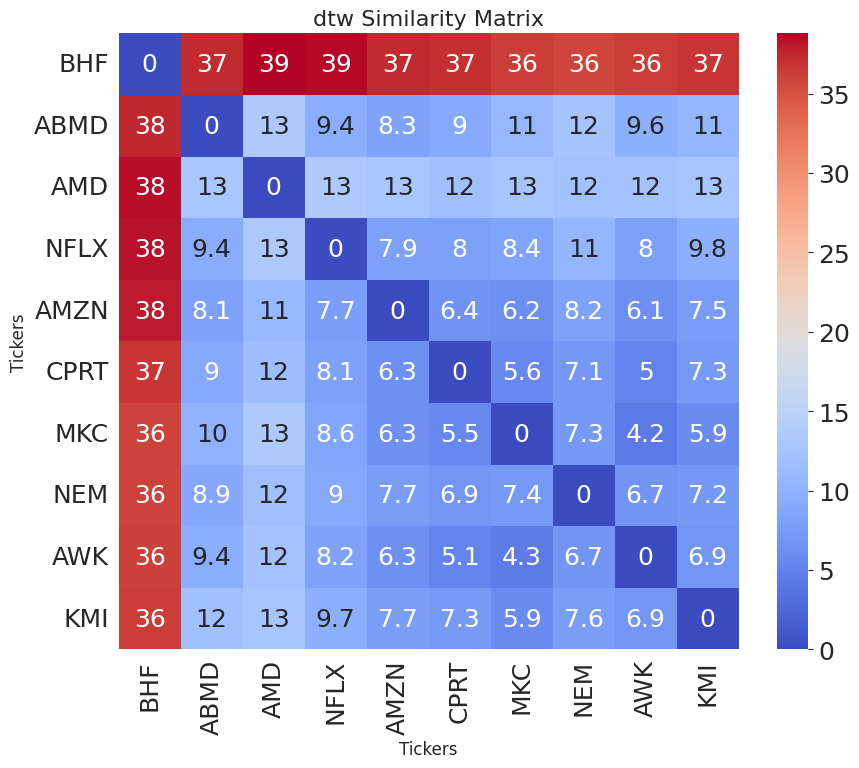

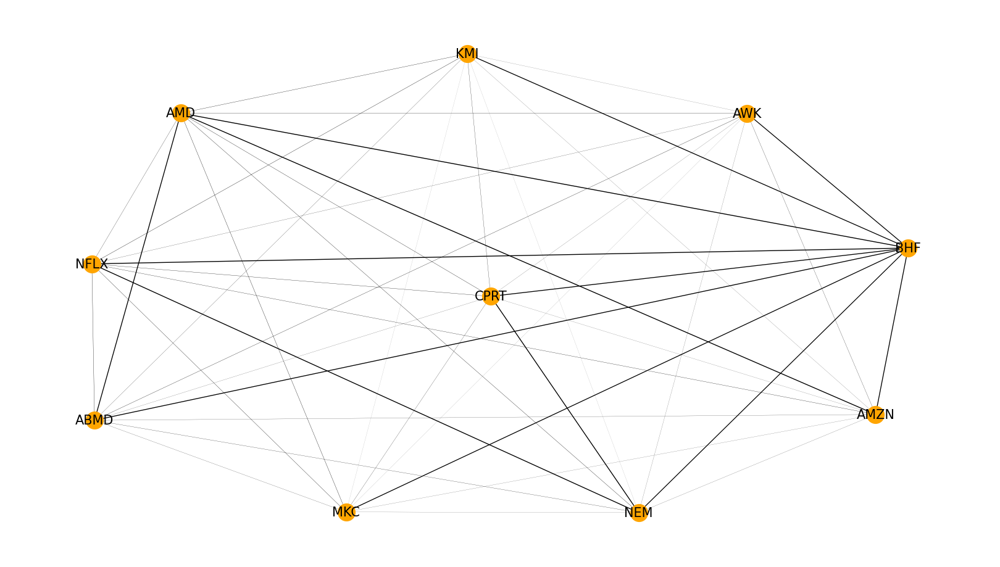

In [82]:
def create_sim_graph(df, measure='corr', plot=True, graph=True):

    if measure == 'corr':
      matrix = df.corr()
    elif measure == 'euclidean':
      matrix = timeseries_euclidean(df)
    elif measure == 'cosine':
      matrix = timeseries_cosine(df)
    elif measure == 'dtw':
      matrix = timeseries_dtw(df)

    matrix = matrix.astype(float)
    matrix = matrix.dropna()

    if plot:

      plt.figure(figsize=(10, 8))
      sns.heatmap(matrix, annot=True, cmap='coolwarm', vmin=matrix.iloc[0].min(), vmax=matrix.iloc[0].max())
      plt.title(measure+' Similarity Matrix', fontsize=16)
      plt.xlabel('Tickers', fontsize=12)
      plt.ylabel('Tickers', fontsize=12)
      plt.savefig(FIGURES_PATH+df.name+'_'+measure+'_heatmap.svg', bbox_inches='tight')
      plt.show()

    if graph:
      # Transform it in a links data frame (3 columns only):
      links = matrix.stack().reset_index()
      links.columns = ['var1', 'var2', 'value']

      # Keep only correlation over a threshold and remove self correlation (cor(A,A)=1)
      links_filtered=links.loc[(links['var1'] != links['var2'])]

      # Normalize the weights to the range [0, 1]
      min_weight = links_filtered['value'].min()
      max_weight = links_filtered['value'].max()
      links_filtered['normalized_value'] = (links_filtered['value'] - min_weight) / (max_weight - min_weight)
      
      # Build your graph
      G = nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')
  
      # Plot the network:
      nx.draw(G, with_labels=True, node_color='orange', node_size=400, edge_color='black', linewidths=1, font_size=15, width=links_filtered['normalized_value'])

      plt.savefig(FIGURES_PATH+df.name+'_'+measure+'_graph.svg', bbox_inches='tight')
    
    return G


measures = ['corr', 'euclidean', 'cosine', 'dtw']

for measure in measures:
  G = create_sim_graph(chosen_log_ret_df, measure=measure)

### **5.5**

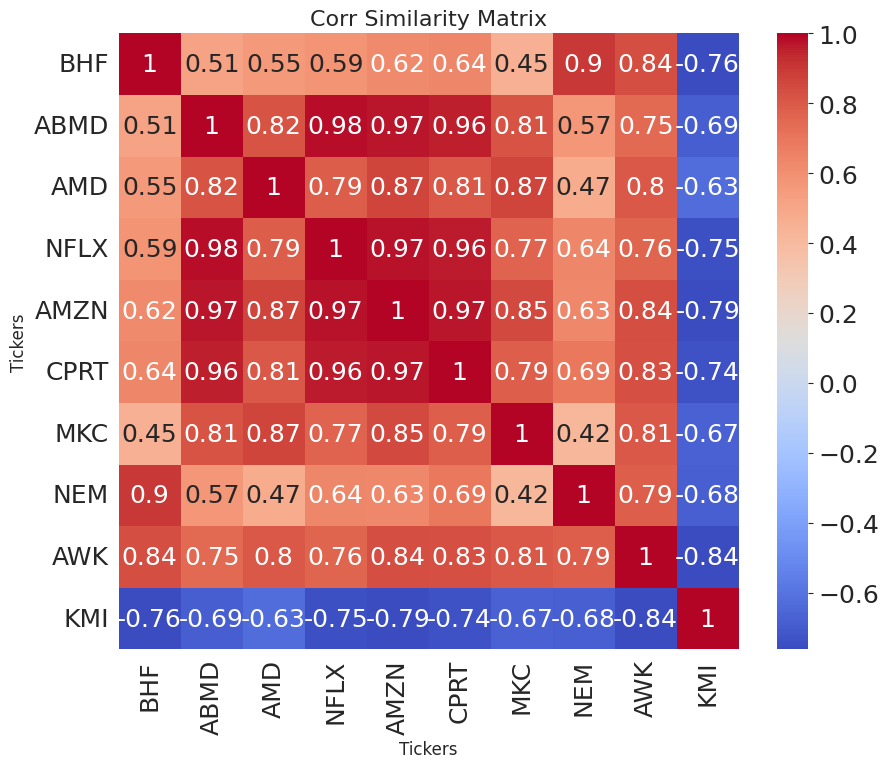

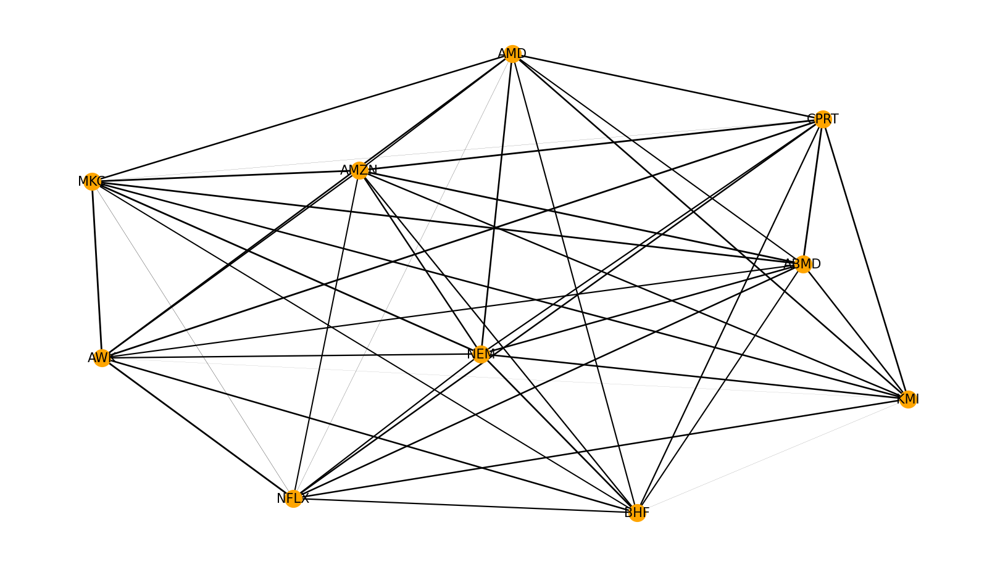

In [83]:
G = create_correlation_graph(chosen_stocks)

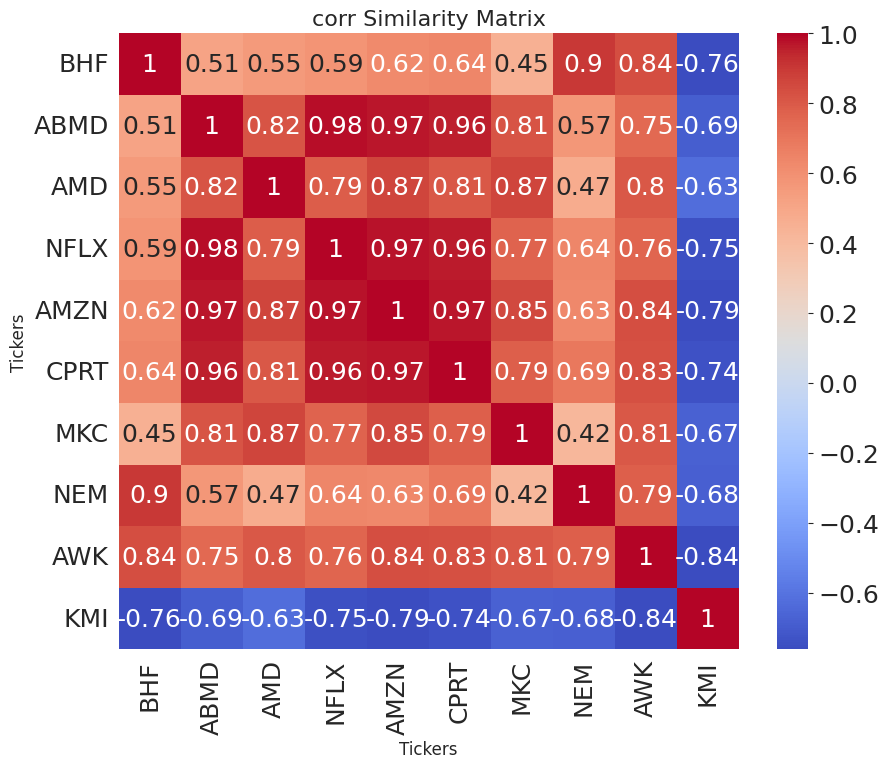

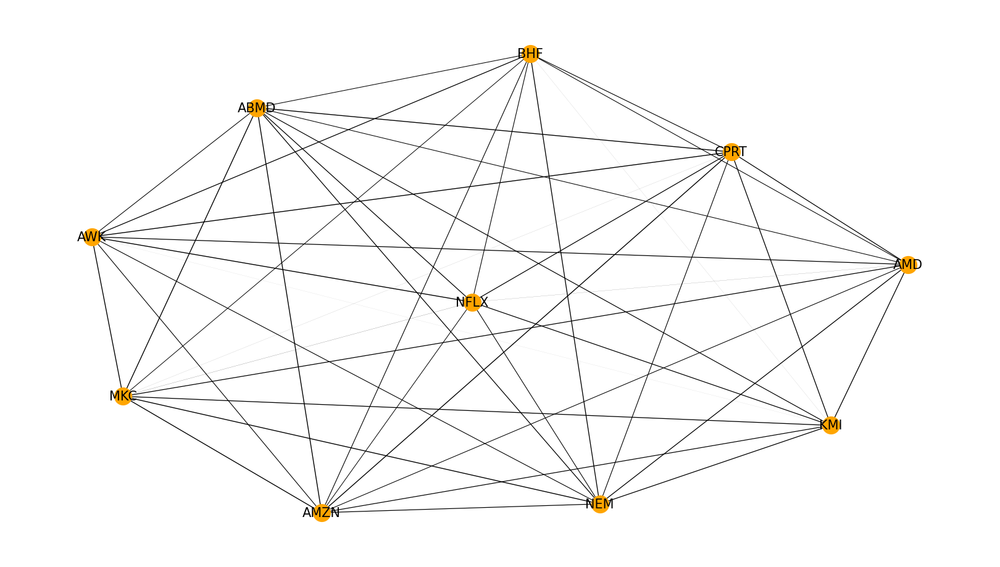

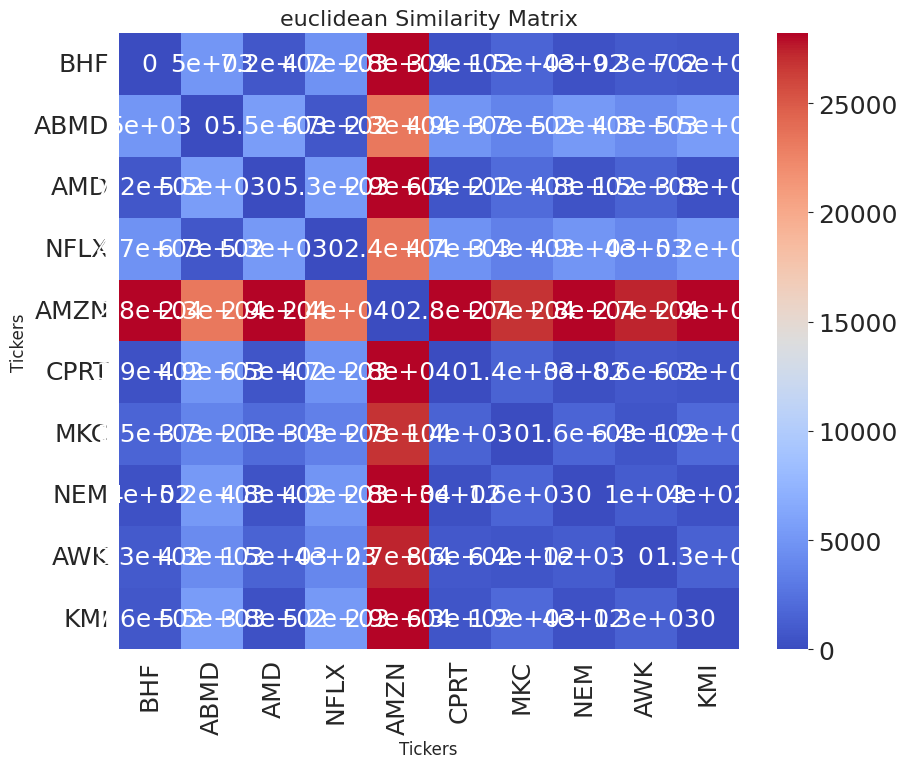

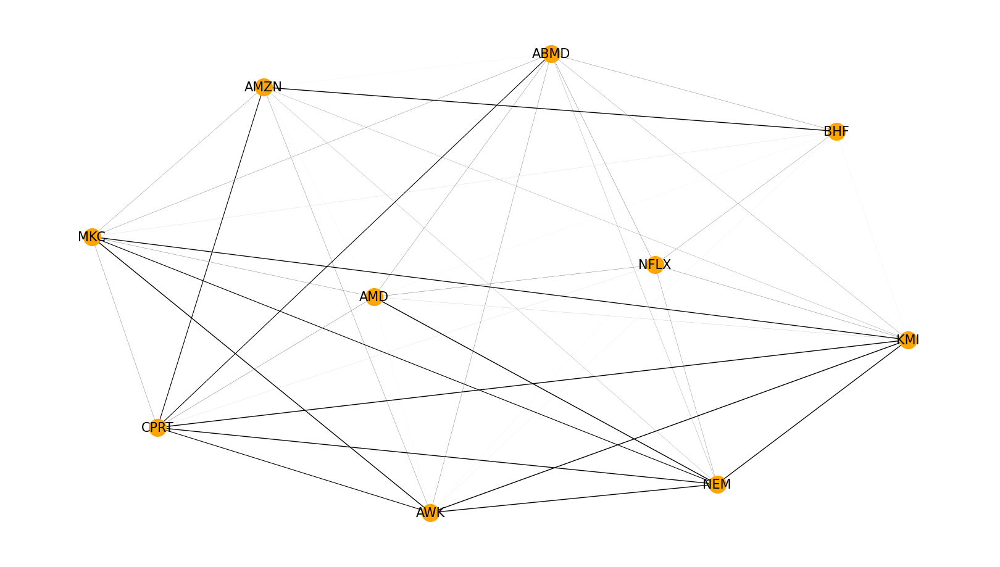

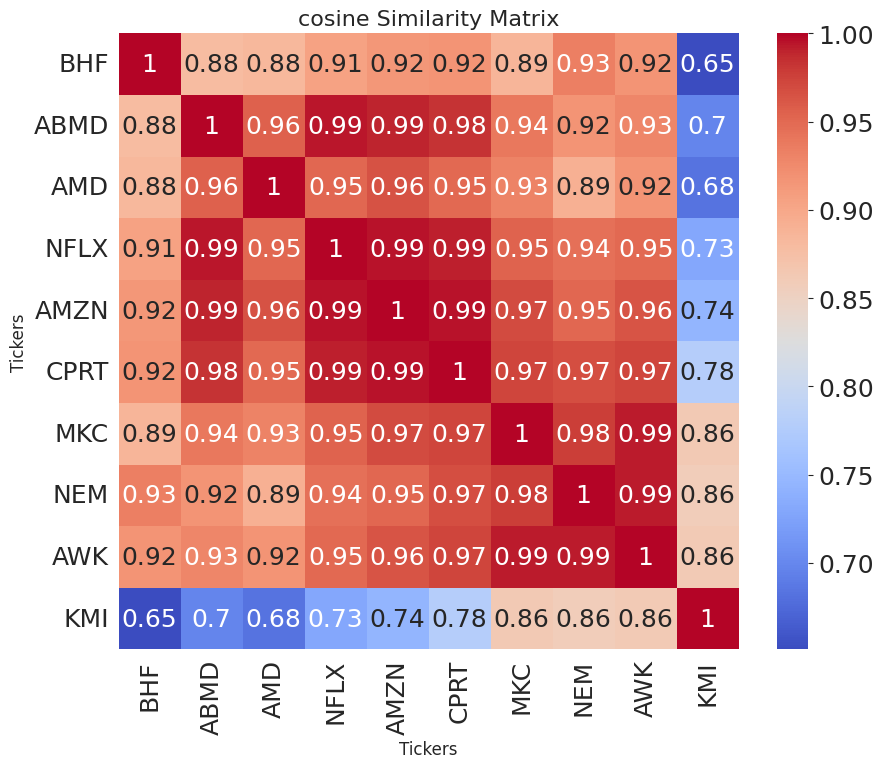

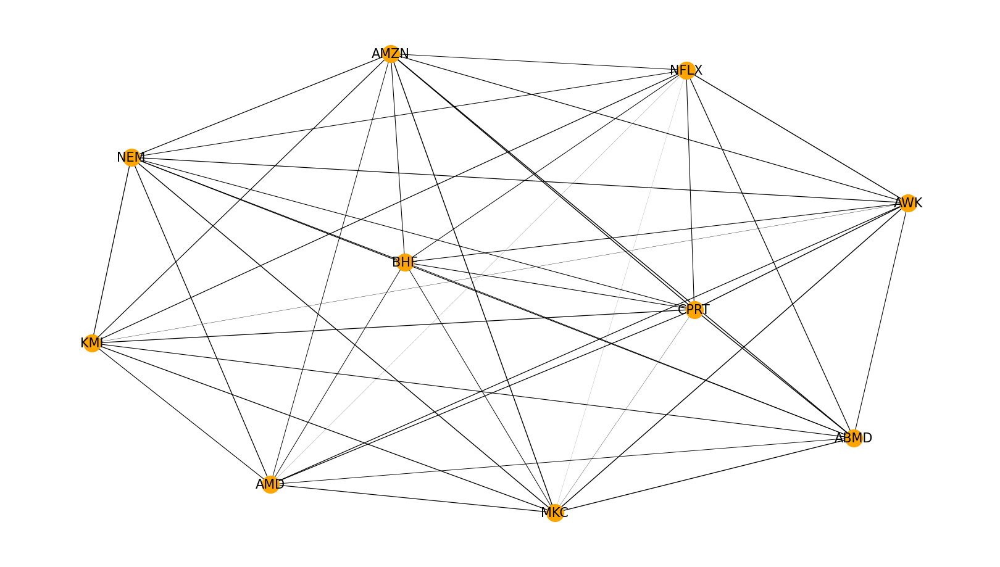

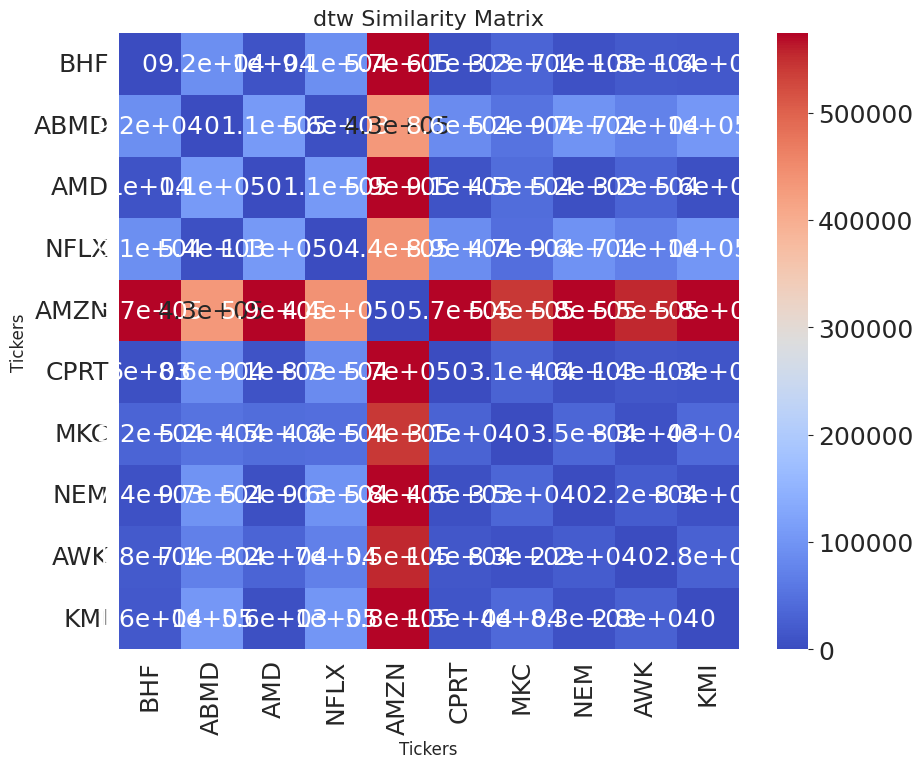

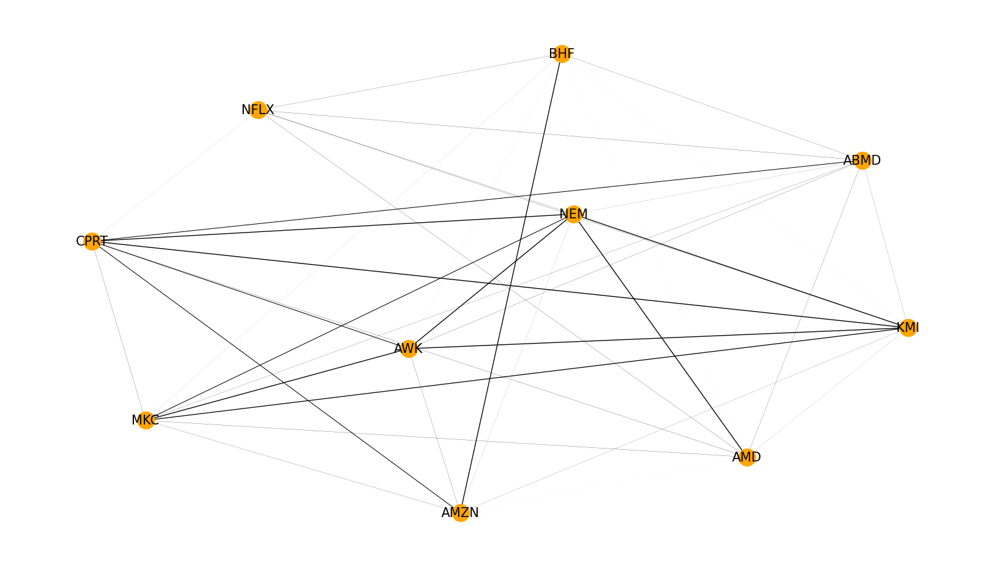

In [84]:
for measure in measures:
  G = create_sim_graph(chosen_stocks, measure=measure)